In [ ]:
! pip install unrar

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import json
import ast
import os
from google.colab import drive
%matplotlib inline
plt.style.use('ggplot')

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#! unzip '/content/drive/MyDrive/High Impact Journals.zip'
! unrar x '/content/drive/MyDrive/High Impact Journals.rar'


UNRAR 5.61 beta 1 freeware      Copyright (c) 1993-2018 Alexander Roshal


Extracting from /content/drive/MyDrive/High Impact Journals.rar


Would you like to replace the existing file High Impact Journals/high_impact_journals_affils.csv
420642728 bytes, modified on 2023-01-26 03:36
with a new one
420642728 bytes, modified on 2023-01-26 03:36

[Y]es, [N]o, [A]ll, n[E]ver, [R]ename, [Q]uit A

Extracting  High Impact Journals/high_impact_journals_affils.csv           2%  4%  6%  8%  OK 
Extracting  High Impact Journals/high_impact_journals_auths.csv           10% 12% 15% 17% 19% 20%  OK 
Extracting  High Impact Journals/high_impact_journals_pubs.csv            23% 25% 27% 29% 32% 34% 36% 39% 41% 43% 46% 48% 50% 52% 55% 57% 59% 62% 64% 66% 68% 71% 73% 74%  OK 
Extracting  High Impact Journals/high_impact_publications.feather         77

In [ ]:
df1=pd.read_csv('/content/High Impact Journals/high_impact_journals_pubs.csv',low_memory=True)

df2=pd.read_csv('/content/High Impact Journals/high_impact_journals_affils.csv',low_memory=True)

df3=pd.read_csv('/content/High Impact Journals/high_impact_journals_auths.csv',low_memory=True)

df4=pd.read_feather('/content/High Impact Journals/high_impact_publications.feather')

In [ ]:
df_lmic = pd.read_excel('/content/drive/MyDrive/lmics_list.xlsx')

In [ ]:
df1.describe()

,Unnamed: 0,authors_count,pmid,relative_citation_ratio,times_cited,volume,year,altmetric
count,162594.000000,162594.000000,1.238430e+05,83608.000000,162594.000000,157151.000000,162594.000000,108395.000000
mean,17596.509428,4.382124,2.639058e+07,4.629436,55.482183,330.017187,2014.223612,108.477854
std,11301.566959,48.336764,5.435877e+06,30.883317,327.071352,90.330816,4.552275,543.973801
min,0.000000,0.000000,1.719941e+07,0.010000,0.000000,1.000000,2007.000000,0.000000
25%,8129.000000,1.000000,2.189003e+07,0.120000,0.000000,327.000000,2010.000000,4.000000
50%,16259.000000,1.000000,2.610602e+07,0.410000,1.000000,353.000000,2014.000000,15.000000
75%,25971.000000,3.000000,3.101120e+07,2.590000,11.000000,375.000000,2018.000000,59.000000
max,43878.000000,7942.000000,3.668142e+07,3892.890000,46528.000000,2021.000000,2023.000000,44454.000000


In [ ]:
df1['authors_count'].replace(0,np.nan,inplace=True)

In [ ]:
df1.shape

(162594, 43)

In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162594 entries, 0 to 162593
Data columns (total 43 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Unnamed: 0                  162594 non-null  int64  
 1   id                          162594 non-null  object 
 2   title                       162594 non-null  object 
 3   authors                     150076 non-null  object 
 4   authors_count               150060 non-null  float64
 5   category_for                162594 non-null  object 
 6   concepts                    156626 non-null  object 
 7   concepts_scores             156626 non-null  object 
 8   date                        162594 non-null  object 
 9   issue                       128558 non-null  object 
 10  open_access                 162594 non-null  object 
 11  pages                       162089 non-null  object 
 12  pmid                        123843 non-null  float64
 13  relative_citat

In [ ]:
df1.isna().sum()

Unnamed: 0                         0
id                                 0
title                              0
authors                        12518
authors_count                  12534
category_for                       0
concepts                        5968
concepts_scores                 5968
date                               0
issue                          34036
open_access                        0
pages                            505
pmid                           38751
relative_citation_ratio        78986
researchers                    51189
times_cited                        0
type                               0
volume                          5443
year                               0
journal.id                         0
journal.title                      0
funder_countries              136579
funders                       136579
doi                             1183
research_org_cities            59454
research_org_countries         58529
research_org_country_names     58529
r

In [ ]:
df1.head(5)

,Unnamed: 0,id,title,authors,authors_count,category_for,concepts,concepts_scores,date,issue,...,category_bra,category_hrcs_hc,category_icrp_ct,pmcid,category_hra,category_rcdc,category_sdg,category_uoa,category_hrcs_rac,category_icrp_cso
0,0,pub.1078030959,Maternal and neonatal herpes simplex virus inf...,"[{'affiliations': [], 'corresponding': '', 'cu...",1.0,"[{'id': '80003', 'name': '32 Biomedical and Cl...","['neonatal herpes simplex virus infection', 'h...",[{'concept': 'neonatal herpes simplex virus in...,2009-12-31,27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,pub.1078030958,Sex hormone-binding globulin and risk of type ...,"[{'affiliations': [], 'corresponding': '', 'cu...",1.0,"[{'id': '80003', 'name': '32 Biomedical and Cl...","['hormone-binding globulin', 'type 2 diabetes'...","[{'concept': 'hormone-binding globulin', 'rele...",2009-12-31,27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,pub.1078030957,Sex hormone-binding globulin and risk of type ...,"[{'affiliations': [], 'corresponding': '', 'cu...",3.0,"[{'id': '80003', 'name': '32 Biomedical and Cl...","['hormone-binding globulin', 'type 2 diabetes'...","[{'concept': 'hormone-binding globulin', 'rele...",2009-12-31,27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,pub.1078030956,Dabigatran versus warfarin in patients with at...,"[{'affiliations': [], 'corresponding': '', 'cu...",3.0,"[{'id': '80003', 'name': '32 Biomedical and Cl...","['atrial fibrillation', 'dabigatran', 'warfari...","[{'concept': 'atrial fibrillation', 'relevance...",2009-12-31,27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,pub.1078030955,Dabigatran versus warfarin in patients with at...,"[{'affiliations': [], 'corresponding': '', 'cu...",1.0,"[{'id': '80003', 'name': '32 Biomedical and Cl...","['atrial fibrillation', 'dabigatran', 'warfari...","[{'concept': 'atrial fibrillation', 'relevance...",2009-12-31,27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df4.shape

(712911, 14)

In [ ]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 712911 entries, 0 to 712910
Data columns (total 14 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   index                    712911 non-null  int64  
 1   Unnamed: 0               712911 non-null  int64  
 2   affiliations             712911 non-null  object 
 3   corresponding            43100 non-null   object 
 4   current_organization_id  442217 non-null  object 
 5   first_name               712099 non-null  object 
 6   last_name                712505 non-null  object 
 7   orcid                    445116 non-null  object 
 8   raw_affiliation          712911 non-null  object 
 9   researcher_id            494550 non-null  object 
 10  pub_id                   712911 non-null  object 
 11  year                     712911 non-null  int64  
 12  gender                   645191 non-null  object 
 13  gender_ints              645191 non-null  float64
dtypes: f

In [ ]:
df4.describe()

,index,Unnamed: 0,year,gender_ints
count,712911.000000,712911.000000,712911.000000,645191.000000
mean,356455.000000,75943.226821,2016.338077,0.635244
std,205799.823217,47343.028669,4.558411,0.481362
min,0.000000,0.000000,2007.000000,0.000000
25%,178227.500000,35645.000000,2013.000000,0.000000
50%,356455.000000,71291.000000,2017.000000,1.000000
75%,534682.500000,114024.000000,2020.000000,1.000000
max,712910.000000,176111.000000,2023.000000,1.000000


In [ ]:
df4.isna().sum()

index                           0
Unnamed: 0                      0
affiliations                    0
corresponding              669811
current_organization_id    270694
first_name                    812
last_name                     406
orcid                      267795
raw_affiliation                 0
researcher_id              218361
pub_id                          0
year                            0
gender                      67720
gender_ints                 67720
dtype: int64

In [ ]:
df4.head(5)

,index,Unnamed: 0,affiliations,corresponding,current_organization_id,first_name,last_name,orcid,raw_affiliation,researcher_id,pub_id,year,gender,gender_ints
0,0,0,[],None,None,David Louis,Keller,['0000-0001-7112-2337'],[],ur.01272162245.77,pub.1078030959,2009,male,1.0
1,1,1,[],None,None,John E,Nestler,[],[],None,pub.1078030958,2009,male,1.0
2,2,2,[],None,grid.4305.2,Robert,Semple,['0000-0001-6539-3069'],[],ur.01167062360.32,pub.1078030957,2009,male,1.0
3,3,3,[],None,grid.5335.0,David B,Savage,['0000-0002-7857-7032'],[],ur.0607043561.67,pub.1078030957,2009,male,1.0
4,4,4,[],None,grid.5335.0,Steven,O'Rahilly,['0000-0003-2199-4449'],[],ur.07711435224.39,pub.1078030957,2009,male,1.0


#preprocessing1

In [ ]:
df4['gender_ints'].replace({1.0:0.0,0.0:1.0},inplace=True)

In [ ]:
df4.rename(columns={'pub_id':'id'},inplace=True)

In [ ]:
df4.dropna(axis=0,how='all',subset=['first_name','last_name'],inplace=True)

In [ ]:
df1['journal.title'].replace({'The BMJ':'BMJ','The Lancet':'Lancet',
                              'New England Journal of Medicine':'NEJM',
                              'Nature Medicine':'Nature','PLOS Medicine':'PLOS'},inplace=True)

In [ ]:
df1.set_index('id',inplace=True)

In [ ]:
df1.loc[df4['id'].unique(),'female_first_real'] = df4.drop_duplicates(subset='id',keep='first')['gender_ints'].values
df1.loc[df4['id'].unique(),'female_first_pessimistic'] = df4.fillna(0.0).drop_duplicates(subset='id',keep='first')['gender_ints'].values
df1.loc[df4['id'].unique(),'female_first_optimistic'] = df4.fillna(1.0).drop_duplicates(subset='id',keep='first')['gender_ints'].values

df1.loc[df4['id'].unique(),'female_last_real'] = df4.drop_duplicates(subset='id',keep='last')['gender_ints'].values
df1.loc[df4['id'].unique(),'female_last_pessimistic'] = df4.fillna(0.0).drop_duplicates(subset='id',keep='last')['gender_ints'].values
df1.loc[df4['id'].unique(),'female_last_optimistic'] = df4.fillna(1.0).drop_duplicates(subset='id',keep='last')['gender_ints'].values

df1.loc[np.unique(df4['id'].values),'pct_female_real'] = df4.groupby('id')['gender_ints'].mean().values
df1.loc[np.unique(df4['id'].values),'pct_female_optimistic'] = df4.fillna(1.0).groupby('id')['gender_ints'].mean().values
df1.loc[np.unique(df4['id'].values),'pct_female_pessimistic'] = df4.fillna(0.0).groupby('id')['gender_ints'].mean().values

In [ ]:
df1.isna().sum()

Unnamed: 0                         0
title                              0
authors                        12518
authors_count                  12534
category_for                       0
concepts                        5968
concepts_scores                 5968
date                               0
issue                          34036
open_access                        0
pages                            505
pmid                           38751
relative_citation_ratio        78986
researchers                    51189
times_cited                        0
type                               0
volume                          5443
year                               0
journal.id                         0
journal.title                      0
funder_countries              136579
funders                       136579
doi                             1183
research_org_cities            59454
research_org_countries         58529
research_org_country_names     58529
research_org_names             53958
r

In [ ]:
df1[df1['pct_female_optimistic'].isna()==True].index # articles of which all authors are missing ~ 12534

Index(['pub.1024604623', 'pub.1062804342', 'pub.1062804335', 'pub.1005050248',
       'pub.1062804330', 'pub.1039688810', 'pub.1025172887', 'pub.1006185913',
       'pub.1065270500', 'pub.1062804366',
       ...
       'pub.1134452476', 'pub.1134447507', 'pub.1134426080', 'pub.1134413261',
       'pub.1134393200', 'pub.1134294120', 'pub.1134293879', 'pub.1134290065',
       'pub.1134289768', 'pub.1134444302'],
      dtype='object', name='id', length=12534)

In [ ]:
df1.loc['pub.1024604623',:] #compelete authors of this article are missing

Unnamed: 0                                                                   41
title                                                  This Week in the Journal
authors                                                                     NaN
authors_count                                                               NaN
category_for                  [{'id': '80003', 'name': '32 Biomedical and Cl...
concepts                                                  ['weeks', 'journals']
concepts_scores               [{'concept': 'weeks', 'relevance': 0.108}, {'c...
date                                                                 2009-12-31
issue                                                                        27
open_access                                                          ['closed']
pages                                                                 2598-2598
pmid                                                                        NaN
relative_citation_ratio                 

In [ ]:
df1.reset_index(inplace=True)

In [ ]:
df2.shape

(659789, 14)

In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 659789 entries, 0 to 659788
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Unnamed: 0           659789 non-null  int64  
 1   aff_city             595992 non-null  object 
 2   aff_city_id          595990 non-null  float64
 3   aff_country          611482 non-null  object 
 4   aff_country_code     611443 non-null  object 
 5   aff_id               534628 non-null  object 
 6   aff_name             659788 non-null  object 
 7   aff_raw_affiliation  659788 non-null  object 
 8   aff_state            303017 non-null  object 
 9   aff_state_code       257311 non-null  object 
 10  pub_id               659789 non-null  object 
 11  researcher_id        536594 non-null  object 
 12  first_name           659447 non-null  object 
 13  last_name            659700 non-null  object 
dtypes: float64(1), int64(1), object(12)
memory usage: 70.5+ MB


In [ ]:
df2.isna().sum()

Unnamed: 0                  0
aff_city                63797
aff_city_id             63799
aff_country             48307
aff_country_code        48346
aff_id                 125161
aff_name                    1
aff_raw_affiliation         1
aff_state              356772
aff_state_code         402478
pub_id                      0
researcher_id          123195
first_name                342
last_name                  89
dtype: int64

In [ ]:
df2.head(10)

,Unnamed: 0,aff_city,aff_city_id,aff_country,aff_country_code,aff_id,aff_name,aff_raw_affiliation,aff_state,aff_state_code,pub_id,researcher_id,first_name,last_name
0,0,Hong Kong,1819729.0,China,CN,NaN,Hong Kong,Hong Kong,Central and Western,NaN,pub.1062804433,NaN,Jane,Parry
1,1,Geneve,2660646.0,Switzerland,CH,NaN,Geneva,Geneva,Geneva,NaN,pub.1062804432,ur.0753300600.29,John,Zarocostas
2,2,Abergavenny,2657815.0,United Kingdom,GB,NaN,Abergavenny,Abergavenny,Wales,NaN,pub.1062804424,ur.010072763211.79,Roger,Dobson
3,3,London,2643743.0,United Kingdom,GB,NaN,London,London,England,NaN,pub.1062804423,ur.01261306147.08,Peter,Moszynski
4,4,NaN,NaN,NaN,NaN,NaN,"Maidstone, Kent ME17","Maidstone, Kent ME17",NaN,NaN,pub.1062804414,NaN,Jerry R,Whitmarsh
5,5,Buffalo,5110629.0,United States,US,grid.273335.3,"University at Buffalo, State University of New...",State University of New York at Buffalo,New York,US-NY,pub.1062804413,NaN,John H,Noble
6,6,Montreal,6077243.0,Canada,CA,NaN,"St Justine Hospital, Montreal, QC, Canada H3T 1C5","St Justine Hospital, Montreal, QC, Canada H3T 1C5",Quebec,CA-QC,pub.1062804412,NaN,Keith J,Barrington
7,7,Dunedin,2191562.0,New Zealand,NZ,grid.29980.3a,University of Otago,"Intensive Medicines Monitoring Programme, NZ P...",NaN,NaN,pub.1062804411,ur.0747253647.94,Mira,Harrison-Woolrych
8,8,Birmingham,2655603.0,United Kingdom,GB,grid.6572.6,University of Birmingham,"University of Birmingham, Birmingham",NaN,NaN,pub.1062804409,ur.013266444002.08,Graham F,Cope
9,9,NaN,NaN,NaN,NaN,NaN,"Royal Victoria Infirmary, Newcastle on Tyne NE...","Royal Victoria Infirmary, Newcastle on Tyne NE...",NaN,NaN,pub.1062804406,ur.01110527150.75,Richard,Quinton


In [ ]:
df3.shape

(712911, 10)

In [ ]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 712911 entries, 0 to 712910
Data columns (total 10 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   Unnamed: 0               712911 non-null  int64 
 1   affiliations             712911 non-null  object
 2   corresponding            43100 non-null   object
 3   current_organization_id  442217 non-null  object
 4   first_name               712099 non-null  object
 5   last_name                712505 non-null  object
 6   orcid                    445116 non-null  object
 7   raw_affiliation          712911 non-null  object
 8   researcher_id            494550 non-null  object
 9   pub_id                   712911 non-null  object
dtypes: int64(1), object(9)
memory usage: 54.4+ MB


In [ ]:
df3.describe()

,Unnamed: 0
count,712911.000000
mean,75943.226821
std,47343.028669
min,0.000000
25%,35645.000000
50%,71291.000000
75%,114024.000000
max,176111.000000


In [ ]:
df3.isna().sum()

Unnamed: 0                      0
affiliations                    0
corresponding              669811
current_organization_id    270694
first_name                    812
last_name                     406
orcid                      267795
raw_affiliation                 0
researcher_id              218361
pub_id                          0
dtype: int64

In [ ]:
df3.head(10)

,Unnamed: 0,affiliations,corresponding,current_organization_id,first_name,last_name,orcid,raw_affiliation,researcher_id,pub_id
0,0,[],NaN,NaN,David Louis,Keller,['0000-0001-7112-2337'],[],ur.01272162245.77,pub.1078030959
1,1,[],NaN,NaN,John E,Nestler,[],[],NaN,pub.1078030958
2,2,[],NaN,grid.4305.2,Robert,Semple,['0000-0001-6539-3069'],[],ur.01167062360.32,pub.1078030957
3,3,[],NaN,grid.5335.0,David B,Savage,['0000-0002-7857-7032'],[],ur.0607043561.67,pub.1078030957
4,4,[],NaN,grid.5335.0,Steven,O'Rahilly,['0000-0003-2199-4449'],[],ur.07711435224.39,pub.1078030957
5,5,[],NaN,grid.5379.8,Leon,Poller,NaN,[],ur.01320053571.14,pub.1078030956
6,6,[],NaN,grid.10825.3e,Joergen,Jespersen,['0000-0002-3059-2356'],[],ur.0722342545.82,pub.1078030956
7,7,[],NaN,grid.5379.8,Saied,Ibrahim,['0000-0002-2657-8834'],[],ur.0757011271.32,pub.1078030956
8,8,[],NaN,NaN,Michael,Barry,[],[],NaN,pub.1078030955
9,9,[],NaN,NaN,Marco,Moia,[],[],NaN,pub.1078030954


In [ ]:
df_lmic

,Country,Classification
0,Afghanistan,Low income
1,Albania,Upper middle income
2,Algeria,Upper middle income
3,American Samoa,Upper middle income
4,Angola,Upper middle income
...,...,...
130,Vietnam,Lower middle income
131,West Bank and Gaza,Lower middle income
132,"Yemen, Rep.",Lower middle income
133,Zambia,Lower middle income


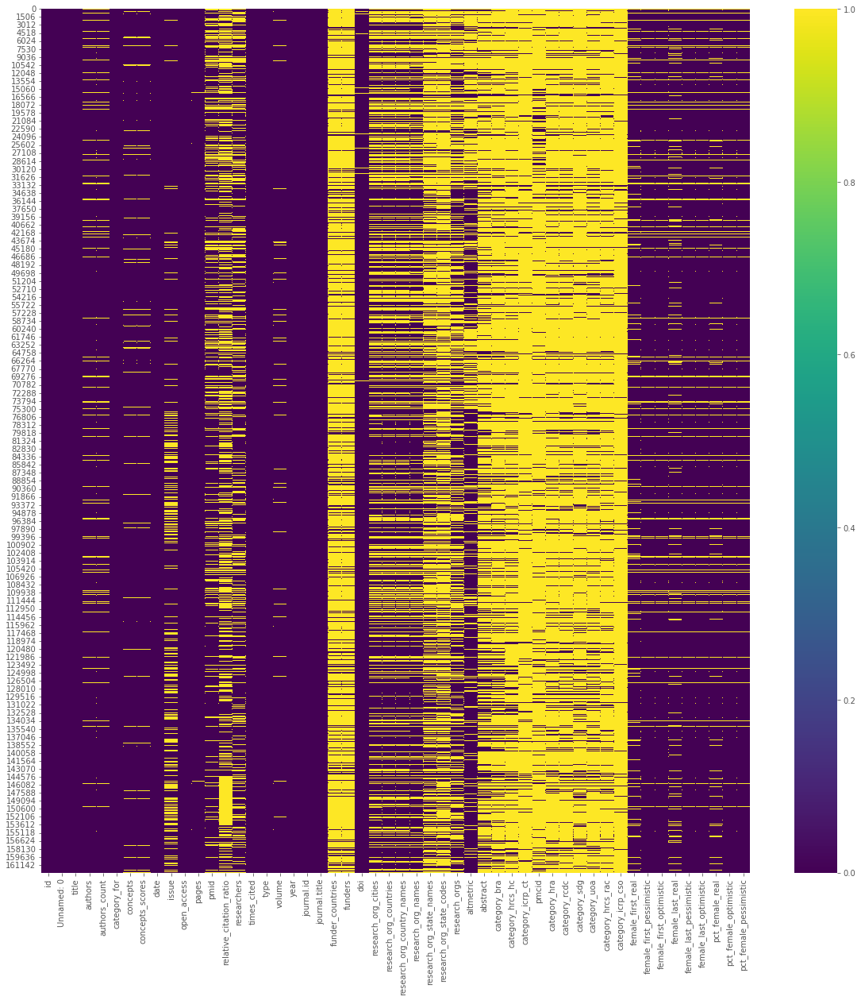

In [ ]:
plt.figure(figsize=(20,20))

sns.heatmap(df1.isna(),cmap='viridis')

In [ ]:
df1.loc[(df1['authors'].isna() & df1['female_first_real'].isna()
 & df1['female_first_pessimistic'].isna() & df1['female_first_optimistic'].isna() 
 & df1['female_last_optimistic'].isna() & df1['female_last_real'].isna() 
 & df1['female_last_pessimistic'].isna() & df1['pct_female_real'].isna() & 
 df1['pct_female_optimistic'].isna() & df1['pct_female_pessimistic'].isna()),'year'].describe()

count    12518.000000
mean      2013.303803
std          4.545331
min       2007.000000
25%       2009.000000
50%       2013.000000
75%       2017.000000
max       2023.000000
Name: year, dtype: float64

In [ ]:
df1.dropna(axis=0,how='all',subset=['authors','female_first_real','female_first_pessimistic',
                                    'female_first_optimistic','female_last_optimistic',
                                    'female_last_real','female_last_pessimistic','pct_female_real',
                                    'pct_female_optimistic','pct_female_pessimistic'],inplace=True)

In [ ]:
#df1.dropna(axis=0,subset=['authors_count'],inplace=True) #authors lastname and firstname+ affilations are missing

In [ ]:
df1.isna().sum()

id                                 0
Unnamed: 0                         0
title                              0
authors                            0
authors_count                     16
category_for                       0
concepts                        4868
concepts_scores                 4868
date                               0
issue                          31788
open_access                        0
pages                            372
pmid                           29976
relative_citation_ratio        67338
researchers                    38671
times_cited                        0
type                               0
volume                          4729
year                               0
journal.id                         0
journal.title                      0
funder_countries              124143
funders                       124143
doi                             1173
research_org_cities            46936
research_org_countries         46011
research_org_country_names     46011
r

16 articles id aren't recorded in df4

these articles have missing value at authors_count

In [ ]:
df1.shape

(150076, 52)

In [ ]:
df1.loc[df1['authors_count']>=6,'author_count_categories']='6+'
df1.loc[df1['authors_count']==1,'author_count_categories']='1'
df1.loc[df1['authors_count']==2,'author_count_categories']='2'
df1.loc[(df1['authors_count']>=3) & (df1['authors_count']<=5),'author_count_categories']='3-5'

#Number of articles per year by journals

In [ ]:
s0=df1.groupby('year')['journal.title'].value_counts().to_frame()
s0.rename(columns={'journal.title':'counts'},inplace=True)
s0

counts
year journal.title        
2007 BMJ              3692
     Lancet           1782
     NEJM             1648
     JAMA             1586
     Nature            400
...                    ...
2023 JAMA              137
     NEJM               73
     Lancet             59
     Nature             39
     PLOS               16

[102 rows x 1 columns]

In [ ]:
s0_piv=s0.pivot_table(index='year',columns='journal.title',values='counts')
s0_piv

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
year,,,,,,
2007,3692,1586,1782,1648,400,346
2008,3795,1657,1774,1584,355,250
2009,3963,1689,1763,1543,417,201
2010,4086,1648,1802,1390,482,197
2011,4434,1614,1793,1401,562,211
2012,4577,1608,1959,1316,510,217
2013,4443,1497,2245,1565,443,224
2014,4351,1529,1996,1552,372,194
2015,4326,1546,2097,1511,277,154


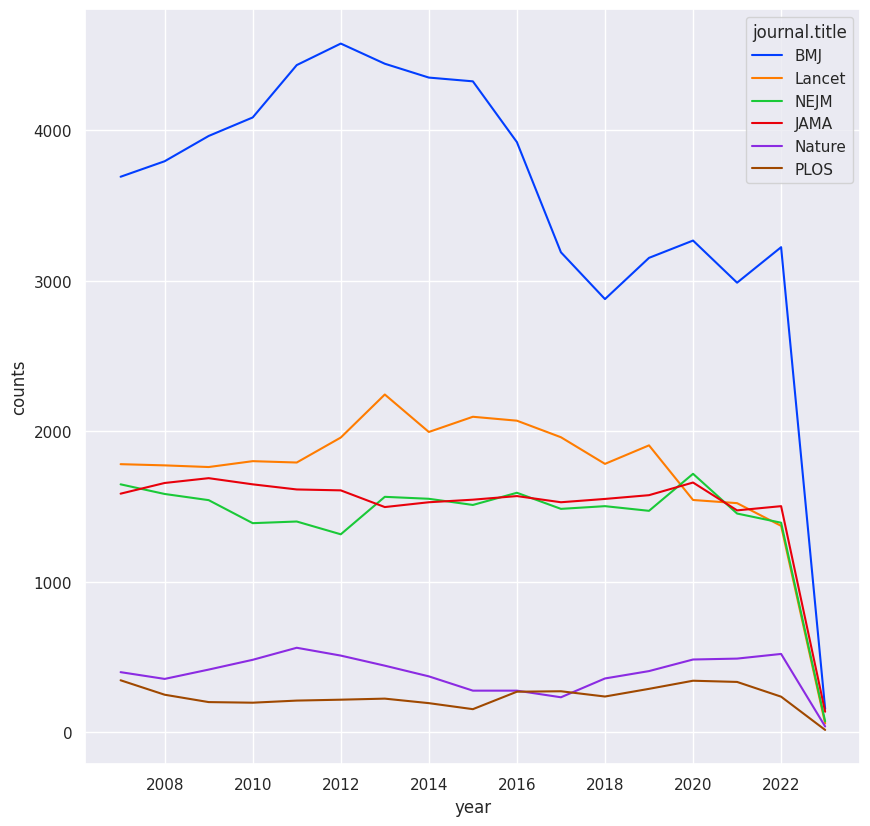

In [ ]:
plt.figure(figsize=(10,10),dpi=100)
sns.set(font_scale=2)
sns.set_theme()
sns.lineplot(data=s0.reset_index(),x='year',y='counts',palette='bright',hue='journal.title')

#pct_female by journal and year

In [ ]:
s=df1.groupby(['journal.title','year'])[['pct_female_pessimistic','pct_female_real','pct_female_optimistic']].median()
s=s*100
s

pct_female_pessimistic  pct_female_real  \
journal.title year                                            
BMJ           2007                0.000000         0.000000   
              2008                0.000000         0.000000   
              2009                0.000000         0.000000   
              2010                0.000000         0.000000   
              2011                0.000000         0.000000   
...                                    ...              ...   
PLOS          2019               37.500000        42.857143   
              2020               36.585366        40.000000   
              2021               37.500000        42.857143   
              2022               41.666667        50.000000   
              2023               44.155844        50.000000   

                    pct_female_optimistic  
journal.title year                         
BMJ           2007               0.000000  
              2008               0.000000  
              2009               0.000000  
              2010               0.000000  
              2011              25.000000  
...                                   ...  
PLOS          2019              50.000000  
              2020              50.000000  
              2021              50.000000  
              2022              52.941176  
              2023              51.315789  

[102 rows x 3 columns]

In [ ]:
s_fem=s.pivot_table(index='year',columns='journal.title',values='pct_female_real')
s_fem

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
year,,,,,,
2007,0.000000,11.111111,0.000000,0.000000,29.705882,20.000000
2008,0.000000,0.000000,0.000000,0.000000,27.525253,26.666667
2009,0.000000,0.000000,0.000000,0.000000,29.411765,25.000000
2010,0.000000,0.000000,0.000000,0.000000,18.181818,33.333333
2011,0.000000,15.789474,0.000000,0.000000,32.000000,28.571429
2012,11.111111,20.000000,0.000000,0.000000,33.333333,33.333333
2013,0.000000,26.666667,10.000000,0.000000,30.769231,33.333333
2014,20.000000,33.333333,9.545455,9.761905,35.294118,37.500000
2015,33.333333,33.333333,16.666667,12.771739,33.333333,31.498016


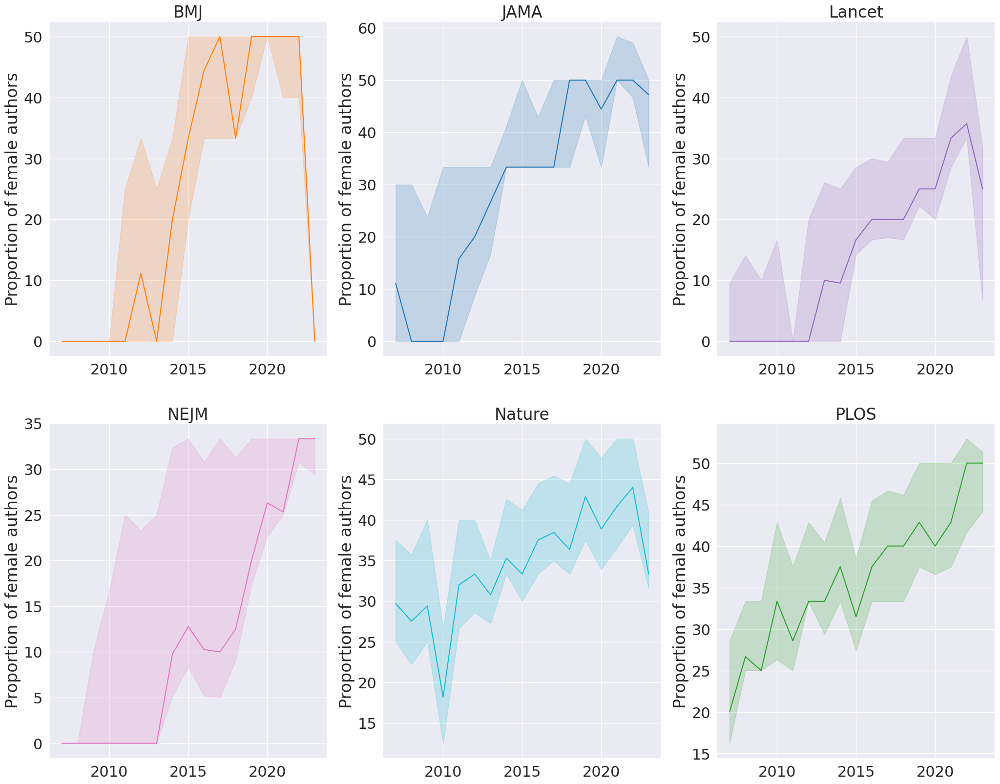

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,20),dpi=100)


colors=np.random.choice(list(mcolors.TABLEAU_COLORS),7,replace=False)

for i,j in enumerate(np.split(s,6,axis=0),start=1):
  plt.subplot(2,3,i)
  plt.plot(j.reset_index()['year'].values,j['pct_female_real'].values,color=colors[i])
  plt.fill_between(j.reset_index()['year'].values,y1=j['pct_female_pessimistic'].values,y2=j['pct_female_optimistic'].values,alpha=0.2,color=colors[i])
  plt.title(j.index[1][0])
  plt.ylabel('Proportion of female authors')

Comment from Marie: why does the time series stop in 2019? The pandemic might have changed the dynamics of gender diversity in authorship, so capturing 2020, 2021, and 2022 may be important.

Quick formatting comment: I would multiply by 100 and name the y-axis "Proportion of female authors". Are you representing the average or median only? Would it be worth adding 95% confidence bands around the value?

Before representing this graph, I would include a line plot with the number of papers by year and by journal (same type of graph but the y-axis will be the "Number of publications").

In [ ]:
#sns.set(font_scale=4)
#F= sns.FacetGrid(data=df1, col='year', row='journal.title',sharey=False,height=10,aspect=1.9)
#F.map(plt.hist,'pct_female_real')

In [ ]:
df1.loc[df1['authors_count']==0,'id']

Series([], Name: id, dtype: object)

# number of articles per year by journal and authors_count

In [ ]:
s2=df1.groupby(['author_count_categories','journal.title'])['year'].value_counts().to_frame()
s2.columns=['values']
s2

values
author_count_categories journal.title year        
1                       BMJ           2012    3407
                                      2013    3400
                                      2011    3328
                                      2015    3310
                                      2014    3285
...                                            ...
6+                      PLOS          2012      97
                                      2010      95
                                      2015      86
                                      2009      85
                                      2023      13

[407 rows x 1 columns]

In [ ]:
s2=s2.pivot_table(index=['author_count_categories','year'],columns='journal.title',values='values')
s2.fillna(0,inplace=True)
s2

journal.title                    BMJ   JAMA  Lancet   NEJM  Nature   PLOS
author_count_categories year                                             
1                       2007  2835.0  876.0   824.0  687.0   168.0   83.0
                        2008  2834.0  917.0   810.0  610.0   160.0   47.0
                        2009  2853.0  908.0   810.0  546.0   188.0   34.0
                        2010  2963.0  902.0   850.0  431.0   275.0   27.0
                        2011  3328.0  879.0   799.0  392.0   294.0   34.0
...                              ...    ...     ...    ...     ...    ...
6+                      2019   167.0  199.0   418.0  274.0   197.0  212.0
                        2020   222.0  237.0   343.0  329.0   242.0  249.0
                        2021   212.0  219.0   412.0  304.0   257.0  258.0
                        2022   203.0  224.0   339.0  312.0   296.0  172.0
                        2023     5.0   15.0    12.0   14.0    23.0   13.0

[68 rows x 6 columns]

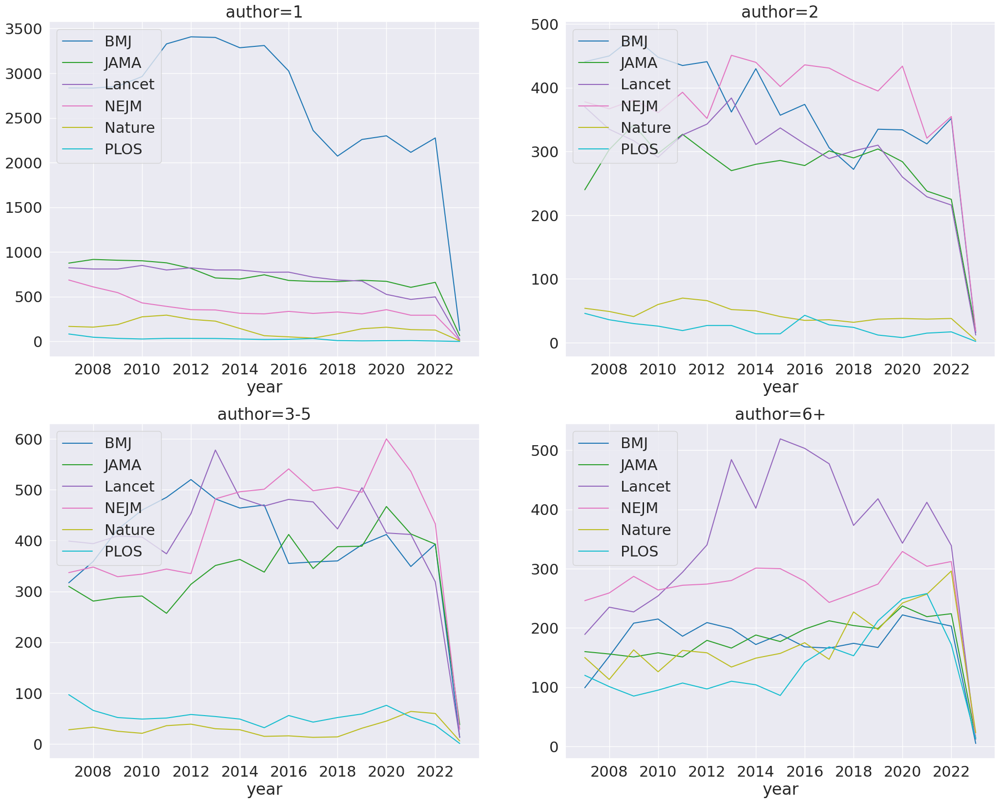

In [ ]:
sns.set(font_scale=2)
fig=plt.figure(figsize=(25,20),dpi=100)

for i,j in enumerate(np.split(s2,4,axis=0),start=1):
  ax=fig.add_subplot(2,2,i)
  j.loc[j.index[1][0],:].plot(title=f'author={j.index[1][0]}',ax=ax,cmap='tab10')
  plt.legend(loc='upper left')
  

#pct_female by journals and authors_count

In [ ]:
s4= df1.groupby(['author_count_categories','journal.title'])[['pct_female_pessimistic','pct_female_real','pct_female_optimistic']].mean()

s4=s4.loc[[('1','NEJM'),('1','Lancet'),('1','Nature'),('1','JAMA'),('1','BMJ'),('1','PLOS'),
            ('2','NEJM'),('2','Lancet'),('2','Nature'),('2','JAMA'),('2','BMJ'),('2','PLOS'),
            ('3-5','NEJM'),('3-5','Lancet'),('3-5','Nature'),('3-5','JAMA'),('3-5','BMJ'),('3-5','PLOS'),
            ('6+','NEJM'),('6+','Lancet'),('6+','Nature'),('6+','JAMA'),('6+','BMJ'),('6+','PLOS'),],:].multiply(100)
s4

pct_female_pessimistic  \
author_count_categories journal.title                           
1                       NEJM                        18.925421   
                        Lancet                      22.154559   
                        Nature                      53.570004   
                        JAMA                        49.650522   
                        BMJ                         44.778188   
                        PLOS                        12.903226   
2                       NEJM                        22.036042   
                        Lancet                      25.885090   
                        Nature                      29.256757   
                        JAMA                        27.029681   
                        BMJ                         30.577705   
                        PLOS                        28.092784   
3-5                     NEJM                        24.021653   
                        Lancet                      28.576354   
                        Nature                      28.091931   
                        JAMA                        29.437744   
                        BMJ                         31.875158   
                        PLOS                        34.766478   
6+                      NEJM                        31.691158   
                        Lancet                      30.863378   
                        Nature                      31.394420   
                        JAMA                        34.463966   
                        BMJ                         35.245664   
                        PLOS                        36.010586   

                                       pct_female_real  pct_female_optimistic  
author_count_categories journal.title                                          
1                       NEJM                 19.983065              24.218123  
                        Lancet               23.454100              27.695343  
                        Nature               56.098580              58.077383  
                        JAMA                 52.960267              55.900008  
                        BMJ                  46.394665              48.262376  
                        PLOS                 14.141414              21.658986  
2                       NEJM                 24.257586              30.920013  
                        Lancet               28.374769              34.422416  
                        Nature               30.832196              36.013514  
                        JAMA                 28.807218              33.686163  
                        BMJ                  32.707201              37.347437  
                        PLOS                 30.759162              38.402062  
3-5                     NEJM                 25.797264              31.055579  
                        Lancet               31.801318              38.740191  
                        Nature               30.664683              36.775794  
                        JAMA                 31.847032              37.013716  
                        BMJ                  34.083927              38.213583  
                        PLOS                 37.682881              42.873823  
6+                      NEJM                 34.170674              39.063025  
                        Lancet               34.614446              41.910074  
                        Nature               34.638858              40.818113  
                        JAMA                 37.680014              43.353588  
                        BMJ                  38.129155              42.537852  
                        PLOS                 40.227679              46.383788

In [ ]:
s4['lower']=s4['pct_female_real']-s4['pct_female_pessimistic']
s4['upper']=s4['pct_female_optimistic']-s4['pct_female_real']
s4

pct_female_pessimistic  \
author_count_categories journal.title                           
1                       NEJM                        18.925421   
                        Lancet                      22.154559   
                        Nature                      53.570004   
                        JAMA                        49.650522   
                        BMJ                         44.778188   
                        PLOS                        12.903226   
2                       NEJM                        22.036042   
                        Lancet                      25.885090   
                        Nature                      29.256757   
                        JAMA                        27.029681   
                        BMJ                         30.577705   
                        PLOS                        28.092784   
3-5                     NEJM                        24.021653   
                        Lancet                      28.576354   
                        Nature                      28.091931   
                        JAMA                        29.437744   
                        BMJ                         31.875158   
                        PLOS                        34.766478   
6+                      NEJM                        31.691158   
                        Lancet                      30.863378   
                        Nature                      31.394420   
                        JAMA                        34.463966   
                        BMJ                         35.245664   
                        PLOS                        36.010586   

                                       pct_female_real  pct_female_optimistic  \
author_count_categories journal.title                                           
1                       NEJM                 19.983065              24.218123   
                        Lancet               23.454100              27.695343   
                        Nature               56.098580              58.077383   
                        JAMA                 52.960267              55.900008   
                        BMJ                  46.394665              48.262376   
                        PLOS                 14.141414              21.658986   
2                       NEJM                 24.257586              30.920013   
                        Lancet               28.374769              34.422416   
                        Nature               30.832196              36.013514   
                        JAMA                 28.807218              33.686163   
                        BMJ                  32.707201              37.347437   
                        PLOS                 30.759162              38.402062   
3-5                     NEJM                 25.797264              31.055579   
                        Lancet               31.801318              38.740191   
                        Nature               30.664683              36.775794   
                        JAMA                 31.847032              37.013716   
                        BMJ                  34.083927              38.213583   
                        PLOS                 37.682881              42.873823   
6+                      NEJM                 34.170674              39.063025   
                        Lancet               34.614446              41.910074   
                        Nature               34.638858              40.818113   
                        JAMA                 37.680014              43.353588   
                        BMJ                  38.129155              42.537852   
                        PLOS                 40.227679              46.383788   

                                          lower     upper  
author_count_categories journal.title                      
1                       NEJM           1.057644  4.235058  
                        Lancet         1.299541  4.241243  
 

In [ ]:
s4_piv=s4.pivot_table(index='author_count_categories',columns='journal.title',values='pct_female_real')
s4_piv

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
author_count_categories,,,,,,
1,46.394665,52.960267,23.454100,19.983065,56.098580,14.141414
2,32.707201,28.807218,28.374769,24.257586,30.832196,30.759162
3-5,34.083927,31.847032,31.801318,25.797264,30.664683,37.682881
6+,38.129155,37.680014,34.614446,34.170674,34.638858,40.227679


In [ ]:
asy_err=np.split(s4[['lower','upper']].values,4,axis=0)
print(asy_err)

[array([[1.05764419, 4.2350583 ],
       [1.29954099, 4.24124295],
       [2.52857579, 1.97880354],
       [3.30974448, 2.93974158],
       [1.61647743, 1.86771075],
       [1.23818833, 7.51757203]]), array([[2.22154381, 6.66242711],
       [2.48967883, 6.04764669],
       [1.5754397 , 5.18131706],
       [1.77753695, 4.87894494],
       [2.12949508, 4.64023641],
       [2.6663788 , 7.64289955]]), array([[1.77561148, 5.25831451],
       [3.22496365, 6.93887332],
       [2.57275132, 6.11111111],
       [2.40928768, 5.16668489],
       [2.20876947, 4.12965638],
       [2.9164025 , 5.19094213]]), array([[2.47951539, 4.89235094],
       [3.75106783, 7.29562832],
       [3.24443838, 6.17925501],
       [3.21604878, 5.67357366],
       [2.88349101, 4.40869698],
       [4.21709229, 6.15610903]])]


In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(4, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((4,2)).T,np.split(asy_err,6,axis=2))))

Text(0.5, 1.0, '%female by authors_count and journal')

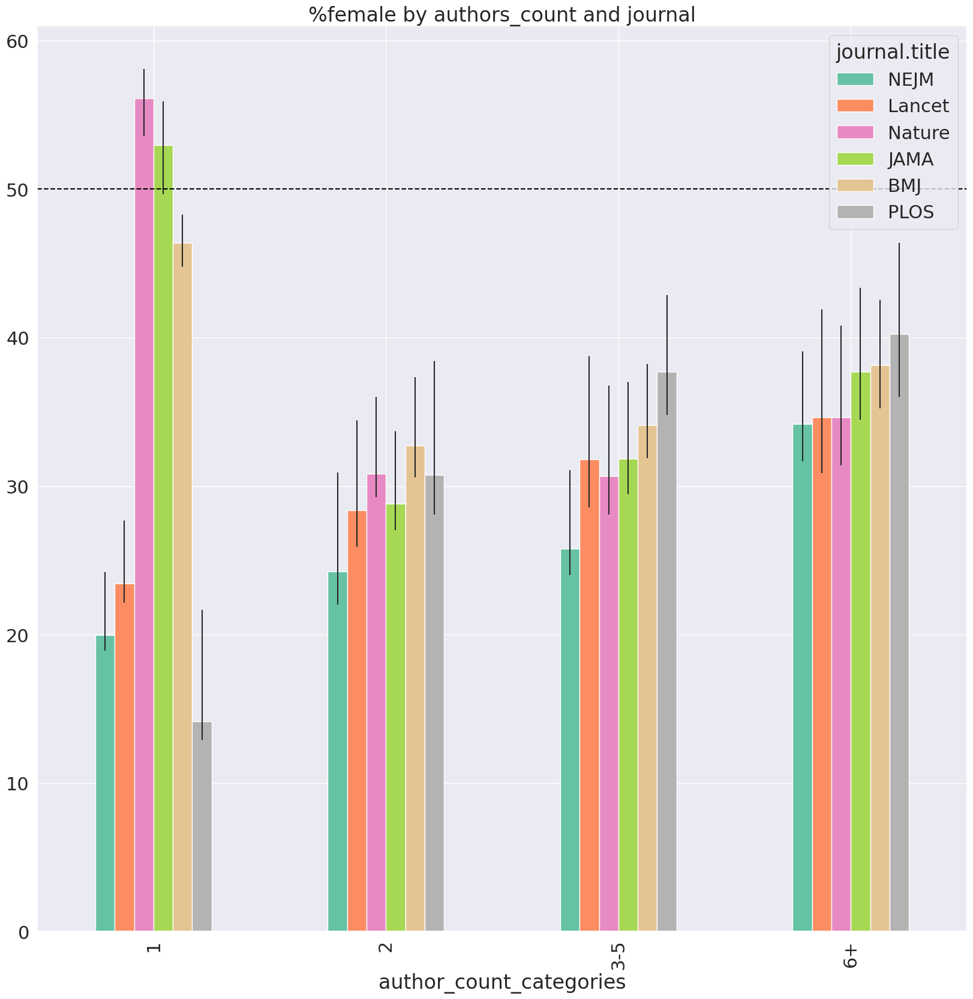

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)

sns.set(font_scale=2)
s4_piv.loc[:,['NEJM','Lancet','Nature','JAMA','BMJ','PLOS']].plot.bar(yerr=asy_err,cmap='Set2',ax=plt.gca())
plt.axhline(y=50,linestyle='--',color='black')
plt.title('%female by authors_count and journal')

Comment from Marie: Same comment about multiplying by 100 to have a "Proportion" or "Percentage" on the y-axis. I would also add an horizontal dashed line in black or gray to indicate 50%. Should we include error bars at the top?

#pct_female by just journal (include articles with 1 author)

In [ ]:
s4= df1.groupby('journal.title')[['pct_female_pessimistic','pct_female_real','pct_female_optimistic']].mean()
s4=s4*100
s4

,pct_female_pessimistic,pct_female_real,pct_female_optimistic
journal.title,,,
BMJ,41.458805,43.186592,45.774753
JAMA,39.282960,41.801530,46.212176
Lancet,26.032801,28.585092,34.266735
NEJM,23.614468,25.533986,30.746172
Nature,39.293600,41.812939,46.503379
PLOS,32.441414,36.106372,42.127997


In [ ]:
s4['lower']=s4['pct_female_real']-s4['pct_female_pessimistic']
s4['upper']=s4['pct_female_optimistic']-s4['pct_female_real']
s4=s4.sort_values(by='pct_female_real')
s4

,pct_female_pessimistic,pct_female_real,pct_female_optimistic,lower,upper
journal.title,,,,,
NEJM,23.614468,25.533986,30.746172,1.919518,5.212186
Lancet,26.032801,28.585092,34.266735,2.552291,5.681643
PLOS,32.441414,36.106372,42.127997,3.664958,6.021625
JAMA,39.282960,41.801530,46.212176,2.518570,4.410646
Nature,39.293600,41.812939,46.503379,2.519339,4.690440
BMJ,41.458805,43.186592,45.774753,1.727787,2.588162


In [ ]:
s4[['lower','upper']].values.shape

(6, 2)

Text(0.5, 1.0, '%female by journal')

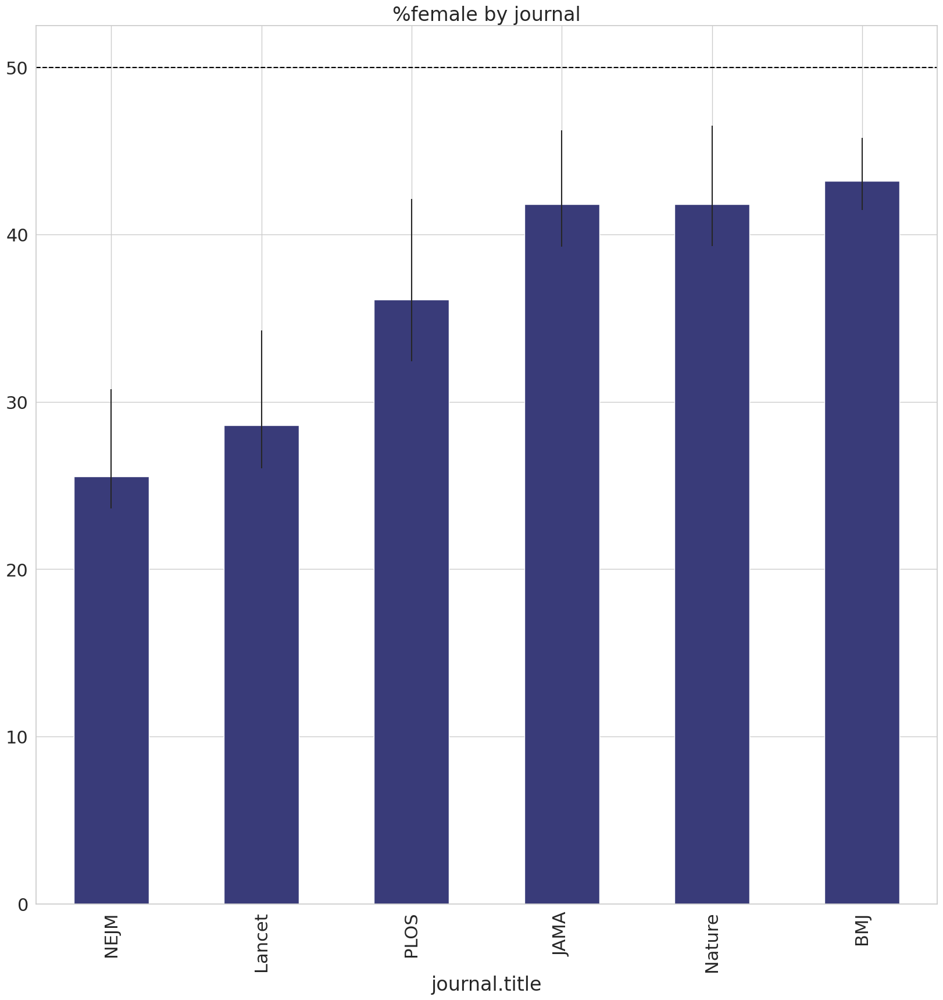

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(style='whitegrid',font_scale=2)
s4['pct_female_real'].plot.bar(yerr=s4[['lower','upper']].values.T,ax=plt.gca(),cmap='tab20b')
plt.axhline(y=50,linestyle='--',color='black')
plt.title('%female by journal')

#pct_female by journals(exclude articles with 1 author)

In [ ]:
s4= df1.loc[df1['authors_count']>=2,:].groupby('journal.title')[['pct_female_pessimistic','pct_female_real','pct_female_optimistic']].mean()
s4=s4*100
s4

,pct_female_pessimistic,pct_female_real,pct_female_optimistic
journal.title,,,
BMJ,31.999770,34.311833,38.685933
JAMA,29.741571,32.124740,37.296351
Lancet,28.576908,31.783757,38.577536
NEJM,25.241866,27.374837,33.011821
Nature,30.606477,33.469483,39.460654
PLOS,34.833395,38.567641,44.633935


In [ ]:
s4['lower']=s4['pct_female_real']-s4['pct_female_pessimistic']
s4['upper']=s4['pct_female_optimistic']-s4['pct_female_real']
s4=s4.sort_values(by='pct_female_real')
s4

,pct_female_pessimistic,pct_female_real,pct_female_optimistic,lower,upper
journal.title,,,,,
NEJM,25.241866,27.374837,33.011821,2.132971,5.636984
Lancet,28.576908,31.783757,38.577536,3.206848,6.793779
JAMA,29.741571,32.124740,37.296351,2.383170,5.171610
Nature,30.606477,33.469483,39.460654,2.863006,5.991170
BMJ,31.999770,34.311833,38.685933,2.312063,4.374099
PLOS,34.833395,38.567641,44.633935,3.734246,6.066294


In [ ]:
s4[['lower','upper']].values.shape

(6, 2)

Text(0.5, 1.0, '%female by journal')

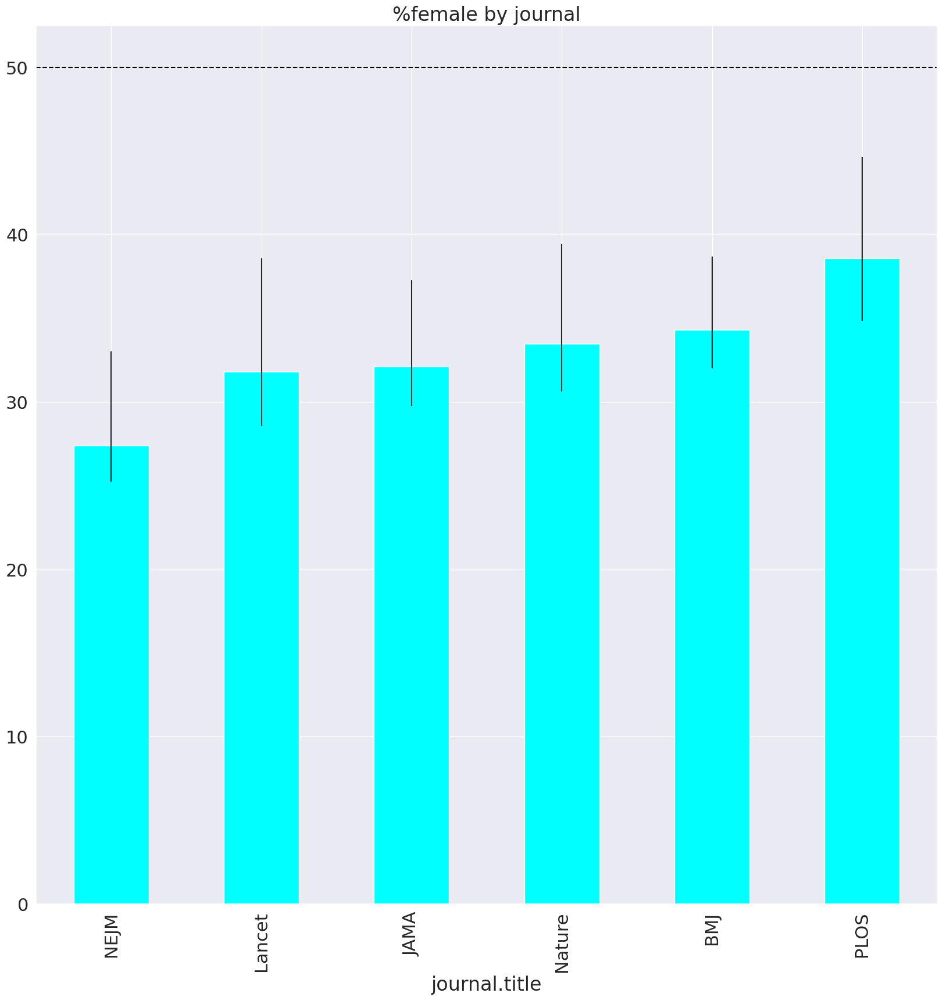

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s4['pct_female_real'].plot.bar(yerr=s4[['lower','upper']].values.T,color='cyan',ax=plt.gca())
plt.axhline(y=50,linestyle='--',color='black')
plt.title('%female by journal')

#pct_female_real by authors_count,journal and year

In [ ]:
s3 = df1.groupby(['year','author_count_categories','journal.title']).mean()

In [ ]:
s3=s3.pivot_table(index=['author_count_categories','year'],columns='journal.title',values='pct_female_real')
s3

journal.title                      BMJ      JAMA    Lancet      NEJM  \
author_count_categories year                                           
1                       2007  0.374586  0.405213  0.257772  0.185070   
                        2008  0.362509  0.407491  0.232497  0.169550   
                        2009  0.385234  0.340278  0.263576  0.151751   
                        2010  0.390999  0.386417  0.239103  0.175904   
                        2011  0.453839  0.408468  0.189474  0.171662   
...                                ...       ...       ...       ...   
6+                      2019  0.400090  0.361339  0.412738  0.324952   
                        2020  0.426911  0.384108  0.372762  0.343420   
                        2021  0.437347  0.448367  0.415153  0.362677   
                        2022  0.429822  0.447270  0.420996  0.396622   
                        2023  0.337700  0.393465  0.316860  0.504478   

journal.title                   Nature      PLOS  
author_count_categories year                      
1                       2007  0.500000  0.146667  
                        2008  0.496503  0.166667  
                        2009  0.465517  0.125000  
                        2010  0.321970  0.160000  
                        2011  0.515901  0.035714  
...                                ...       ...  
6+                      2019  0.366530  0.442047  
                        2020  0.351817  0.423191  
                        2021  0.376881  0.430365  
                        2022  0.381325  0.477312  
                        2023  0.397728  0.419516  

[68 rows x 6 columns]

In [ ]:
df1.loc[((df1['author_count_categories']=='1') & (df1['journal.title']=='JAMA') & (df1['year']==2015)) , 'pct_female_real'].value_counts()

1.0    399
0.0    279
Name: pct_female_real, dtype: int64

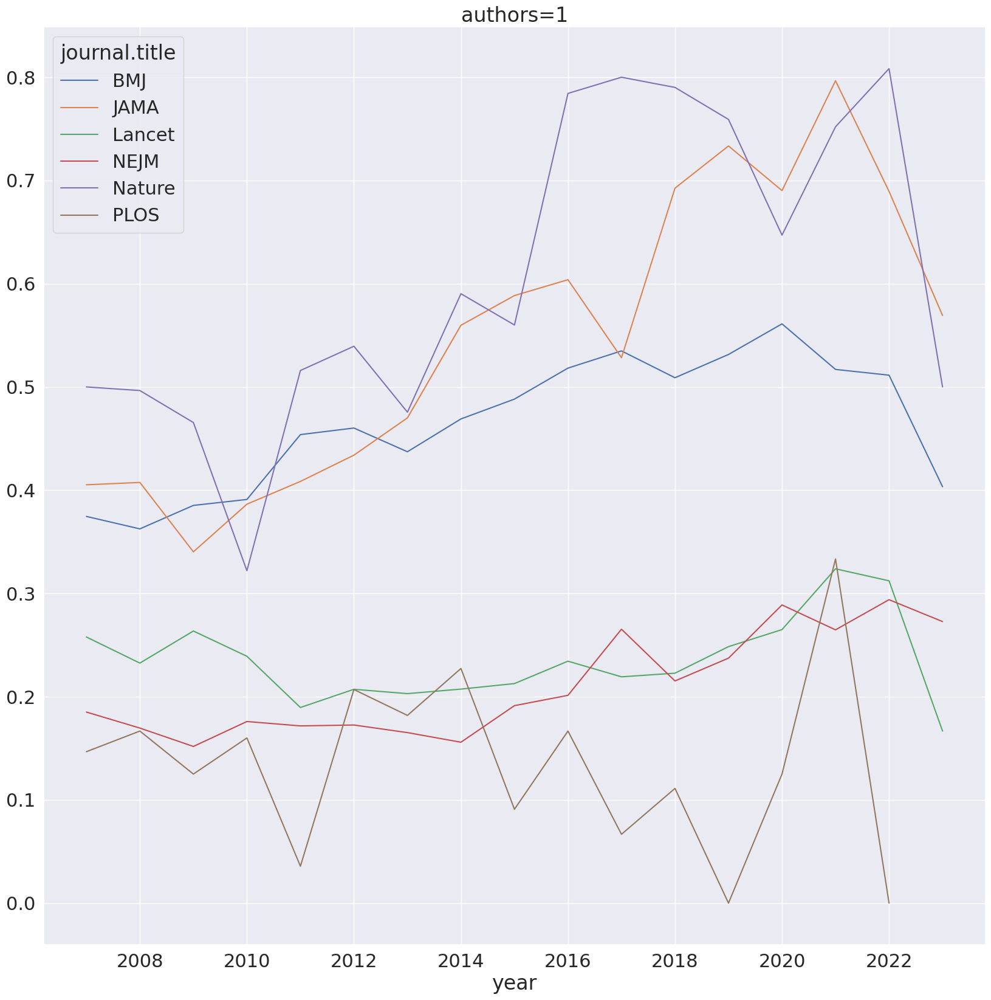

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
#plt.rc('axes', titlesize=15)
s3.loc['1',:].plot(title=f"authors={'1'}",ax=plt.gca())

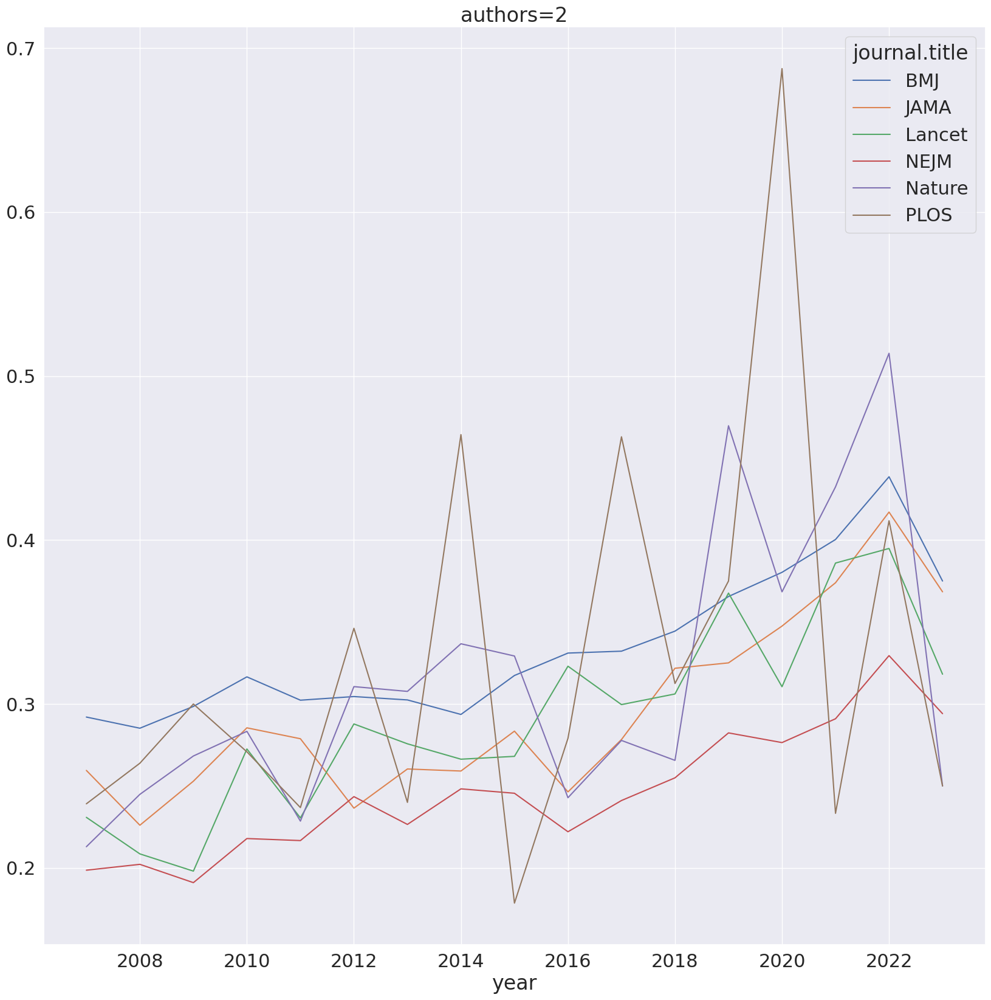

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
#plt.rc('axes', titlesize=15)
s3.loc['2',:].plot(title=f"authors={'2'}",ax=plt.gca())

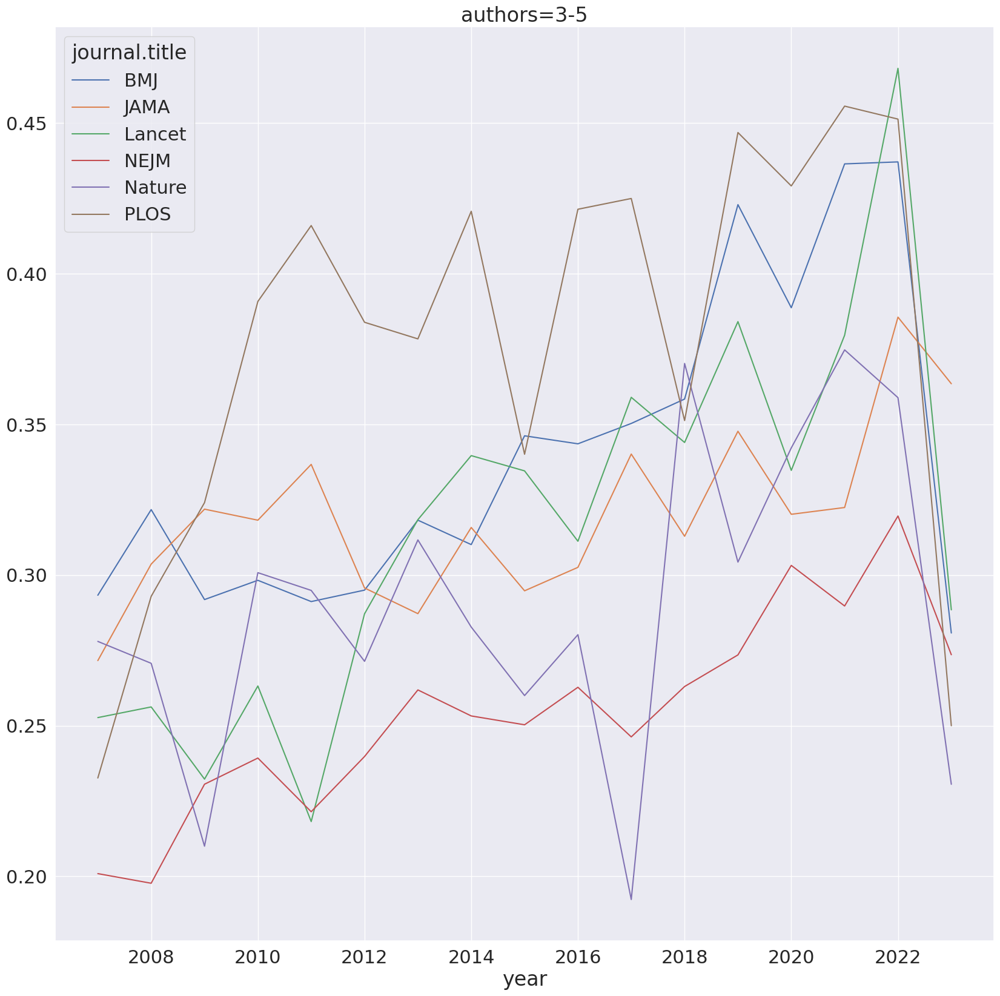

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
#plt.rc('axes', titlesize=15)
s3.loc['3-5',:].plot(title=f"authors={'3-5'}",ax=plt.gca())

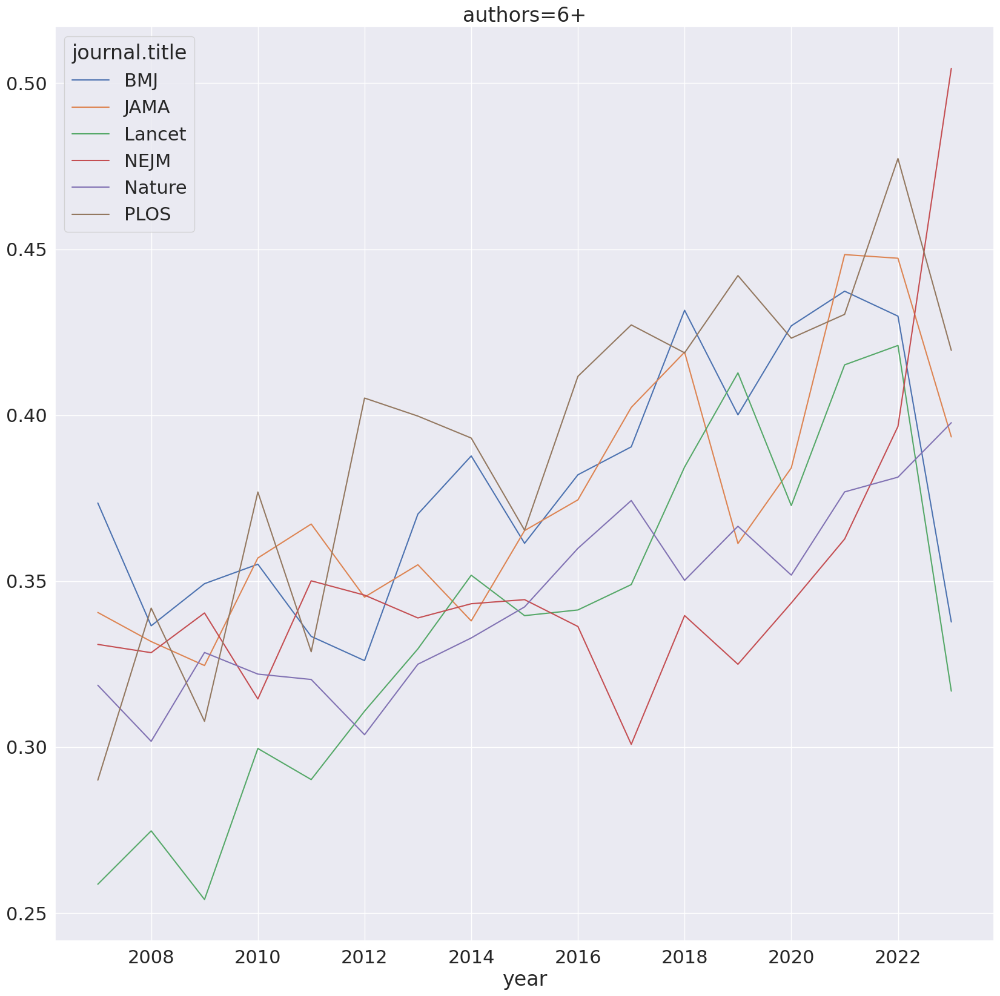

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
#plt.rc('axes', titlesize=15)
s3.loc['6+',:].plot(title=f"authors={'6+'}",ax=plt.gca())

In [ ]:
#plt.figure(figsize=(200,400))

#plt.rc(['xtick','ytick'], labelsize=80)
#plt.rc('axes', titlesize=100)

#for i , j in enumerate(df1.groupby(['journal.title','author_count_categories','year'])['pct_female_real'],start=1):
    #plt.subplot(24,20,i)
    #j[1].hist()
    #plt.title(f'{j[0][0]}|authors={j[0][1]}|year={j[0][2]}')

#pre-processing2

In [ ]:
df1.rename(columns={'id':'pub_id'},inplace=True)

In [ ]:
df1.loc[df1['pub_id']=='pub.1000005818','authors']

103458    [{'affiliations': [], 'corresponding': True, '...
Name: authors, dtype: object

In [ ]:
df2.loc[df2['pub_id']=='pub.1000005818',:]

,Unnamed: 0,aff_city,aff_city_id,aff_country,aff_country_code,aff_id,aff_name,aff_raw_affiliation,aff_state,aff_state_code,pub_id,researcher_id,first_name,last_name


In [ ]:
df2['pub_id'].unique().shape

(108636,)

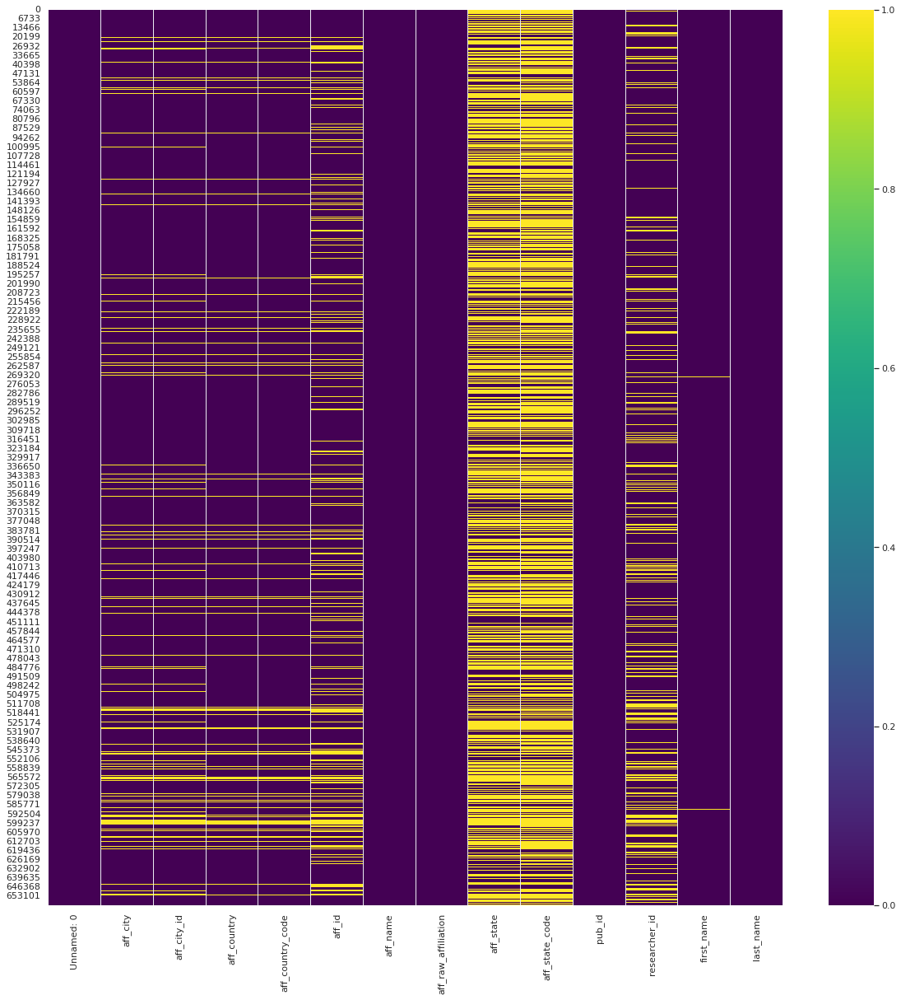

In [ ]:
plt.figure(figsize=(20,20))
sns.set(font_scale=1)
sns.heatmap(df2.isna(),cmap='viridis')

In [ ]:
df2.loc[df2['aff_city'].isna() & df2['aff_city_id'].isna() & df2['aff_country'].isna() & df2['aff_country_code'].isna(),:]

,Unnamed: 0,aff_city,aff_city_id,aff_country,aff_country_code,aff_id,aff_name,aff_raw_affiliation,aff_state,aff_state_code,pub_id,researcher_id,first_name,last_name
4,4,NaN,NaN,NaN,NaN,NaN,"Maidstone, Kent ME17","Maidstone, Kent ME17",NaN,NaN,pub.1062804414,NaN,Jerry R,Whitmarsh
9,9,NaN,NaN,NaN,NaN,NaN,"Royal Victoria Infirmary, Newcastle on Tyne NE...","Royal Victoria Infirmary, Newcastle on Tyne NE...",NaN,NaN,pub.1062804406,ur.01110527150.75,Richard,Quinton
10,10,NaN,NaN,NaN,NaN,NaN,"Royal Victoria Infirmary, Newcastle on Tyne NE...","Royal Victoria Infirmary, Newcastle on Tyne NE...",NaN,NaN,pub.1062804406,ur.01207213057.86,Earn-Hui,Gan
14,14,NaN,NaN,NaN,NaN,NaN,Herefordshire HR2 0LR,Herefordshire HR2 0LR,NaN,NaN,pub.1062804403,NaN,Rod C,Champ
27,27,NaN,NaN,NaN,NaN,NaN,"From the Burns Service, Department of Surgery ...","From the Burns Service, Department of Surgery ...",NaN,NaN,pub.1045745533,ur.011772150057.34,Robert L.,Sheridan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
658903,146683,NaN,NaN,NaN,NaN,NaN,"Editor in Chief, JAMA","Editor in Chief, JAMA",NaN,NaN,pub.1134289859,ur.01251161531.28,Howard,Bauchner
658968,146748,NaN,NaN,NaN,NaN,NaN,"Editor in Chief, JAMA","Editor in Chief, JAMA",NaN,NaN,pub.1134008447,ur.01251161531.28,Howard,Bauchner
658970,146750,NaN,NaN,NaN,NaN,NaN,"Associate Editor, JAMA","Associate Editor, JAMA",NaN,NaN,pub.1133398813,NaN,Rafael,Campo
659765,147545,NaN,NaN,NaN,NaN,NaN,中国江西省南昌市南昌大学医学院,中国江西省南昌市南昌大学医学院,NaN,NaN,pub.1134447524,NaN,韦,芊


In [ ]:
pess_df2=df2[['pub_id','aff_country']].fillna('Switzerland')
opt_df2=df2[['pub_id','aff_country']].fillna('Afghanistan')

In [ ]:
df2['lmic_pes'] = pess_df2['aff_country'].isin(df_lmic['Country'].values).values
df2.loc[df2['aff_country'].notna(),'lmic_real'] = df2.loc[df2['aff_country'].notna(),'aff_country'].isin(df_lmic['Country'].values).values
df2['lmic_opt'] = opt_df2['aff_country'].isin(df_lmic['Country'].values).values


In [ ]:
df2[['aff_country','lmic_pes','lmic_real','lmic_opt']].isna().sum()

aff_country    48307
lmic_pes           0
lmic_real      48307
lmic_opt           0
dtype: int64

In [ ]:
#df2.dropna(axis=0,how='all',subset=['aff_city','aff_city_id','aff_country','aff_country_code'],inplace=True) # we should plan for missing countries about 48302 authors for example chief editor of JAMA has missing value in country

In [ ]:
df1.set_index('pub_id',inplace=True)
df2.set_index('pub_id',inplace=True)

df1 has 150060 articles

df2 has recorded data for 108636

108621 articles are shared between df1 and df2

15 articles are in df2 which aren't in df1 ( after dropping missing values for authors_count)

41439 articles are in df1 which aren't in df2

aff_country of 48307 authors have missing values



In [ ]:
df1_final=pd.concat([df1,
           df2.reset_index()[['pub_id','lmic_pes']].drop_duplicates(subset='pub_id',keep='first').rename(columns={'lmic_pes':'first_lmic_pes'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_real']].drop_duplicates(subset='pub_id',keep='first').rename(columns={'lmic_real':'first_lmic_real'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_opt']].drop_duplicates(subset='pub_id',keep='first').rename(columns={'lmic_opt':'first_lmic_opt'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_pes']].drop_duplicates(subset='pub_id',keep='last').rename(columns={'lmic_pes':'last_lmic_pes'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_real']].drop_duplicates(subset='pub_id',keep='last').rename(columns={'lmic_real':'last_lmic_real'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_opt']].drop_duplicates(subset='pub_id',keep='last').rename(columns={'lmic_opt':'last_lmic_opt'}).set_index('pub_id'),
           df2.reset_index()[['pub_id','lmic_pes']].groupby('pub_id').mean().rename(columns={'lmic_pes':'pct_lmic_pes'}),
           df2.reset_index()[['pub_id','lmic_real']].groupby('pub_id').mean().rename(columns={'lmic_real':'pct_lmic_real'}),
           df2.reset_index()[['pub_id','lmic_opt']].groupby('pub_id').mean().rename(columns={'lmic_opt':'pct_lmic_opt'})],axis=1,join='outer')

In [ ]:
df2.reset_index()['pub_id'].unique().shape

(108636,)

In [ ]:
df2.shape

(659789, 16)

In [ ]:
df1['authors_count'].sort_values(ascending=False)

pub_id
pub.1149823050    7942.0
pub.1138069446    7194.0
pub.1137619274    6349.0
pub.1145436222    6303.0
pub.1142633382    6215.0
                   ...  
pub.1149753174       NaN
pub.1148142824       NaN
pub.1147926655       NaN
pub.1147759314       NaN
pub.1145738834       NaN
Name: authors_count, Length: 150076, dtype: float64

researchers ID had missing values so we used authors_count variable in first dataframe and calculated number of authors for each publication in df2 to see which publications have different number of authors. these publication may have recorded a same author with different affiliations.



In [ ]:
df2.loc[(df2.reset_index()['pub_id'].value_counts().to_frame().merge(df1['authors_count'],left_index=True,right_index=True)['pub_id']-df2.reset_index()['pub_id'].value_counts().to_frame().merge(df1['authors_count'],left_index=True,right_index=True)['authors_count']>0),:].reset_index()['pub_id'].unique().shape

(24109,)

24109 articles have authors with several affiliations
about 44000 authors among 440000 authors of these articles have affiliation of LMIC

In [ ]:
df1_final['at_least_one_lmic_pes']=df1_final['pct_lmic_pes'].copy()
df1_final['at_least_one_lmic_real']=df1_final['pct_lmic_real'].copy()
df1_final['at_least_one_lmic_opt']=df1_final['pct_lmic_opt'].copy()

df1_final.loc[df1_final['pct_lmic_pes']>0,'at_least_one_lmic_pes']=1
df1_final.loc[df1_final['pct_lmic_real']>0,'at_least_one_lmic_real']=1
df1_final.loc[df1_final['pct_lmic_opt']>0,'at_least_one_lmic_opt']=1

In [ ]:
df1_final.isna().sum().to_dict()

{'Unnamed: 0': 0,
 'title': 0,
 'authors': 0,
 'authors_count': 16,
 'category_for': 0,
 'concepts': 4868,
 'concepts_scores': 4868,
 'date': 0,
 'issue': 31788,
 'open_access': 0,
 'pages': 372,
 'pmid': 29976,
 'relative_citation_ratio': 67338,
 'researchers': 38671,
 'times_cited': 0,
 'type': 0,
 'volume': 4729,
 'year': 0,
 'journal.id': 0,
 'journal.title': 0,
 'funder_countries': 124143,
 'funders': 124143,
 'doi': 1173,
 'research_org_cities': 46936,
 'research_org_countries': 46011,
 'research_org_country_names': 46011,
 'research_org_names': 41440,
 'research_org_state_names': 83037,
 'research_org_state_codes': 103289,
 'research_orgs': 67200,
 'altmetric': 46817,
 'abstract': 103985,
 'category_bra': 116154,
 'category_hrcs_hc': 123632,
 'category_icrp_ct': 139683,
 'pmcid': 128040,
 'category_hra': 123872,
 'category_rcdc': 123878,
 'category_sdg': 127957,
 'category_uoa': 121634,
 'category_hrcs_rac': 129707,
 'category_icrp_cso': 142868,
 'female_first_real': 9357,
 'fem

In [ ]:
ast.literal_eval(df1_final.loc[df1_final['authors_count'].isna(),:].iloc[1,2])

[{'affiliations': [{'city': 'San Francisco',
    'city_id': 5391959,
    'country': 'United States',
    'country_code': 'US',
    'id': 'grid.431302.7',
    'name': 'Public Library of Science',
    'raw_affiliation': 'Public Library of Science, San Francisco, California, United States of America and Cambridge, United Kingdom',
    'state': 'California',
    'state_code': 'US-CA'},
   {'city': 'Cambridge',
    'city_id': 2653941,
    'country': 'United Kingdom',
    'country_code': 'GB',
    'id': None,
    'name': 'Public Library of Science, San Francisco, California, United States of America and Cambridge, United Kingdom',
    'raw_affiliation': 'Public Library of Science, San Francisco, California, United States of America and Cambridge, United Kingdom',
    'state': 'England',
    'state_code': None}],
  'corresponding': '',
  'current_organization_id': '',
  'first_name': '',
  'last_name': '',
  'orcid': [],
  'raw_affiliation': ['Public Library of Science, San Francisco, Califor

In [ ]:
df1_final.loc[df1_final['authors_count']==3,'authors'].iloc[0]

'[{\'affiliations\': [], \'corresponding\': \'\', \'current_organization_id\': \'grid.4305.2\', \'first_name\': \'Robert\', \'last_name\': \'Semple\', \'orcid\': [\'0000-0001-6539-3069\'], \'raw_affiliation\': [], \'researcher_id\': \'ur.01167062360.32\'}, {\'affiliations\': [], \'corresponding\': \'\', \'current_organization_id\': \'grid.5335.0\', \'first_name\': \'David B\', \'last_name\': \'Savage\', \'orcid\': [\'0000-0002-7857-7032\'], \'raw_affiliation\': [], \'researcher_id\': \'ur.0607043561.67\'}, {\'affiliations\': [], \'corresponding\': \'\', \'current_organization_id\': \'grid.5335.0\', \'first_name\': \'Steven\', \'last_name\': "O\'Rahilly", \'orcid\': [\'0000-0003-2199-4449\'], \'raw_affiliation\': [], \'researcher_id\': \'ur.07711435224.39\'}]'

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]
df1_more2['journal.title'].value_counts()

Lancet    12830
NEJM      11639
BMJ        9557
JAMA       8632
Nature     3380
PLOS       3157
Name: journal.title, dtype: int64

#Authorship Distribution by Country and Income Group

shoud be revised

In [ ]:
fem_fir_inc=df1_final.replace({True:'LMICs',False:'HICs'}).loc[df1_final['author_count_categories']!='1'].groupby(['first_lmic_pes','journal.title'])['female_first_optimistic'].mean().to_frame()
fem_fir_inc

female_first_optimistic
first_lmic_pes journal.title                         
HICs           BMJ                           0.392416
               JAMA                          0.384479
               Lancet                        0.377119
               NEJM                          0.311905
               Nature                        0.415429
               PLOS                          0.495608
LMICs          BMJ                           0.527326
               JAMA                          0.418129
               Lancet                        0.446725
               NEJM                          0.398889
               Nature                        0.515957
               PLOS                          0.458738

In [ ]:
fem_fir_inc['Counts']=df1_final.replace({True:'LMICs',False:'HICs'}).loc[df1_final['author_count_categories']!='1'].groupby(['first_lmic_pes','journal.title'])['female_first_optimistic'].size().values

In [ ]:
fem_fir_inc

female_first_optimistic  Counts
first_lmic_pes journal.title                                 
HICs           BMJ                           0.392416   12632
               JAMA                          0.384479   10708
               Lancet                        0.377119   15157
               NEJM                          0.311905   12071
               Nature                        0.415429    3772
               PLOS                          0.495608    2975
LMICs          BMJ                           0.527326     677
               JAMA                          0.418129     342
               Lancet                        0.446725    2290
               NEJM                          0.398889     900
               Nature                        0.515957     188
               PLOS                          0.458738     412

In [ ]:
fem_fir_inc_piv=fem_fir_inc.pivot_table(index='first_lmic_pes',columns='journal.title',values='female_first_optimistic')
fem_fir_inc_piv

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
first_lmic_pes,,,,,,
HICs,0.392416,0.384479,0.377119,0.311905,0.415429,0.495608
LMICs,0.527326,0.418129,0.446725,0.398889,0.515957,0.458738


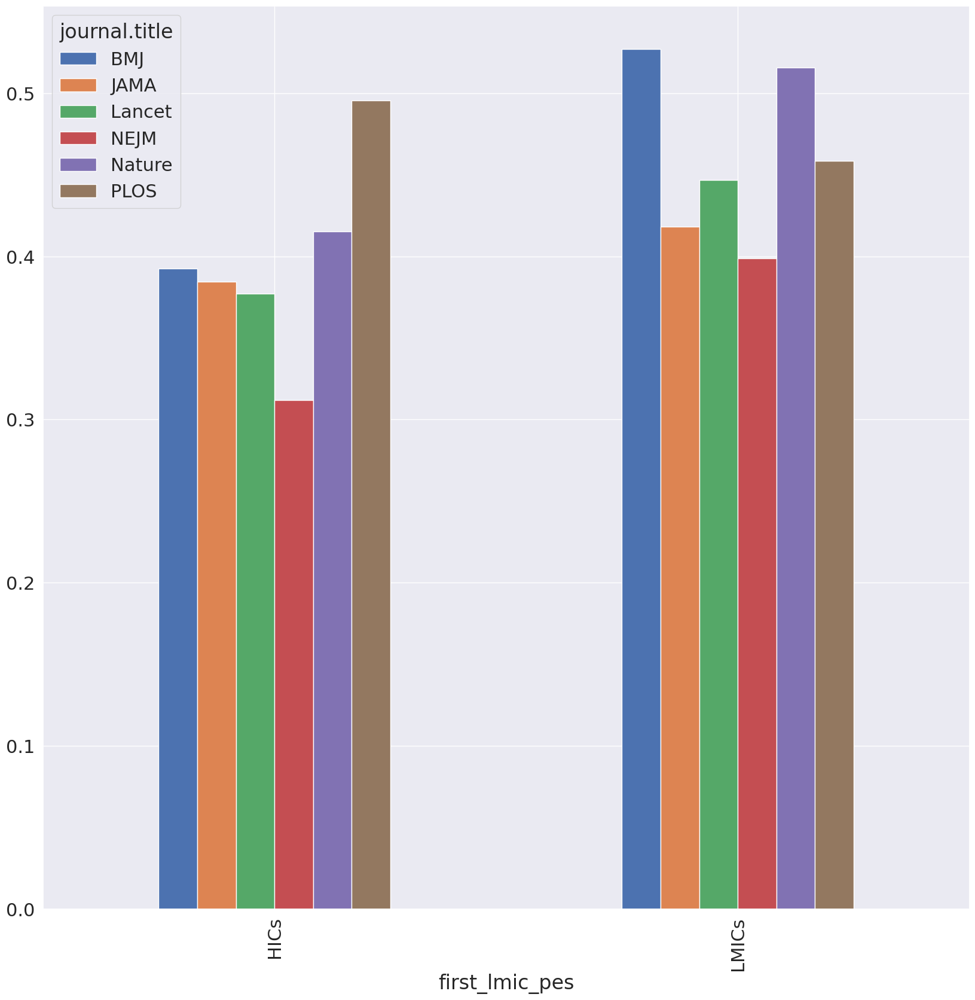

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
fem_fir_inc_piv.plot.bar(ax=plt.gca())

# First author is from LMICs by authors_count and journal

In [ ]:
fir_lmic=df1_final.groupby(['author_count_categories','journal.title'])[['first_lmic_pes','first_lmic_real','first_lmic_opt']].mean()

fir_lmic=fir_lmic.loc[[('1','JAMA'),('1','Nature'),('1','NEJM'),('1','BMJ'),('1','PLOS'),('1','Lancet'),
                       ('2','JAMA'),('2','Nature'),('2','NEJM'),('2','BMJ'),('2','PLOS'),('2','Lancet'),
                       ('3-5','JAMA'),('3-5','Nature'),('3-5','NEJM'),('3-5','BMJ'),('3-5','PLOS'),('3-5','Lancet'),
                       ('6+','JAMA'),('6+','Nature'),('6+','NEJM'),('6+','BMJ'),('6+','PLOS'),('6+','Lancet')],:].multiply(100)

fir_lmic

first_lmic_pes  first_lmic_real  \
author_count_categories journal.title                                    
1                       JAMA                 1.352955         1.552288   
                        Nature               3.689320         4.541833   
                        NEJM                 2.669405         2.847309   
                        BMJ                  3.111329         3.328533   
                        PLOS                10.887097        11.020408   
                        Lancet               8.208617         8.479738   
2                       JAMA                 2.274596         2.407193   
                        Nature               2.739726         2.758621   
                        NEJM                 9.210238        10.054932   
                        BMJ                  5.711160         5.823293   
                        PLOS                10.752688        10.752688   
                        Lancet              10.939749        10.957775   
3-5                     JAMA                 3.211318         3.295690   
                        Nature               4.887984         4.887984   
                        NEJM                 5.303576         6.088154   
                        BMJ                  3.910235         3.977174   
                        PLOS                 9.615385         9.673519   
                        Lancet              13.657838        13.661750   
6+                      JAMA                 3.934871         4.120782   
                        Nature               5.257393         5.270864   
                        NEJM                 6.094968         7.012775   
                        BMJ                  6.510326         6.579413   
                        PLOS                13.468635        13.524780   
                        Lancet              14.359707        14.390549   

                                       first_lmic_opt  
author_count_categories journal.title                  
1                       JAMA                14.194161  
                        Nature              22.459547  
                        NEJM                 8.917571  
                        BMJ                  9.636859  
                        PLOS                12.096774  
                        Lancet              11.405896  
2                       JAMA                 7.782954  
                        Nature               3.424658  
                        NEJM                17.611026  
                        BMJ                  7.636761  
                        PLOS                10.752688  
                        Lancet              11.104257  
3-5                     JAMA                 5.771390  
                        Nature               4.887984  
                        NEJM                18.190545  
                        BMJ                  5.593336  
                        PLOS                10.216346  
                        Lancet              13.686471  
6+                      JAMA                 8.446404  
                        Nature               5.512961  
                        NEJM                19.182613  
                        BMJ                  7.560378  
                        PLOS                13.883764  
                        Lancet              14.574031

In [ ]:
fir_lmic_c=df1_final.groupby('author_count_categories')['journal.title'].value_counts().to_frame()
fir_lmic_c.rename(columns={'journal.title':'counts'},inplace=True)
fir_lmic_c.div(df1_final.loc[df1_final['author_count_categories'].notna(),'journal.title'].value_counts().rename('counts').to_frame(),axis=0,level=1)

counts
author_count_categories journal.title          
1                       BMJ            0.740235
                        JAMA           0.479251
                        Lancet         0.396133
                        NEJM           0.257645
                        Nature         0.378301
                        PLOS           0.109073
2                       NEJM           0.261405
                        BMJ            0.101659
                        Lancet         0.167946
                        JAMA           0.180571
                        Nature         0.111664
                        PLOS           0.097512
3-5                     NEJM           0.295165
                        Lancet         0.238142
                        BMJ            0.109369
                        JAMA           0.222187
                        PLOS           0.222418
                        Nature         0.076053
6+                      Lancet         0.197778
                        NEJM           0.185785
                        JAMA           0.117990
                        BMJ            0.048737
                        Nature         0.433982
                        PLOS           0.570998

In [ ]:
fir_lmic['lower']=fir_lmic['first_lmic_real']-fir_lmic['first_lmic_pes']
fir_lmic['upper']=fir_lmic['first_lmic_opt']-fir_lmic['first_lmic_pes']
fir_lmic

first_lmic_pes  first_lmic_real  \
author_count_categories journal.title                                    
1                       JAMA                 1.352955         1.552288   
                        Nature               3.689320         4.541833   
                        NEJM                 2.669405         2.847309   
                        BMJ                  3.111329         3.328533   
                        PLOS                10.887097        11.020408   
                        Lancet               8.208617         8.479738   
2                       JAMA                 2.274596         2.407193   
                        Nature               2.739726         2.758621   
                        NEJM                 9.210238        10.054932   
                        BMJ                  5.711160         5.823293   
                        PLOS                10.752688        10.752688   
                        Lancet              10.939749        10.957775   
3-5                     JAMA                 3.211318         3.295690   
                        Nature               4.887984         4.887984   
                        NEJM                 5.303576         6.088154   
                        BMJ                  3.910235         3.977174   
                        PLOS                 9.615385         9.673519   
                        Lancet              13.657838        13.661750   
6+                      JAMA                 3.934871         4.120782   
                        Nature               5.257393         5.270864   
                        NEJM                 6.094968         7.012775   
                        BMJ                  6.510326         6.579413   
                        PLOS                13.468635        13.524780   
                        Lancet              14.359707        14.390549   

                                       first_lmic_opt     lower      upper  
author_count_categories journal.title                                       
1                       JAMA                14.194161  0.199332  12.841206  
                        Nature              22.459547  0.852512  18.770227  
                        NEJM                 8.917571  0.177905   6.248167  
                        BMJ                  9.636859  0.217204   6.525530  
                        PLOS                12.096774  0.133311   1.209677  
                        Lancet              11.405896  0.271121   3.197279  
2                       JAMA                 7.782954  0.132597   5.508358  
                        Nature               3.424658  0.018895   0.684932  
                        NEJM                17.611026  0.844693   8.400788  
                        BMJ                  7.636761  0.112133   1.925602  
                        PLOS                10.752688  0.000000   0.000000  
                        Lancet              11.104257  0.018026   0.164508  
3-5                     JAMA                 5.771390  0.084372   2.560072  
                        Nature               4.887984  0.000000   0.000000  
                        NEJM                18.190545  0.784579  12.886969  
                        BMJ                  5.593336  0.066940   1.683101  
                        PLOS                10.216346  0.058134   0.600962  
                        Lancet              13.686471  0.003912   0.028633  
6+                      JAMA                 8.446404  0.185910   4.511533  
                        Nature               5.512961  0.013471   0.255568  
                        NEJM                19.182613  0.917807  13.087645  
                        BMJ                  7.560378  0.069087   1.050053  
                        PLOS                13.883764  0.056145   0.415129  
                        Lancet              14.574031  0.030842   0.214324

In [ ]:
s8=fir_lmic.pivot_table(index='author_count_categories',columns='journal.title',values='first_lmic_real')
s8=s8.loc[:,['JAMA','Nature','NEJM','BMJ','PLOS','Lancet']]
s8

journal.title,JAMA,Nature,NEJM,BMJ,PLOS,Lancet
author_count_categories,,,,,,
1,1.552288,4.541833,2.847309,3.328533,11.020408,8.479738
2,2.407193,2.758621,10.054932,5.823293,10.752688,10.957775
3-5,3.295690,4.887984,6.088154,3.977174,9.673519,13.661750
6+,4.120782,5.270864,7.012775,6.579413,13.524780,14.390549


In [ ]:
asy_err=np.split(fir_lmic[['lower','upper']].values,4,axis=0)
print(asy_err)

[array([[ 0.19933244, 12.84120579],
       [ 0.85251228, 18.77022654],
       [ 0.17790462,  6.24816662],
       [ 0.21720443,  6.52553003],
       [ 0.13331139,  1.20967742],
       [ 0.27112086,  3.19727891]]), array([[0.1325968 , 5.50835845],
       [0.01889466, 0.68493151],
       [0.84469347, 8.40078757],
       [0.11213344, 1.92560175],
       [0.        , 0.        ],
       [0.01802636, 0.16450751]]), array([[8.43720388e-02, 2.56007186e+00],
       [0.00000000e+00, 0.00000000e+00],
       [7.84578556e-01, 1.28869690e+01],
       [6.69398628e-02, 1.68310099e+00],
       [5.81341271e-02, 6.00961538e-01],
       [3.91173943e-03, 2.86327845e-02]]), array([[ 0.18591043,  4.51153324],
       [ 0.01347063,  0.25556773],
       [ 0.9178071 , 13.0876447 ],
       [ 0.06908729,  1.0500525 ],
       [ 0.0561453 ,  0.41512915],
       [ 0.0308424 ,  0.21432399]])]


In [ ]:
#asy_err[0]=np.insert(asy_err[0],1,[np.nan,np.nan],axis=0)
#asy_err[1]=np.insert(asy_err[1],1,[np.nan,np.nan],axis=0)


#asy_err

In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(4, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((4,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[1.99332443e-01, 1.32596796e-01, 8.43720388e-02, 1.85910428e-01],
        [1.28412058e+01, 5.50835845e+00, 2.56007186e+00, 4.51153324e+00]],

       [[8.52512281e-01, 1.88946623e-02, 0.00000000e+00, 1.34706268e-02],
        [1.87702265e+01, 6.84931507e-01, 0.00000000e+00, 2.55567725e-01]],

       [[1.77904619e-01, 8.44693472e-01, 7.84578556e-01, 9.17807103e-01],
        [6.24816662e+00, 8.40078757e+00, 1.28869690e+01, 1.30876447e+01]],

       [[2.17204426e-01, 1.12133435e-01, 6.69398628e-02, 6.90872888e-02],
        [6.52553003e+00, 1.92560175e+00, 1.68310099e+00, 1.05005250e+00]],

       [[1.33311389e-01, 0.00000000e+00, 5.81341271e-02, 5.61453044e-02],
        [1.20967742e+00, 0.00000000e+00, 6.00961538e-01, 4.15129151e-01]],

       [[2.71120863e-01, 1.80263631e-02, 3.91173943e-03, 3.08423993e-02],
        [3.19727891e+00, 1.64507506e-01, 2.86327845e-02, 2.14323986e-01]]])

Text(0.5, 1.0, 'First author from LMICs by authors count and journal')

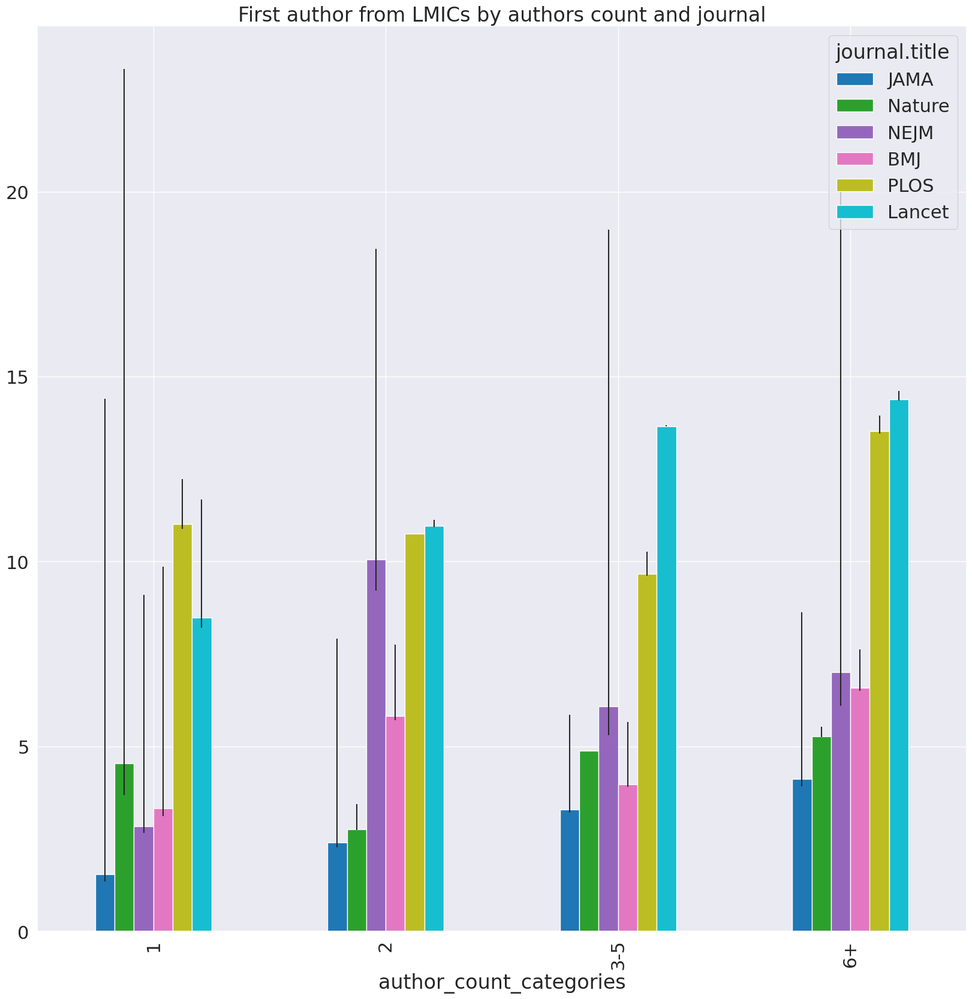

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s8.plot.bar(yerr=asy_err,cmap='tab10',ax=plt.gca())
plt.title('First author from LMICs by authors count and journal')

Comment from Marie: Irrespective of the number of authors on the paper, the pattern seems clear. The proportion of papers with at least one author from a LMIC is much higher in PLOS Medicine and The Lancet. As expected, it is the smallest in JAMA -- this makes sense, given that the journal focuses on health in the United States. I would perhaps reorder the bars as follows: JAMA, Nature Medicine, NEJM, the BMJ, PLOS Medicine, and The Lancet.

# Last author is from LMICs by authors_count and journal

In [ ]:
fir_lmic=df1_final.groupby(['author_count_categories','journal.title'])[['last_lmic_pes','last_lmic_real','last_lmic_opt']].mean()

fir_lmic=fir_lmic.loc[[('1','JAMA'),('1','Nature'),('1','NEJM'),('1','BMJ'),('1','PLOS'),('1','Lancet'),
                       ('2','JAMA'),('2','Nature'),('2','NEJM'),('2','BMJ'),('2','PLOS'),('2','Lancet'),
                       ('3-5','JAMA'),('3-5','Nature'),('3-5','NEJM'),('3-5','BMJ'),('3-5','PLOS'),('3-5','Lancet'),
                       ('6+','JAMA'),('6+','Nature'),('6+','NEJM'),('6+','BMJ'),('6+','PLOS'),('6+','Lancet')],:].multiply(100)

fir_lmic

last_lmic_pes  last_lmic_real  \
author_count_categories journal.title                                  
1                       JAMA                1.424163        1.661130   
                        Nature              3.689320        4.549082   
                        NEJM                2.610736        2.786475   
                        BMJ                 3.111329        3.330931   
                        PLOS               10.080645       10.245902   
                        Lancet              8.321995        8.604924   
2                       JAMA                2.137572        2.313167   
                        Nature              2.465753        2.479339   
                        NEJM                9.013345        9.963724   
                        BMJ                 5.601751        5.826127   
                        PLOS               11.827957       11.859838   
                        Lancet             11.659469       11.683495   
3-5                     JAMA                2.896923        3.023910   
                        Nature              4.073320        4.073320   
                        NEJM                5.159587        6.082037   
                        BMJ                 3.485209        3.632176   
                        PLOS               11.177885       11.259080   
                        Lancet             13.400143       13.409742   
6+                      JAMA                2.951153        3.186813   
                        Nature              5.074845        5.078553   
                        NEJM                5.339003        6.393211   
                        BMJ                 4.970249        5.128205   
                        PLOS               11.577491       11.625753   
                        Lancet             12.573674       12.598425   

                                       last_lmic_opt  
author_count_categories journal.title                 
1                       JAMA               15.689532  
                        Nature             22.588997  
                        NEJM                8.917571  
                        BMJ                 9.704164  
                        PLOS               11.693548  
                        Lancet             11.609977  
2                       JAMA                9.728693  
                        Nature              3.013699  
                        NEJM               18.551739  
                        BMJ                 9.452954  
                        PLOS               12.096774  
                        Lancet             11.865104  
3-5                     JAMA                7.096340  
                        Nature              4.073320  
                        NEJM               20.326374  
                        BMJ                 7.531452  
                        PLOS               11.899038  
                        Lancet             13.471725  
6+                      JAMA               10.345997  
                        Nature              5.147864  
                        NEJM               21.828490  
                        BMJ                 8.050403  
                        PLOS               11.992620  
                        Lancet             12.770138

In [ ]:
fir_lmic['lower']=fir_lmic['last_lmic_real']-fir_lmic['last_lmic_pes']
fir_lmic['upper']=fir_lmic['last_lmic_opt']-fir_lmic['last_lmic_pes']
fir_lmic

last_lmic_pes  last_lmic_real  \
author_count_categories journal.title                                  
1                       JAMA                1.424163        1.661130   
                        Nature              3.689320        4.549082   
                        NEJM                2.610736        2.786475   
                        BMJ                 3.111329        3.330931   
                        PLOS               10.080645       10.245902   
                        Lancet              8.321995        8.604924   
2                       JAMA                2.137572        2.313167   
                        Nature              2.465753        2.479339   
                        NEJM                9.013345        9.963724   
                        BMJ                 5.601751        5.826127   
                        PLOS               11.827957       11.859838   
                        Lancet             11.659469       11.683495   
3-5                     JAMA                2.896923        3.023910   
                        Nature              4.073320        4.073320   
                        NEJM                5.159587        6.082037   
                        BMJ                 3.485209        3.632176   
                        PLOS               11.177885       11.259080   
                        Lancet             13.400143       13.409742   
6+                      JAMA                2.951153        3.186813   
                        Nature              5.074845        5.078553   
                        NEJM                5.339003        6.393211   
                        BMJ                 4.970249        5.128205   
                        PLOS               11.577491       11.625753   
                        Lancet             12.573674       12.598425   

                                       last_lmic_opt     lower      upper  
author_count_categories journal.title                                      
1                       JAMA               15.689532  0.236966  14.265369  
                        Nature             22.588997  0.859762  18.899676  
                        NEJM                8.917571  0.175738   6.306835  
                        BMJ                 9.704164  0.219603   6.592835  
                        PLOS               11.693548  0.165256   1.612903  
                        Lancet             11.609977  0.282928   3.287982  
2                       JAMA                9.728693  0.175595   7.591121  
                        Nature              3.013699  0.013585   0.547945  
                        NEJM               18.551739  0.950379   9.538394  
                        BMJ                 9.452954  0.224376   3.851204  
                        PLOS               12.096774  0.031881   0.268817  
                        Lancet             11.865104  0.024025   0.205634  
3-5                     JAMA                7.096340  0.126987   4.199416  
                        Nature              4.073320  0.000000   0.000000  
                        NEJM               20.326374  0.922450  15.166787  
                        BMJ                 7.531452  0.146967   4.046243  
                        PLOS               11.899038  0.081195   0.721154  
                        Lancet             13.471725  0.009599   0.071582  
6+                      JAMA               10.345997  0.235660   7.394844  
                        Nature              5.147864  0.003708   0.073019  
                        NEJM               21.828490  1.054208  16.489487  
                        BMJ                 8.050403  0.157957   3.080154  
                        PLOS               11.992620  0.048262   0.415129  
                        Lancet             12.770138  0.024751   0.196464

In [ ]:
s8=fir_lmic.pivot_table(index='author_count_categories',columns='journal.title',values='last_lmic_real')
s8=s8.loc[:,['JAMA','Nature','NEJM','BMJ','PLOS','Lancet']]
s8

journal.title,JAMA,Nature,NEJM,BMJ,PLOS,Lancet
author_count_categories,,,,,,
1,1.661130,4.549082,2.786475,3.330931,10.245902,8.604924
2,2.313167,2.479339,9.963724,5.826127,11.859838,11.683495
3-5,3.023910,4.073320,6.082037,3.632176,11.259080,13.409742
6+,3.186813,5.078553,6.393211,5.128205,11.625753,12.598425


In [ ]:
asy_err=np.split(fir_lmic[['lower','upper']].values,4,axis=0)
print(asy_err)

[array([[ 0.23696626, 14.2653691 ],
       [ 0.85976181, 18.89967638],
       [ 0.17573835,  6.30683485],
       [ 0.21960282,  6.59283507],
       [ 0.16525648,  1.61290323],
       [ 0.28292833,  3.28798186]]), array([[0.17559532, 7.59112086],
       [0.01358542, 0.54794521],
       [0.9503793 , 9.53839422],
       [0.22437599, 3.8512035 ],
       [0.03188129, 0.2688172 ],
       [0.02402528, 0.20563438]]), array([[1.26986564e-01, 4.19941612e+00],
       [0.00000000e+00, 0.00000000e+00],
       [9.22449542e-01, 1.51667867e+01],
       [1.46966649e-01, 4.04624277e+00],
       [8.11952878e-02, 7.21153846e-01],
       [9.59895642e-03, 7.15819613e-02]]), array([[2.35659863e-01, 7.39484396e+00],
       [3.70832651e-03, 7.30193501e-02],
       [1.05420768e+00, 1.64894874e+01],
       [1.57956616e-01, 3.08015401e+00],
       [4.82618884e-02, 4.15129151e-01],
       [2.47513265e-02, 1.96463654e-01]])]


In [ ]:
#asy_err[0]=np.insert(asy_err[0],1,[np.nan,np.nan],axis=0)
#asy_err[1]=np.insert(asy_err[1],1,[np.nan,np.nan],axis=0)


#asy_err

In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(4, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((4,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[2.36966264e-01, 1.75595322e-01, 1.26986564e-01, 2.35659863e-01],
        [1.42653691e+01, 7.59112086e+00, 4.19941612e+00, 7.39484396e+00]],

       [[8.59761814e-01, 1.35854183e-02, 0.00000000e+00, 3.70832651e-03],
        [1.88996764e+01, 5.47945205e-01, 0.00000000e+00, 7.30193501e-02]],

       [[1.75738354e-01, 9.50379304e-01, 9.22449542e-01, 1.05420768e+00],
        [6.30683485e+00, 9.53839422e+00, 1.51667867e+01, 1.64894874e+01]],

       [[2.19602819e-01, 2.24375989e-01, 1.46966649e-01, 1.57956616e-01],
        [6.59283507e+00, 3.85120350e+00, 4.04624277e+00, 3.08015401e+00]],

       [[1.65256478e-01, 3.18812857e-02, 8.11952878e-02, 4.82618884e-02],
        [1.61290323e+00, 2.68817204e-01, 7.21153846e-01, 4.15129151e-01]],

       [[2.82928334e-01, 2.40252822e-02, 9.59895642e-03, 2.47513265e-02],
        [3.28798186e+00, 2.05634382e-01, 7.15819613e-02, 1.96463654e-01]]])

Text(0.5, 1.0, 'Last author from LMICs by authors count and journal')

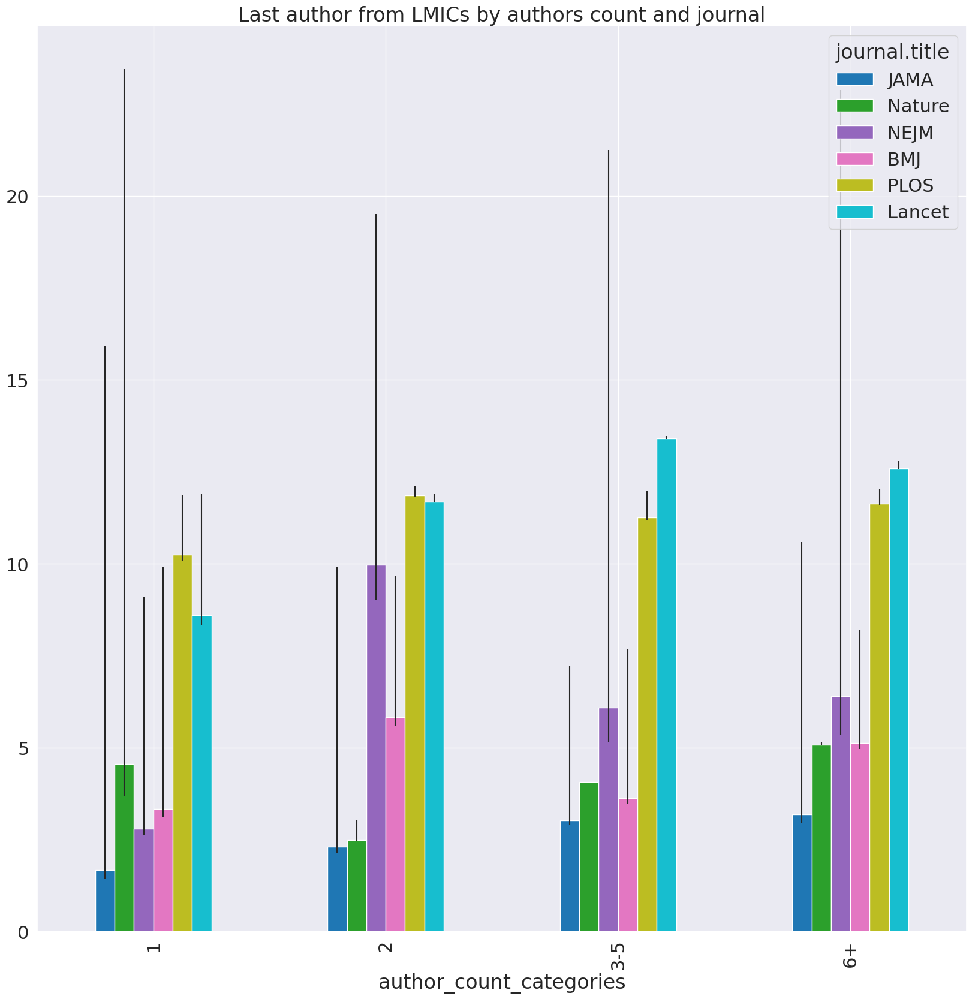

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s8.plot.bar(yerr=asy_err,cmap='tab10',ax=plt.gca())
plt.title('Last author from LMICs by authors count and journal')

Comment from Marie: same overall pattern as for the outcome = proportion of papers with first author from LMIC. Would apply the same changes, and also multiply the y-axis by 100. I would make a figure with two panels: (a) first author and (b) second author. When doing so, make sure that the limit on the y-axis is the same (20%) on both graphs so that the reader can quickly compare.

# At least one author from LMICs

sample size of publications from lmics

In [ ]:
df1_final[['at_least_one_lmic_pes','at_least_one_lmic_real','at_least_one_lmic_opt']].value_counts()

at_least_one_lmic_pes  at_least_one_lmic_real  at_least_one_lmic_opt
0.0                    0.0                     0.0                      89052
1.0                    1.0                     1.0                      10923
0.0                    0.0                     1.0                       4090
dtype: int64

In [ ]:
df1_final[df1_final['pct_lmic_pes']>0].groupby('author_count_categories')['journal.title'].value_counts().to_frame()

journal.title
author_count_categories journal.title               
1                       BMJ                     1020
                        Lancet                   387
                        NEJM                      97
                        JAMA                      61
                        Nature                    58
                        PLOS                      34
2                       Lancet                   737
                        NEJM                     440
                        BMJ                      303
                        JAMA                      99
                        PLOS                      68
                        Nature                    24
3-5                     Lancet                  1608
                        BMJ                      397
                        NEJM                     284
                        PLOS                     204
                        JAMA                     195
                        Nature                    46
6+                      Lancet                  2055
                        PLOS                     957
                        NEJM                     517
                        BMJ                      488
                        Nature                   480
                        JAMA                     364

In [ ]:
one_lmic=df1_final.groupby(['author_count_categories','journal.title'])['at_least_one_lmic_pes'].value_counts().to_frame()
one_lmic

at_least_one_lmic_pes
author_count_categories journal.title at_least_one_lmic_pes                       
1                       BMJ           0.0                                    31667
                                      1.0                                     1020
                        JAMA          0.0                                     4152
                                      1.0                                       61
                        Lancet        0.0                                     4023
                                      1.0                                      387
                        NEJM          0.0                                     3312
                                      1.0                                       97
                        Nature        0.0                                     1487
                                      1.0                                       58
                        PLOS          0.0                                      214
                                      1.0                                       34
2                       BMJ           0.0                                     4267
                                      1.0                                      303
                        JAMA          0.0                                     3550
                                      1.0                                       99
                        Lancet        0.0                                     4126
                                      1.0                                      737
                        NEJM          0.0                                     4131
                                      1.0                                      440
                        Nature        0.0                                      706
                                      1.0                                       24
                        PLOS          0.0                                      304
                                      1.0                                       68
3-5                     BMJ           0.0                                     5485
                                      1.0                                      397
                        JAMA          0.0                                     4258
                                      1.0                                      195
                        Lancet        0.0                                     5377
                                      1.0                                     1608
                        NEJM          0.0                                     3883
                                      1.0                                      284
                        Nature        0.0                                      445
                                      1.0                                       46
                        PLOS          0.0                                      628
                                      1.0                                      204
6+                      BMJ           0.0                                     2369
                                      1.0                                      488
                        JAMA          0.0                                     2584
                                      1.0                                      364
                        Lancet        0.0                                     3544
                                      1.0                                     2055
                        NEJM          0.0                                     3716
                                      1.0                                      517
                        Nature        0.0                                     2259
                                      1.0                                      480
                        PLOS          0.0                                    

In [ ]:
one_lmic=df1_final.groupby(['author_count_categories','journal.title'])[['at_least_one_lmic_pes','at_least_one_lmic_real','at_least_one_lmic_opt']].mean()

one_lmic=one_lmic.loc[[('1','JAMA'),('1','Nature'),('1','NEJM'),('1','BMJ'),('1','PLOS'),('1','Lancet'),
                       ('2','JAMA'),('2','Nature'),('2','NEJM'),('2','BMJ'),('2','PLOS'),('2','Lancet'),
                       ('3-5','JAMA'),('3-5','Nature'),('3-5','NEJM'),('3-5','BMJ'),('3-5','PLOS'),('3-5','Lancet'),
                       ('6+','JAMA'),('6+','Nature'),('6+','NEJM'),('6+','BMJ'),('6+','PLOS'),('6+','Lancet')],:].multiply(100)

one_lmic

at_least_one_lmic_pes  \
author_count_categories journal.title                          
1                       JAMA                        1.447899   
                        Nature                      3.754045   
                        NEJM                        2.845409   
                        BMJ                         3.120507   
                        PLOS                       13.709677   
                        Lancet                      8.775510   
2                       JAMA                        2.713072   
                        Nature                      3.287671   
                        NEJM                        9.625902   
                        BMJ                         6.630197   
                        PLOS                       18.279570   
                        Lancet                     15.155254   
3-5                     JAMA                        4.379070   
                        Nature                      9.368635   
                        NEJM                        6.815455   
                        BMJ                         6.749405   
                        PLOS                       24.519231   
                        Lancet                     23.020759   
6+                      JAMA                       12.347354   
                        Nature                     17.524644   
                        NEJM                       12.213560   
                        BMJ                        17.080854   
                        PLOS                       44.142066   
                        Lancet                     36.702983   

                                       at_least_one_lmic_real  \
author_count_categories journal.title                           
1                       JAMA                         1.655809   
                        Nature                       4.614161   
                        NEJM                         3.033146   
                        BMJ                          3.337369   
                        PLOS                        13.877551   
                        Lancet                       9.065355   
2                       JAMA                         2.773109   
                        Nature                       3.296703   
                        NEJM                        10.309278   
                        BMJ                          6.700575   
                        PLOS                        18.279570   
                        Lancet                      15.170852   
3-5                     JAMA                         4.408772   
                        Nature                       9.368635   
                        NEJM                         7.589524   
                        BMJ                          6.795618   
                        PLOS                        24.607961   
                        Lancet                      23.024055   
6+                      JAMA                        12.376743   
                        Nature                      17.524644   
                        NEJM                        13.208993   
                        BMJ                         17.110799   
                        PLOS                        44.203233   
                        Lancet                      36.702983   

                                       at_least_one_lmic_opt  
author_count_categories journal.title                         
1                       JAMA                       15.974365  
                        Nature                     22.783172  
                        NEJM                        9.181578  
                        BMJ                         9.737816  
                        PLOS                       15.322581  
                        Lancet                     12.086168  
2                       JAMA                       15.045218  
                        Nature                      4.520548  
                        NEJM                       23

In [ ]:
one_lmic['lower']=one_lmic['at_least_one_lmic_real']-one_lmic['at_least_one_lmic_pes']
one_lmic['upper']=one_lmic['at_least_one_lmic_opt']-one_lmic['at_least_one_lmic_pes']
one_lmic

at_least_one_lmic_pes  \
author_count_categories journal.title                          
1                       JAMA                        1.447899   
                        Nature                      3.754045   
                        NEJM                        2.845409   
                        BMJ                         3.120507   
                        PLOS                       13.709677   
                        Lancet                      8.775510   
2                       JAMA                        2.713072   
                        Nature                      3.287671   
                        NEJM                        9.625902   
                        BMJ                         6.630197   
                        PLOS                       18.279570   
                        Lancet                     15.155254   
3-5                     JAMA                        4.379070   
                        Nature                      9.368635   
                        NEJM                        6.815455   
                        BMJ                         6.749405   
                        PLOS                       24.519231   
                        Lancet                     23.020759   
6+                      JAMA                       12.347354   
                        Nature                     17.524644   
                        NEJM                       12.213560   
                        BMJ                        17.080854   
                        PLOS                       44.142066   
                        Lancet                     36.702983   

                                       at_least_one_lmic_real  \
author_count_categories journal.title                           
1                       JAMA                         1.655809   
                        Nature                       4.614161   
                        NEJM                         3.033146   
                        BMJ                          3.337369   
                        PLOS                        13.877551   
                        Lancet                       9.065355   
2                       JAMA                         2.773109   
                        Nature                       3.296703   
                        NEJM                        10.309278   
                        BMJ                          6.700575   
                        PLOS                        18.279570   
                        Lancet                      15.170852   
3-5                     JAMA                         4.408772   
                        Nature                       9.368635   
                        NEJM                         7.589524   
                        BMJ                          6.795618   
                        PLOS                        24.607961   
                        Lancet                      23.024055   
6+                      JAMA                        12.376743   
                        Nature                      17.524644   
                        NEJM                        13.208993   
                        BMJ                         17.110799   
                        PLOS                        44.203233   
                        Lancet                      36.702983   

                                       at_least_one_lmic_opt     lower  \
author_count_categories journal.title                                    
1                       JAMA                       15.974365  0.207910   
                        Nature                     22.783172  0.860115   
                        NEJM                        9.181578  0.187737   
                        BMJ                         9.737816  0.216862   
                        PLOS                       15.322581  0.167874   
                        Lancet                     12.086168  0.289845   
2                       JAMA                       15.045218  0.060037   
                 

In [ ]:
s7=one_lmic.pivot_table(index='author_count_categories',columns='journal.title',values='at_least_one_lmic_real')
s7=s7.loc[:,['JAMA','Nature','NEJM','BMJ','PLOS','Lancet']]
s7

journal.title,JAMA,Nature,NEJM,BMJ,PLOS,Lancet
author_count_categories,,,,,,
1,1.655809,4.614161,3.033146,3.337369,13.877551,9.065355
2,2.773109,3.296703,10.309278,6.700575,18.279570,15.170852
3-5,4.408772,9.368635,7.589524,6.795618,24.607961,23.024055
6+,12.376743,17.524644,13.208993,17.110799,44.203233,36.702983


In [ ]:
asy_err=np.split(one_lmic[['lower','upper']].values,4,axis=0)
print(asy_err)

[array([[ 0.20790954, 14.5264657 ],
       [ 0.86011539, 19.02912621],
       [ 0.18773651,  6.33616896],
       [ 0.21686209,  6.61730963],
       [ 0.1678736 ,  1.61290323],
       [ 0.28984468,  3.3106576 ]]), array([[6.00371692e-02, 1.23321458e+01],
       [9.03206383e-03, 1.23287671e+00],
       [6.83375922e-01, 1.34981405e+01],
       [7.03780303e-02, 4.79212254e+00],
       [0.00000000e+00, 2.68817204e-01],
       [1.55982441e-02, 2.67324697e-01]]), array([[2.97020368e-02, 7.85986975e+00],
       [0.00000000e+00, 2.03665988e-01],
       [7.74069555e-01, 2.36621070e+01],
       [4.62129748e-02, 7.66746005e+00],
       [8.87306300e-02, 8.41346154e-01],
       [3.29621403e-03, 1.00214746e-01]]), array([[ 0.02938847, 22.3880597 ],
       [ 0.        ,  0.80321285],
       [ 0.99543323, 26.26978502],
       [ 0.0299454 ,  9.38046902],
       [ 0.06116684,  0.55350554],
       [ 0.        ,  0.64297196]])]


In [ ]:
#asy_err[0]=np.insert(asy_err[0],1,[np.nan,np.nan],axis=0)
#asy_err[1]=np.insert(asy_err[1],1,[np.nan,np.nan],axis=0)


#asy_err

In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(4, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((4,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[2.07909544e-01, 6.00371692e-02, 2.97020368e-02, 2.93884662e-02],
        [1.45264657e+01, 1.23321458e+01, 7.85986975e+00, 2.23880597e+01]],

       [[8.60115393e-01, 9.03206383e-03, 0.00000000e+00, 0.00000000e+00],
        [1.90291262e+01, 1.23287671e+00, 2.03665988e-01, 8.03212851e-01]],

       [[1.87736505e-01, 6.83375922e-01, 7.74069555e-01, 9.95433234e-01],
        [6.33616896e+00, 1.34981405e+01, 2.36621070e+01, 2.62697850e+01]],

       [[2.16862090e-01, 7.03780303e-02, 4.62129748e-02, 2.99453963e-02],
        [6.61730963e+00, 4.79212254e+00, 7.66746005e+00, 9.38046902e+00]],

       [[1.67873601e-01, 0.00000000e+00, 8.87306300e-02, 6.11668357e-02],
        [1.61290323e+00, 2.68817204e-01, 8.41346154e-01, 5.53505535e-01]],

       [[2.89844680e-01, 1.55982441e-02, 3.29621403e-03, 0.00000000e+00],
        [3.31065760e+00, 2.67324697e-01, 1.00214746e-01, 6.42971959e-01]]])

Text(0.5, 1.0, 'At least one author from LMICs by authors count and journal')

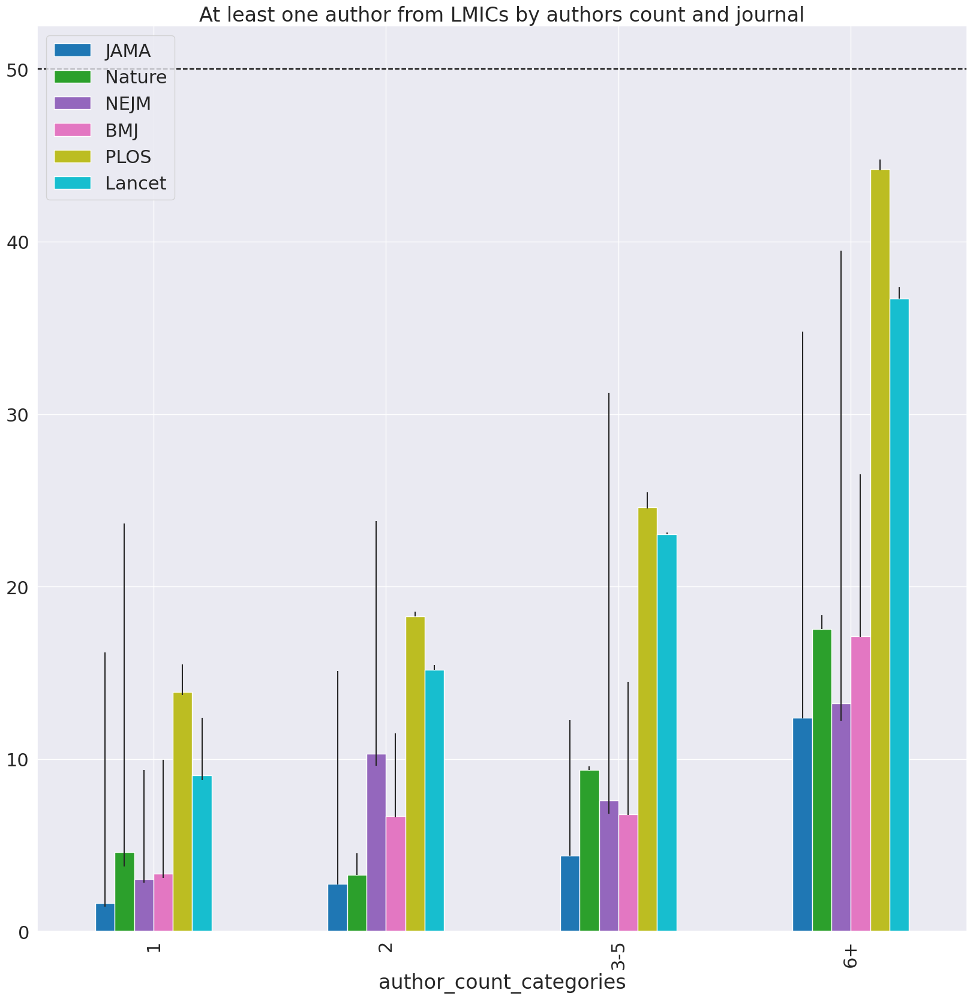

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s7.plot.bar(yerr=asy_err,cmap='tab10',ax=plt.gca())
plt.axhline(y=50,linestyle='--',color='black')
plt.legend(loc='upper left')
plt.title('At least one author from LMICs by authors count and journal')

Comment from Marie: Same pattern. Same comment. I would actually make the limit on the y-axis 55% so as to add a horizontal dashed line representing 50%. That way, we will make it clear to the reader that the proportion of papers with at least one author from a LMIC is strictly below 50%, across journals and irrespective of the number of authors per paper.

# optimistic gender distribution when first author is from LMICs

In [ ]:
gender_fir_lmic=df1_final.replace({True:'LMICs',False:'HICs'}).groupby(['first_lmic_pes','author_count_categories','journal.title'])['pct_female_optimistic'].mean().to_frame()
gender_fir_lmic

pct_female_optimistic
first_lmic_pes author_count_categories journal.title                       
HICs           1                       BMJ                         0.483486
                                       JAMA                        0.336862
                                       Lancet                      0.298913
                                       NEJM                        0.277577
                                       Nature                      0.526882
                                       PLOS                        0.280543
               2                       BMJ                         0.354491
                                       JAMA                        0.338615
                                       Lancet                      0.333872
                                       NEJM                        0.318313
                                       Nature                      0.352817
                                       PLOS                        0.376506
               3-5                     BMJ                         0.375103
                                       JAMA                        0.372351
                                       Lancet                      0.378185
                                       NEJM                        0.323585
                                       Nature                      0.365275
                                       PLOS                        0.435572
               6+                      BMJ                         0.420849
                                       JAMA                        0.434129
                                       Lancet                      0.412027
                                       NEJM                        0.386470
                                       Nature                      0.403296
                                       PLOS                        0.461346
LMICs          1                       BMJ                         0.693215
                                       JAMA                        0.245614
                                       Lancet                      0.372928
                                       NEJM                        0.252747
                                       Nature                      0.631579
                                       PLOS                        0.296296
               2                       BMJ                         0.534483
                                       JAMA                        0.403614
                                       Lancet                      0.420113
                                       NEJM                        0.402613
                                       Nature                      0.450000
                                       PLOS                        0.450000
               3-5                     BMJ                         0.439638
                                       JAMA                        0.430420
                                       Lancet                      0.445266
                                       NEJM                        0.395852
                                       Nature                      0.496528
                                       PLOS                        0.398333
               6+                      BMJ                         0.514033
                                       JAMA                        0.455643
                                       Lancet                      0.475101
                                       NEJM                        0.468873
                                       Nature                      0.478281
                                       PLOS                        0.481189

In [ ]:
s10=gender_fir_lmic.loc['LMICs'].pivot_table(index='author_count_categories',columns='journal.title',values='pct_female_optimistic')
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
author_count_categories,,,,,,
1,0.693215,0.245614,0.372928,0.252747,0.631579,0.296296
2,0.534483,0.403614,0.420113,0.402613,0.450000,0.450000
3-5,0.439638,0.430420,0.445266,0.395852,0.496528,0.398333
6+,0.514033,0.455643,0.475101,0.468873,0.478281,0.481189


Text(0.5, 1.0, 'LMIC_gender')

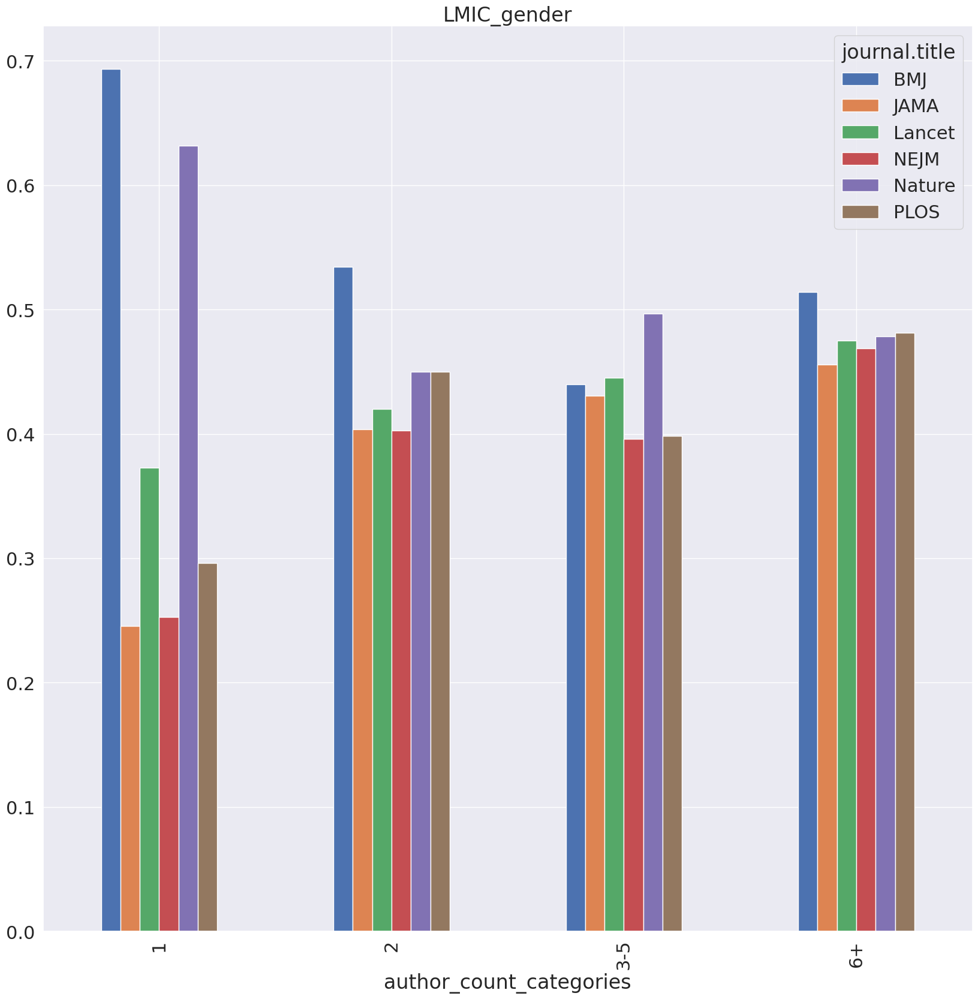

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10.plot.bar(ax=plt.gca())
plt.title('LMIC_gender')

In [ ]:
s11=gender_fir_lmic.loc['HICs'].pivot_table(index='author_count_categories',columns='journal.title',values='pct_female_optimistic')
s11

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
author_count_categories,,,,,,
1,0.483486,0.336862,0.298913,0.277577,0.526882,0.280543
2,0.354491,0.338615,0.333872,0.318313,0.352817,0.376506
3-5,0.375103,0.372351,0.378185,0.323585,0.365275,0.435572
6+,0.420849,0.434129,0.412027,0.386470,0.403296,0.461346


Text(0.5, 1.0, 'hig_income_gender')

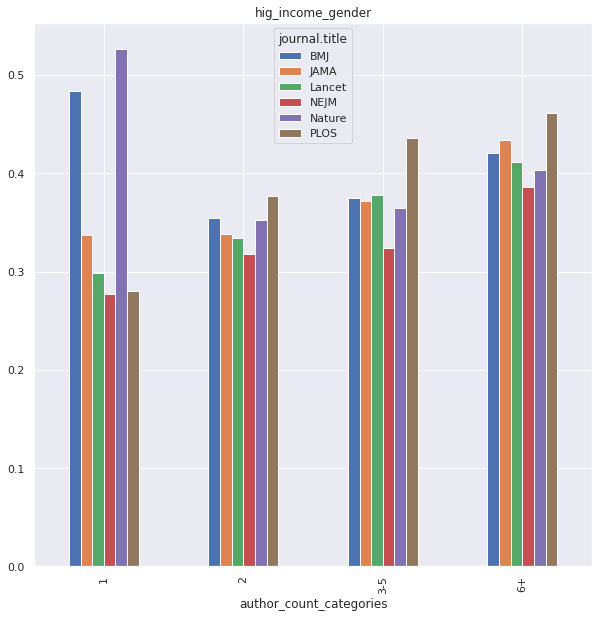

In [ ]:
sns.set(font_scale=1)
s11.plot.bar(figsize=(10,10))
plt.title('hig_income_gender')

#% female first authors mapped based on first author

In [ ]:
fem_first_inc=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['first_lmic_pes','journal.title'])[['female_first_pessimistic','female_first_real','female_first_optimistic']].mean()
fem_first_inc=fem_first_inc.loc[[('LMICs','NEJM'),('LMICs','JAMA'),('LMICs','Lancet'),('LMICs','BMJ'),('LMICs','PLOS'),('LMICs','Nature'),
                                 ('HICs','NEJM'),('HICs','JAMA'),('HICs','Lancet'),('HICs','BMJ'),('HICs','PLOS'),('HICs','Nature')],:]
fem_first_inc

female_first_pessimistic  female_first_real  \
first_lmic_pes journal.title                                                
LMICs          NEJM                           0.235908           0.287532   
               JAMA                           0.258687           0.310185   
               Lancet                         0.285552           0.345492   
               BMJ                            0.312500           0.386905   
               PLOS                           0.274194           0.333333   
               Nature                         0.303571           0.392308   
HICs           NEJM                           0.246812           0.262698   
               JAMA                           0.319798           0.346428   
               Lancet                         0.311195           0.339343   
               BMJ                            0.344107           0.367462   
               PLOS                           0.418569           0.457952   
               Nature                         0.322338           0.357609   

                              female_first_optimistic  
first_lmic_pes journal.title                           
LMICs          NEJM                          0.415449  
               JAMA                          0.424710  
               Lancet                        0.459044  
               BMJ                           0.504808  
               PLOS                          0.451613  
               Nature                        0.529762  
HICs           NEJM                          0.307284  
               JAMA                          0.396668  
               Lancet                        0.394144  
               BMJ                           0.407666  
               PLOS                          0.504566  
               Nature                        0.420967

In [ ]:
fem_first_inc['lower']=fem_first_inc['female_first_real']-fem_first_inc['female_first_pessimistic']
fem_first_inc['upper']=fem_first_inc['female_first_optimistic']-fem_first_inc['female_first_real']
fem_first_inc

female_first_pessimistic  female_first_real  \
first_lmic_pes journal.title                                                
LMICs          NEJM                           0.235908           0.287532   
               JAMA                           0.258687           0.310185   
               Lancet                         0.285552           0.345492   
               BMJ                            0.312500           0.386905   
               PLOS                           0.274194           0.333333   
               Nature                         0.303571           0.392308   
HICs           NEJM                           0.246812           0.262698   
               JAMA                           0.319798           0.346428   
               Lancet                         0.311195           0.339343   
               BMJ                            0.344107           0.367462   
               PLOS                           0.418569           0.457952   
               Nature                         0.322338           0.357609   

                              female_first_optimistic     lower     upper  
first_lmic_pes journal.title                                               
LMICs          NEJM                          0.415449  0.051624  0.127917  
               JAMA                          0.424710  0.051498  0.114525  
               Lancet                        0.459044  0.059940  0.113552  
               BMJ                           0.504808  0.074405  0.117903  
               PLOS                          0.451613  0.059140  0.118280  
               Nature                        0.529762  0.088736  0.137454  
HICs           NEJM                          0.307284  0.015886  0.044586  
               JAMA                          0.396668  0.026630  0.050240  
               Lancet                        0.394144  0.028148  0.054800  
               BMJ                           0.407666  0.023355  0.040203  
               PLOS                          0.504566  0.039382  0.046615  
               Nature                        0.420967  0.035270  0.063358

In [ ]:
fem_first_inc_c=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['first_lmic_pes','journal.title'])['female_first_optimistic'].value_counts().to_frame()
fem_first_inc_c

female_first_optimistic
first_lmic_pes journal.title female_first_optimistic                         
HICs           BMJ           0.0                                         4930
                             1.0                                         3393
               JAMA          0.0                                         4309
                             1.0                                         2833
               Lancet        0.0                                         6559
                             1.0                                         4267
               NEJM          0.0                                         5487
                             1.0                                         2434
               Nature        0.0                                         1773
                             1.0                                         1289
               PLOS          1.0                                         1326
                             0.0                                         1302
LMICs          BMJ           1.0                                          210
                             0.0                                          206
               JAMA          0.0                                          149
                             1.0                                          110
               Lancet        0.0                                          951
                             1.0                                          807
               NEJM          0.0                                          280
                             1.0                                          199
               Nature        1.0                                           89
                             0.0                                           79
               PLOS          0.0                                          204
                             1.0                                          168

In [ ]:
s10=fem_first_inc.pivot_table(index='first_lmic_pes',columns='journal.title',values='female_first_real')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
first_lmic_pes,,,,,,
LMICs,0.386905,0.310185,0.345492,0.287532,0.392308,0.333333
HICs,0.367462,0.346428,0.339343,0.262698,0.357609,0.457952


In [ ]:
asy_err=np.split(fem_first_inc[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[0.05162366, 0.12791705],
       [0.05149793, 0.11452524],
       [0.05994032, 0.11355228],
       [0.07440476, 0.11790293],
       [0.05913978, 0.11827957],
       [0.08873626, 0.13745421]]), array([[0.01588593, 0.04458623],
       [0.02662965, 0.05023957],
       [0.028148  , 0.05480046],
       [0.02335546, 0.04020335],
       [0.03938245, 0.0466145 ],
       [0.03527035, 0.06335799]])]


In [ ]:
#asy_err[0]=np.insert(asy_err[0],1,[np.nan,np.nan],axis=0)
#asy_err[1]=np.insert(asy_err[1],1,[np.nan,np.nan],axis=0)


#asy_err

In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[0.05162366, 0.01588593],
        [0.12791705, 0.04458623]],

       [[0.05149793, 0.02662965],
        [0.11452524, 0.05023957]],

       [[0.05994032, 0.028148  ],
        [0.11355228, 0.05480046]],

       [[0.07440476, 0.02335546],
        [0.11790293, 0.04020335]],

       [[0.05913978, 0.03938245],
        [0.11827957, 0.0466145 ]],

       [[0.08873626, 0.03527035],
        [0.13745421, 0.06335799]]])

Text(0.5, 1.0, "% articles mapped based on first authors' country with a female first author")

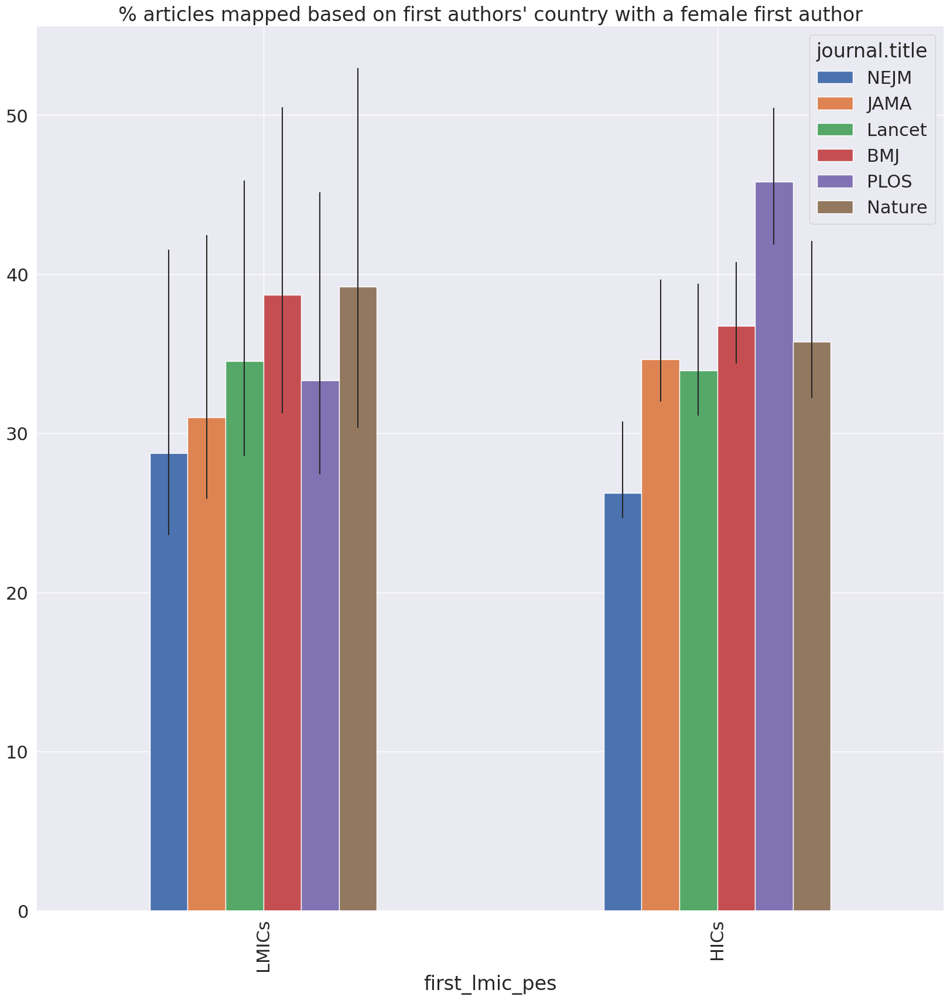

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10=s10.loc[:,['NEJM','JAMA','Lancet','BMJ','PLOS','Nature']].multiply(100)
s10.plot.bar(yerr=asy_err*100,ax=plt.gca())

plt.title("% articles mapped based on first authors' country with a female first author")

Comment from Marie: We may be under-powered to stratify using 4 categories. What about using 2 categories instead? LMIC vs high income? The pattern seems clear for high income countries: NEJM rarely publishes articles where the first author is a woman. I would re-order the bars to make it obvious (NEJM being the first). 

#number of articles with first author from lmic,hic

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]

In [ ]:
auth_first_inc=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['first_lmic_pes'])['journal.title'].value_counts().to_frame()
auth_first_inc.rename(columns={'journal.title':'counts'},inplace=True)
auth_first_inc

counts
first_lmic_pes journal.title        
HICs           Lancet          10826
               BMJ              8323
               NEJM             7921
               JAMA             7142
               Nature           3062
               PLOS             2628
LMICs          Lancet           1758
               NEJM              479
               BMJ               416
               PLOS              372
               JAMA              259
               Nature            168

In [ ]:
s10=auth_first_inc.pivot_table(index='first_lmic_pes',columns='journal.title',values='counts')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
first_lmic_pes,,,,,,
LMICs,416,259,1758,479,168,372
HICs,8323,7142,10826,7921,3062,2628


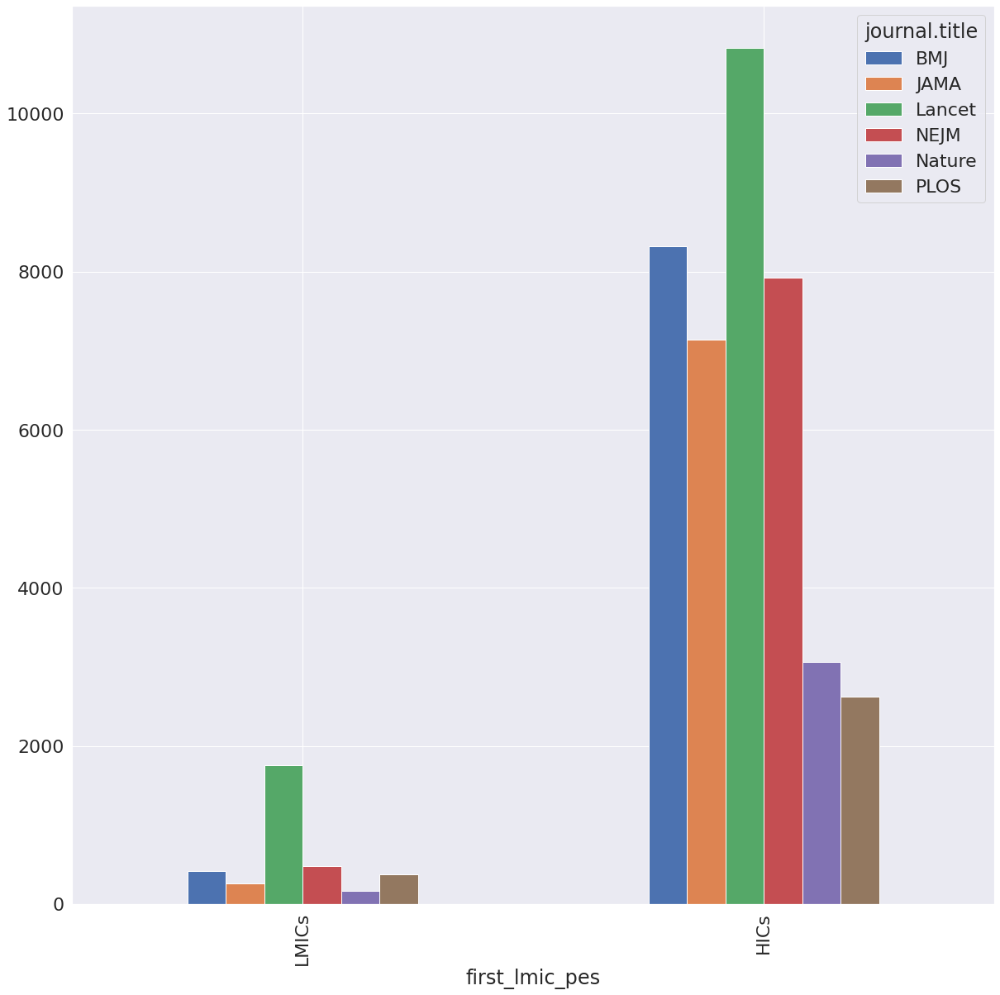

In [ ]:
fig=plt.figure(figsize=(20,20))
sns.set(font_scale=2)
s10.plot.bar(ax=plt.gca())

Comment from Marie: I would do two groups, i.e., LMIC and high income. Then, you can have a barplot.

#% female last author mapped based on first author's country

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]

In [ ]:
fem_first_inc=df1_more2.replace({False:'HICs',True:'LMICs'}).groupby(['first_lmic_pes','journal.title'])[['female_last_pessimistic','female_last_real','female_last_optimistic']].mean()
fem_first_inc=fem_first_inc.loc[['LMICs','HICs'],:]
fem_first_inc

female_last_pessimistic  female_last_real  \
first_lmic_pes journal.title                                              
LMICs          BMJ                           0.230769          0.275072   
               JAMA                          0.223938          0.276190   
               Lancet                        0.220137          0.277022   
               NEJM                          0.192067          0.224390   
               Nature                        0.214286          0.274809   
               PLOS                          0.225806          0.260062   
HICs           BMJ                           0.273099          0.287104   
               JAMA                          0.236488          0.262798   
               Lancet                        0.217439          0.259108   
               NEJM                          0.210958          0.222770   
               Nature                        0.181907          0.196403   
               PLOS                          0.290335          0.310163   

                              female_last_optimistic  
first_lmic_pes journal.title                          
LMICs          BMJ                          0.391827  
               JAMA                         0.413127  
               Lancet                       0.425484  
               NEJM                         0.336117  
               Nature                       0.434524  
               PLOS                         0.357527  
HICs           BMJ                          0.321879  
               JAMA                         0.336600  
               Lancet                       0.378256  
               NEJM                         0.263982  
               Nature                       0.255715  
               PLOS                         0.354262

In [ ]:
fem_first_inc['lower']=fem_first_inc['female_last_real']-fem_first_inc['female_last_pessimistic']
fem_first_inc['upper']=fem_first_inc['female_last_optimistic']-fem_first_inc['female_last_real']
fem_first_inc

female_last_pessimistic  female_last_real  \
first_lmic_pes journal.title                                              
LMICs          BMJ                           0.230769          0.275072   
               JAMA                          0.223938          0.276190   
               Lancet                        0.220137          0.277022   
               NEJM                          0.192067          0.224390   
               Nature                        0.214286          0.274809   
               PLOS                          0.225806          0.260062   
HICs           BMJ                           0.273099          0.287104   
               JAMA                          0.236488          0.262798   
               Lancet                        0.217439          0.259108   
               NEJM                          0.210958          0.222770   
               Nature                        0.181907          0.196403   
               PLOS                          0.290335          0.310163   

                              female_last_optimistic     lower     upper  
first_lmic_pes journal.title                                              
LMICs          BMJ                          0.391827  0.044302  0.116755  
               JAMA                         0.413127  0.052252  0.136937  
               Lancet                       0.425484  0.056886  0.148461  
               NEJM                         0.336117  0.032323  0.111727  
               Nature                       0.434524  0.060523  0.159715  
               PLOS                         0.357527  0.034255  0.097465  
HICs           BMJ                          0.321879  0.014005  0.034775  
               JAMA                         0.336600  0.026309  0.073803  
               Lancet                       0.378256  0.041669  0.119148  
               NEJM                         0.263982  0.011812  0.041212  
               Nature                       0.255715  0.014496  0.059312  
               PLOS                         0.354262  0.019828  0.044099

In [ ]:
fem_first_inc_c=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['first_lmic_pes','journal.title'])['female_last_optimistic'].value_counts().to_frame()
fem_first_inc_c

female_last_optimistic
first_lmic_pes journal.title female_last_optimistic                        
HICs           BMJ           0.0                                       5644
                             1.0                                       2679
               JAMA          0.0                                       4738
                             1.0                                       2404
               Lancet        0.0                                       6731
                             1.0                                       4095
               NEJM          0.0                                       5830
                             1.0                                       2091
               Nature        0.0                                       2279
                             1.0                                        783
               PLOS          0.0                                       1697
                             1.0                                        931
LMICs          BMJ           0.0                                        253
                             1.0                                        163
               JAMA          0.0                                        152
                             1.0                                        107
               Lancet        0.0                                       1010
                             1.0                                        748
               NEJM          0.0                                        318
                             1.0                                        161
               Nature        0.0                                         95
                             1.0                                         73
               PLOS          0.0                                        239
                             1.0                                        133

In [ ]:
s10=fem_first_inc.pivot_table(index='first_lmic_pes',columns='journal.title',values='female_last_real')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
first_lmic_pes,,,,,,
LMICs,0.275072,0.276190,0.277022,0.22439,0.274809,0.260062
HICs,0.287104,0.262798,0.259108,0.22277,0.196403,0.310163


In [ ]:
asy_err=np.split(fem_first_inc[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[0.0443024 , 0.11675529],
       [0.05225225, 0.13693694],
       [0.05688567, 0.14846131],
       [0.03232344, 0.11172667],
       [0.06052345, 0.15971465],
       [0.03425547, 0.09746496]]), array([[0.01400506, 0.03477543],
       [0.02630919, 0.07380282],
       [0.04166892, 0.11914763],
       [0.01181208, 0.04121152],
       [0.01449613, 0.05931183],
       [0.01982775, 0.04409919]])]


In [ ]:
#asy_err[0]=np.insert(asy_err[0],1,[np.nan,np.nan],axis=0)
#asy_err[1]=np.insert(asy_err[1],1,[np.nan,np.nan],axis=0)


#asy_err

In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

Text(0.5, 1.0, 'hig_income_gender')

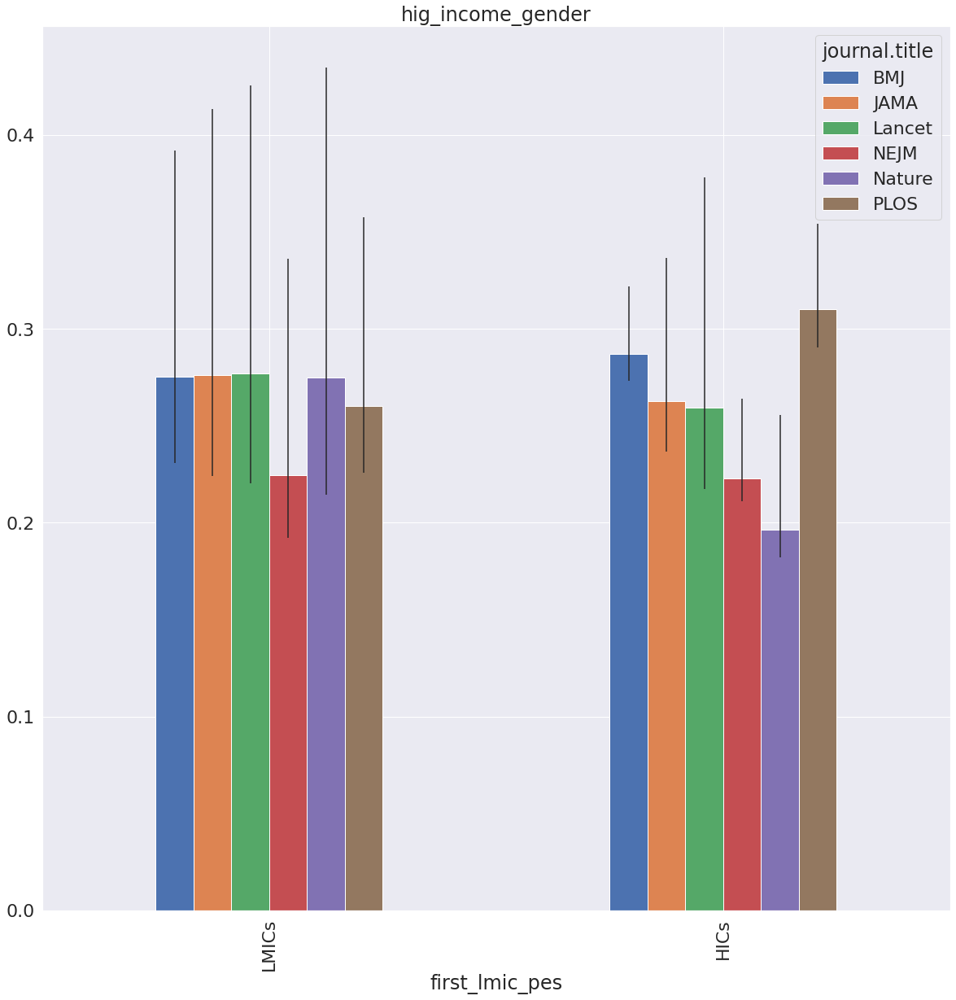

In [ ]:
fig=plt.figure(figsize=(20,20))
sns.set(font_scale=2)
s10.plot.bar(yerr=asy_err,ax=plt.gca())
plt.title('hig_income_gender')

Comment from Marie: Again, I would include only two groups. The pattern seems clear for high income countries, with a clear separation between Nature Medicine and NEJM vs PLOS Medicine and the BMJ.

#%first female author mapped based on last author's country

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]

In [ ]:
fem_first_inc=df1_more2.replace({False:'HICs',True:'LMICs'}).groupby(['last_lmic_pes','journal.title'])[['female_first_pessimistic','female_first_real','female_first_optimistic']].mean()
fem_first_inc=fem_first_inc.loc[['LMICs','HICs'],:]
fem_first_inc

female_first_pessimistic  female_first_real  \
last_lmic_pes journal.title                                                
LMICs         BMJ                            0.288184           0.348432   
              JAMA                           0.263889           0.308108   
              Lancet                         0.312195           0.369942   
              NEJM                           0.251701           0.306630   
              Nature                         0.352201           0.424242   
              PLOS                           0.354651           0.403974   
HICs          BMJ                            0.344852           0.368991   
              JAMA                           0.319276           0.346316   
              Lancet                         0.306926           0.336001   
              NEJM                           0.245885           0.261876   
              Nature                         0.319766           0.356055   
              PLOS                           0.406627           0.448878   

                             female_first_optimistic  
last_lmic_pes journal.title                           
LMICs         BMJ                           0.461095  
              JAMA                          0.407407  
              Lancet                        0.468293  
              NEJM                          0.430839  
              Nature                        0.522013  
              PLOS                          0.476744  
HICs          BMJ                           0.410272  
              JAMA                          0.397356  
              Lancet                        0.393458  
              NEJM                          0.306948  
              Nature                        0.421687  
              PLOS                          0.500753

In [ ]:
fem_first_inc['lower']=fem_first_inc['female_first_real']-fem_first_inc['female_first_pessimistic']
fem_first_inc['upper']=fem_first_inc['female_first_optimistic']-fem_first_inc['female_first_real']
fem_first_inc

female_first_pessimistic  female_first_real  \
last_lmic_pes journal.title                                                
LMICs         BMJ                            0.288184           0.348432   
              JAMA                           0.263889           0.308108   
              Lancet                         0.312195           0.369942   
              NEJM                           0.251701           0.306630   
              Nature                         0.352201           0.424242   
              PLOS                           0.354651           0.403974   
HICs          BMJ                            0.344852           0.368991   
              JAMA                           0.319276           0.346316   
              Lancet                         0.306926           0.336001   
              NEJM                           0.245885           0.261876   
              Nature                         0.319766           0.356055   
              PLOS                           0.406627           0.448878   

                             female_first_optimistic     lower     upper  
last_lmic_pes journal.title                                               
LMICs         BMJ                           0.461095  0.060248  0.112663  
              JAMA                          0.407407  0.044219  0.099299  
              Lancet                        0.468293  0.057747  0.098350  
              NEJM                          0.430839  0.054929  0.124209  
              Nature                        0.522013  0.072041  0.097770  
              PLOS                          0.476744  0.049322  0.072771  
HICs          BMJ                           0.410272  0.024139  0.041280  
              JAMA                          0.397356  0.027040  0.051039  
              Lancet                        0.393458  0.029075  0.057457  
              NEJM                          0.306948  0.015991  0.045072  
              Nature                        0.421687  0.036290  0.065632  
              PLOS                          0.500753  0.042251  0.051875

In [ ]:
fem_first_inc_c=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['last_lmic_pes','journal.title'])['female_first_optimistic'].value_counts().to_frame()
fem_first_inc_c

female_first_optimistic
last_lmic_pes journal.title female_first_optimistic                         
HICs          BMJ           0.0                                         4949
                            1.0                                         3443
              JAMA          0.0                                         4330
                            1.0                                         2855
              Lancet        0.0                                         6638
                            1.0                                         4306
              NEJM          0.0                                         5516
                            1.0                                         2443
              Nature        0.0                                         1776
                            1.0                                         1295
              PLOS          1.0                                         1330
                            0.0                                         1326
LMICs         BMJ           0.0                                          187
                            1.0                                          160
              JAMA          0.0                                          128
                            1.0                                           88
              Lancet        0.0                                          872
                            1.0                                          768
              NEJM          0.0                                          251
                            1.0                                          190
              Nature        1.0                                           83
                            0.0                                           76
              PLOS          0.0                                          180
                            1.0                                          164

In [ ]:
s10=fem_first_inc.pivot_table(index='last_lmic_pes',columns='journal.title',values='female_first_real')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
last_lmic_pes,,,,,,
LMICs,0.348432,0.308108,0.369942,0.306630,0.424242,0.403974
HICs,0.368991,0.346316,0.336001,0.261876,0.356055,0.448878


In [ ]:
asy_err=np.split(fem_first_inc[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[0.06024762, 0.11266305],
       [0.04421922, 0.0992993 ],
       [0.05774707, 0.09835049],
       [0.05492915, 0.12420917],
       [0.07204117, 0.09777015],
       [0.04932235, 0.07277068]]), array([[0.02413922, 0.04128023],
       [0.02704016, 0.05103918],
       [0.02907463, 0.0574568 ],
       [0.01599093, 0.04507202],
       [0.03628956, 0.06563163],
       [0.0422513 , 0.05187521]])]


In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[0.06024762, 0.02413922],
        [0.11266305, 0.04128023]],

       [[0.04421922, 0.02704016],
        [0.0992993 , 0.05103918]],

       [[0.05774707, 0.02907463],
        [0.09835049, 0.0574568 ]],

       [[0.05492915, 0.01599093],
        [0.12420917, 0.04507202]],

       [[0.07204117, 0.03628956],
        [0.09777015, 0.06563163]],

       [[0.04932235, 0.0422513 ],
        [0.07277068, 0.05187521]]])

Text(0.5, 1.0, 'hig_income_gender')

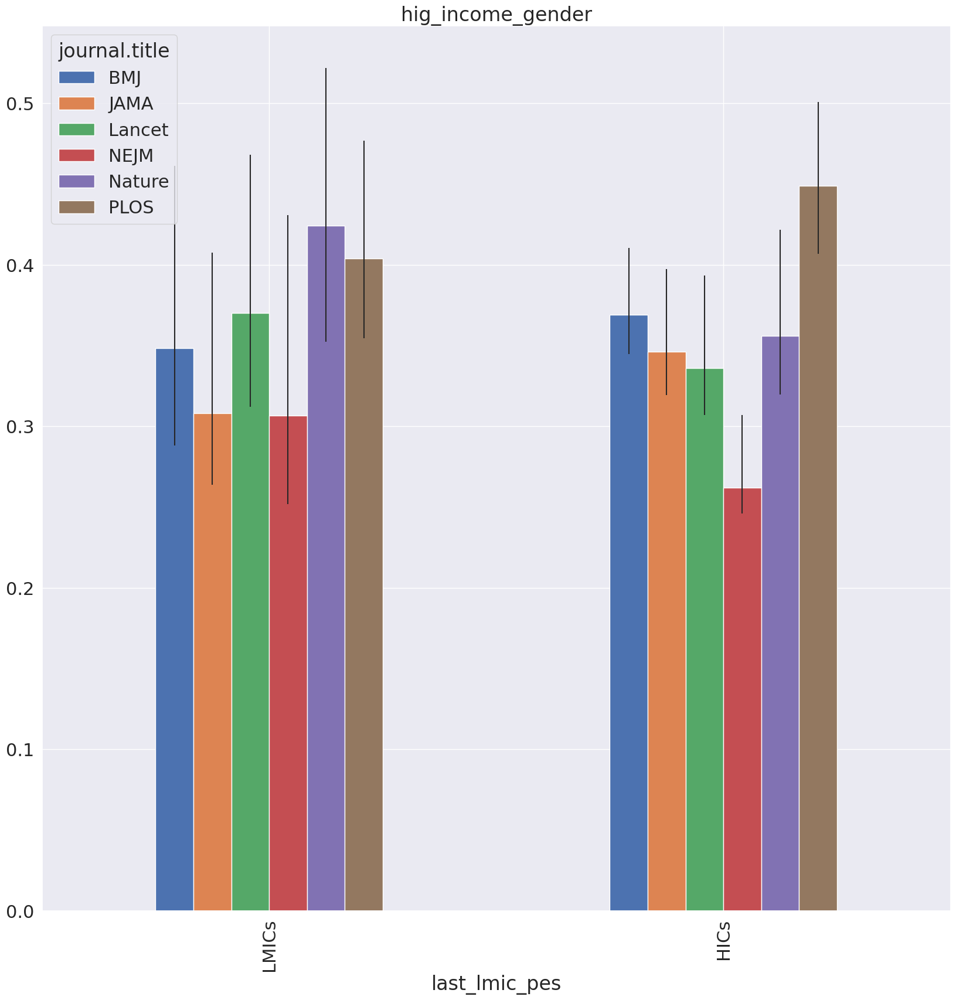

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10.plot.bar(yerr=asy_err,ax=plt.gca())
plt.title('hig_income_gender')

Comment from Marie: The separation for high income countries is even clearer when the outcome is based on the last author. The proportion among papers published in NEJM is much lower than that of Nature Medicine, the BMJ, the Lancet, JAMA, and PLOS Medicine.

#number of last authors from lmics,hics

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]

In [ ]:
auth_last_inc=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['last_lmic_pes'])['journal.title'].value_counts().to_frame()
auth_last_inc.rename(columns={'journal.title':'counts'},inplace=True)
auth_last_inc

counts
last_lmic_pes journal.title        
HICs          Lancet          10944
              BMJ              8392
              NEJM             7959
              JAMA             7185
              Nature           3071
              PLOS             2656
LMICs         Lancet           1640
              NEJM              441
              BMJ               347
              PLOS              344
              JAMA              216
              Nature            159

In [ ]:
s10=auth_last_inc.pivot_table(index='last_lmic_pes',columns='journal.title',values='counts')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
last_lmic_pes,,,,,,
LMICs,347,216,1640,441,159,344
HICs,8392,7185,10944,7959,3071,2656


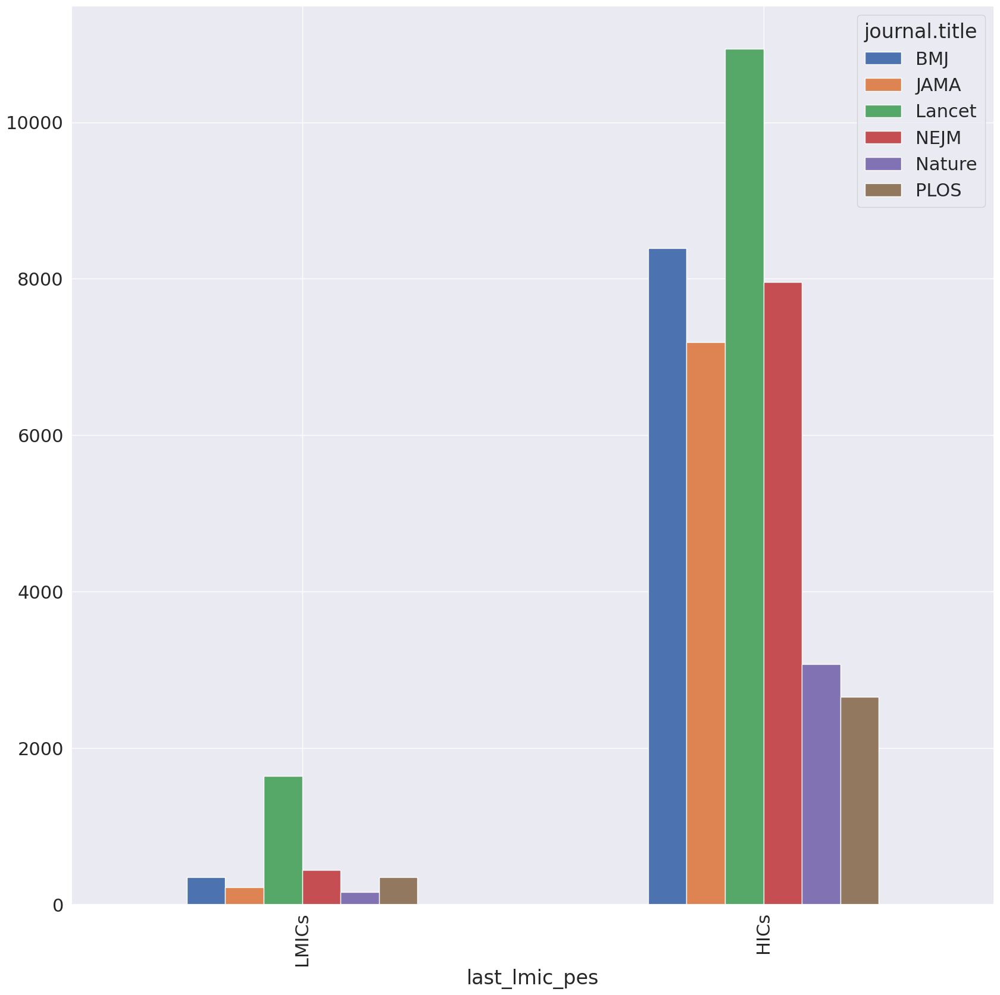

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10.plot.bar(ax=plt.gca())

# %last female author mapped based on last author's country

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>2,:]

In [ ]:
fem_first_inc=df1_more2.replace({False:'HICs',True:'LMICs'}).groupby(['last_lmic_pes','journal.title'])[['female_last_pessimistic','female_last_real','female_last_optimistic']].mean()
fem_first_inc=fem_first_inc.loc[['LMICs','HICs'],:]
fem_first_inc

female_last_pessimistic  female_last_real  \
last_lmic_pes journal.title                                              
LMICs         BMJ                           0.233429          0.290323   
              JAMA                          0.199074          0.259036   
              Lancet                        0.222561          0.286724   
              NEJM                          0.195011          0.229947   
              Nature                        0.201258          0.253968   
              PLOS                          0.212209          0.252595   
HICs          BMJ                           0.272641          0.286466   
              JAMA                          0.237161          0.263329   
              Lancet                        0.217105          0.258008   
              NEJM                          0.210705          0.222502   
              Nature                        0.182677          0.197466   
              PLOS                          0.291416          0.310345   

                             female_last_optimistic  
last_lmic_pes journal.title                          
LMICs         BMJ                          0.429395  
              JAMA                         0.430556  
              Lancet                       0.446341  
              NEJM                         0.346939  
              Nature                       0.408805  
              PLOS                         0.372093  
HICs          BMJ                          0.320901  
              JAMA                         0.336534  
              Lancet                       0.375640  
              NEJM                         0.263727  
              Nature                       0.257571  
              PLOS                         0.352410

In [ ]:
fem_first_inc['lower']=fem_first_inc['female_last_real']-fem_first_inc['female_last_pessimistic']
fem_first_inc['upper']=fem_first_inc['female_last_optimistic']-fem_first_inc['female_last_real']
fem_first_inc

female_last_pessimistic  female_last_real  \
last_lmic_pes journal.title                                              
LMICs         BMJ                           0.233429          0.290323   
              JAMA                          0.199074          0.259036   
              Lancet                        0.222561          0.286724   
              NEJM                          0.195011          0.229947   
              Nature                        0.201258          0.253968   
              PLOS                          0.212209          0.252595   
HICs          BMJ                           0.272641          0.286466   
              JAMA                          0.237161          0.263329   
              Lancet                        0.217105          0.258008   
              NEJM                          0.210705          0.222502   
              Nature                        0.182677          0.197466   
              PLOS                          0.291416          0.310345   

                             female_last_optimistic     lower     upper  
last_lmic_pes journal.title                                              
LMICs         BMJ                          0.429395  0.056893  0.139072  
              JAMA                         0.430556  0.059962  0.171519  
              Lancet                       0.446341  0.064163  0.159617  
              NEJM                         0.346939  0.034935  0.116992  
              Nature                       0.408805  0.052710  0.154837  
              PLOS                         0.372093  0.040386  0.119498  
HICs          BMJ                          0.320901  0.013825  0.034435  
              JAMA                         0.336534  0.026168  0.073206  
              Lancet                       0.375640  0.040903  0.117631  
              NEJM                         0.263727  0.011797  0.041224  
              Nature                       0.257571  0.014789  0.060105  
              PLOS                         0.352410  0.018929  0.042065

In [ ]:
fem_first_inc_c=df1_more2.replace({True:'LMICs',False:'HICs'}).groupby(['last_lmic_pes','journal.title'])['female_last_optimistic'].value_counts().to_frame()
fem_first_inc_c

female_last_optimistic
last_lmic_pes journal.title female_last_optimistic                        
HICs          BMJ           0.0                                       5699
                            1.0                                       2693
              JAMA          0.0                                       4767
                            1.0                                       2418
              Lancet        0.0                                       6833
                            1.0                                       4111
              NEJM          0.0                                       5860
                            1.0                                       2099
              Nature        0.0                                       2280
                            1.0                                        791
              PLOS          0.0                                       1720
                            1.0                                        936
LMICs         BMJ           0.0                                        198
                            1.0                                        149
              JAMA          0.0                                        123
                            1.0                                         93
              Lancet        0.0                                        908
                            1.0                                        732
              NEJM          0.0                                        288
                            1.0                                        153
              Nature        0.0                                         94
                            1.0                                         65
              PLOS          0.0                                        216
                            1.0                                        128

In [ ]:
s10=fem_first_inc.pivot_table(index='last_lmic_pes',columns='journal.title',values='female_last_real')
s10=s10.loc[['LMICs','HICs'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
last_lmic_pes,,,,,,
LMICs,0.290323,0.259036,0.286724,0.229947,0.253968,0.252595
HICs,0.286466,0.263329,0.258008,0.222502,0.197466,0.310345


In [ ]:
asy_err=np.split(fem_first_inc[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[0.05689319, 0.13907223],
       [0.05996207, 0.17151941],
       [0.0641633 , 0.15961719],
       [0.03493519, 0.11699225],
       [0.05271039, 0.15483678],
       [0.04038585, 0.11949787]]), array([[0.0138249 , 0.03443535],
       [0.02616795, 0.07320575],
       [0.04090321, 0.11763115],
       [0.01179746, 0.04122428],
       [0.01478903, 0.06010514],
       [0.01892916, 0.04206481]])]


In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[0.05689319, 0.0138249 ],
        [0.13907223, 0.03443535]],

       [[0.05996207, 0.02616795],
        [0.17151941, 0.07320575]],

       [[0.0641633 , 0.04090321],
        [0.15961719, 0.11763115]],

       [[0.03493519, 0.01179746],
        [0.11699225, 0.04122428]],

       [[0.05271039, 0.01478903],
        [0.15483678, 0.06010514]],

       [[0.04038585, 0.01892916],
        [0.11949787, 0.04206481]]])

Text(0.5, 1.0, 'hig_income_gender')

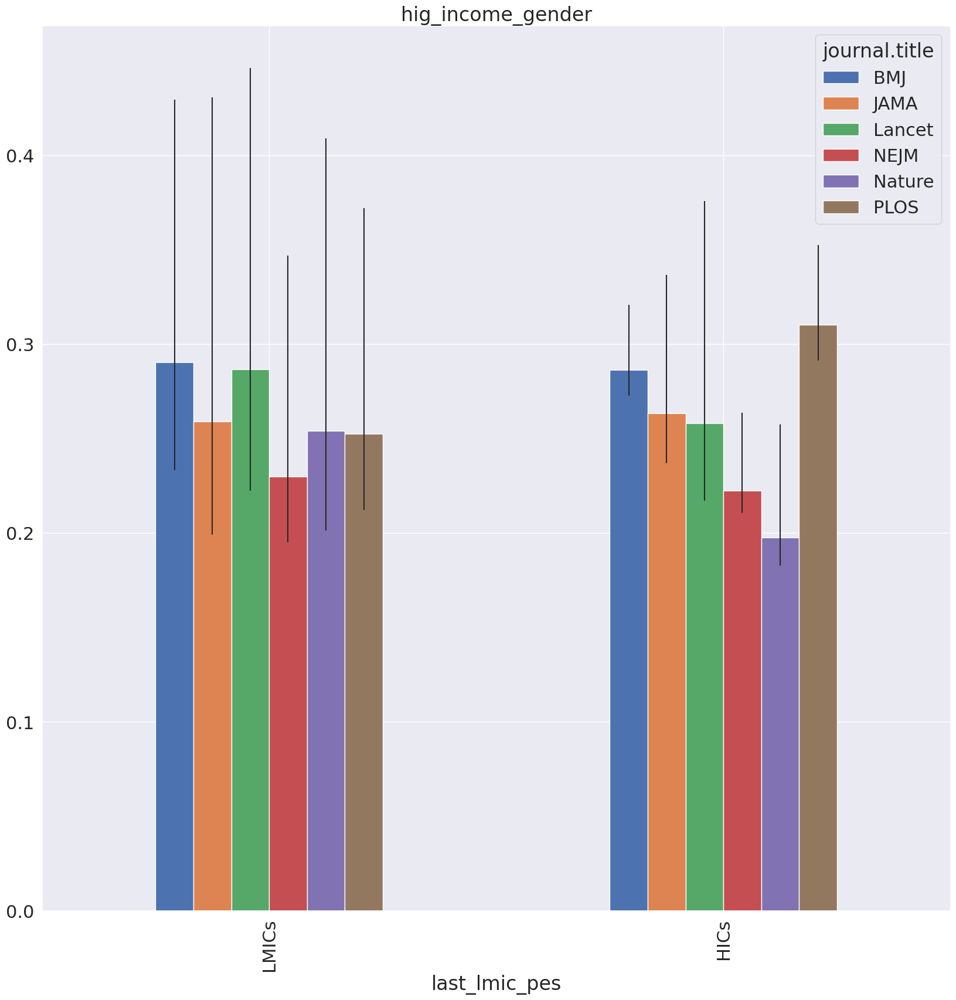

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10.plot.bar(yerr=asy_err,ax=plt.gca())
plt.title('hig_income_gender')

Comment from Marie: we seemed under-powered to stratify by low income, lower middle income, upper middle income. What about having only two groups: high income countries and LMICs? For now, there is one statistically significant finding among papers whose last author is from a high income country: the proportion of female last authors is much higher in the BMJ and PLOS Medicine than in Nature Medicine and NEJM.

Quick formatting remark: I would use a black and white background, multiply the y-axis by 100 and add "Proportion of papers with a female last author" as the y-axis label. For the x-axis: "Country of the last author" as the label? With "High income" and "LMIC" as the two categories?

1 – Overall LMICs percentage by journal
2 – Overall female percentage by journal
3 – First and last author from LMICs by journal
4 – First and last author female by journal
5 – One author LMICs vs more than one author LMICs
6 – All authors from LMICS by journal
7 – No authors from LMICs by journal
8 – Among papers with authors from LMICs, divided by LIC and MIC  this can be a map image afterwards (but lets keep it simple by now)
9 – All men by journal
10 – All women by Journal

Question: The Lancet --> does that include infectious diseases, global health?

Question: Could we add a bar plot with just the number of papers by journal?

#number of papers in each journal

In [ ]:
df1['journal.title'].value_counts()

BMJ       60447
Lancet    29432
JAMA      25375
NEJM      24200
Nature     6627
PLOS       3995
Name: journal.title, dtype: int64

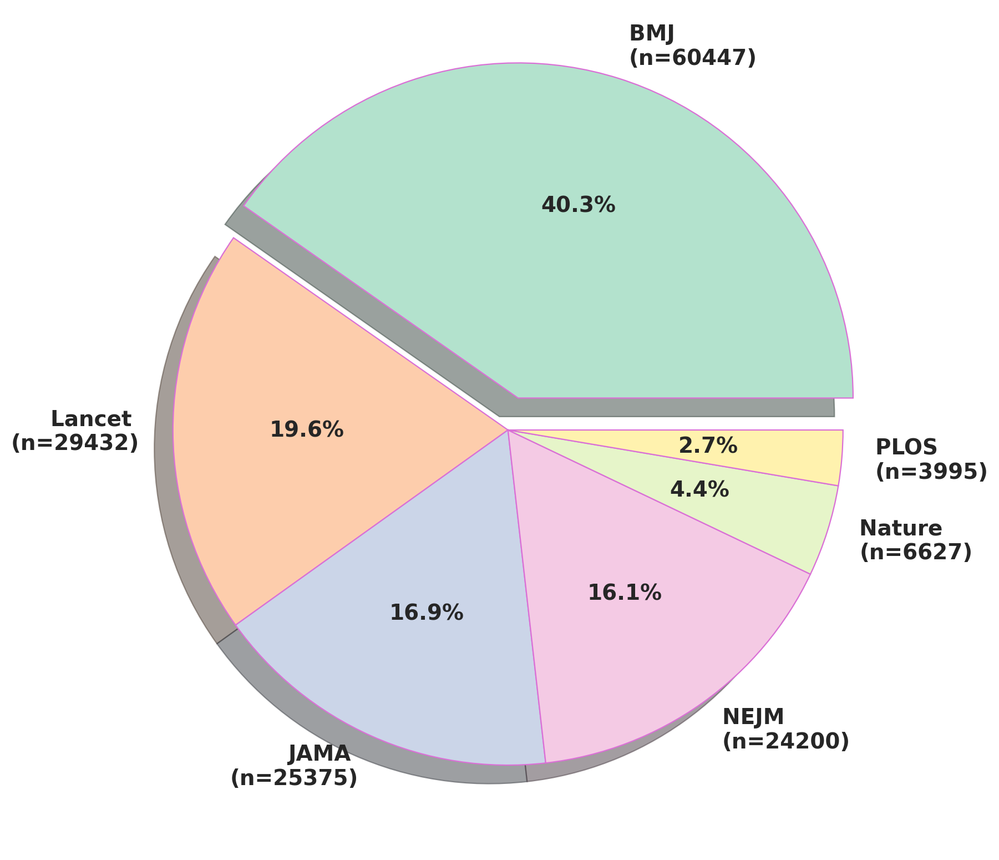

In [ ]:
sns.set_theme(style='darkgrid',palette='Pastel2')

list_of_labels=[i+f' \n(n={j})' for i,j in df1['journal.title'].value_counts().to_dict().items()]
count_array=df1['journal.title'].value_counts().to_dict().values()

wedge_props = {"linewidth": 0.8, "edgecolor": "orchid"}
text_props = {'fontsize':14,"weight": "bold"}

explode_par= len(list_of_labels)*[0]

explode_par[0]=0.1

fig=plt.figure(figsize=(10,10),dpi=200)


plt.pie(x=count_array,labels=list_of_labels,autopct='%1.1f%%' ,radius=1,textprops=text_props,
        wedgeprops=wedge_props,explode=explode_par,shadow=True)
plt.show()

#Overall LMICs  percentage by journal

Text(0.5, 1.0, 'plos medicine')

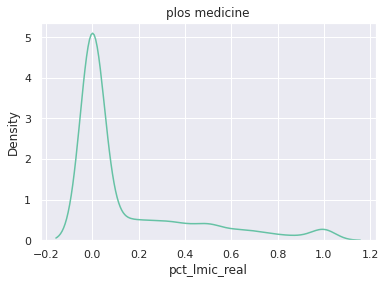

In [ ]:
sns.set(font_scale=1)
sns.set_theme(style='darkgrid',palette='Set2')
sns.kdeplot(data=df1_final.loc[df1_final['journal.title']=='PLOS',:],x='pct_lmic_real')
plt.title('plos medicine')

produce overestimated results if we use mean

what do you think?

following figure show results if we use mean

In [ ]:
df1_final.loc[df1_final['journal.title']=='PLOS','pct_lmic_real'].quantile(0.75)

0.23076923076923078

In [ ]:
lmic_per=df1_final.groupby('journal.title')[['pct_lmic_pes','pct_lmic_real','pct_lmic_opt']].mean()
lmic_per

,pct_lmic_pes,pct_lmic_real,pct_lmic_opt
journal.title,,,
BMJ,0.037120,0.039315,0.092573
JAMA,0.026415,0.028579,0.102892
Lancet,0.129540,0.130573,0.137302
NEJM,0.060761,0.068234,0.176029
Nature,0.047953,0.050645,0.102548
PLOS,0.153640,0.154416,0.159191


In [ ]:
lmic_per['lower']=lmic_per['pct_lmic_real']-lmic_per['pct_lmic_pes']
lmic_per['upper']=lmic_per['pct_lmic_opt']-lmic_per['pct_lmic_real']
lmic_per=lmic_per.sort_values(by='pct_lmic_real')*100

In [ ]:
lmic_per[['upper','lower']].T.values

array([[ 7.43129733,  5.32581027,  5.19035922, 10.77954904,  0.67287212,
         0.47748084],
       [ 0.21638487,  0.2194275 ,  0.26912768,  0.74729937,  0.10332249,
         0.077682  ]])

In [ ]:
df1_final.loc[df1_final['pct_lmic_real'].notna(),'journal.title'].value_counts()

BMJ       43779
Lancet    21710
NEJM      15122
JAMA      14618
Nature     5215
PLOS       3621
Name: journal.title, dtype: int64

Text(0.5, 1.0, 'Percentage of authors from LMICs in each journal')

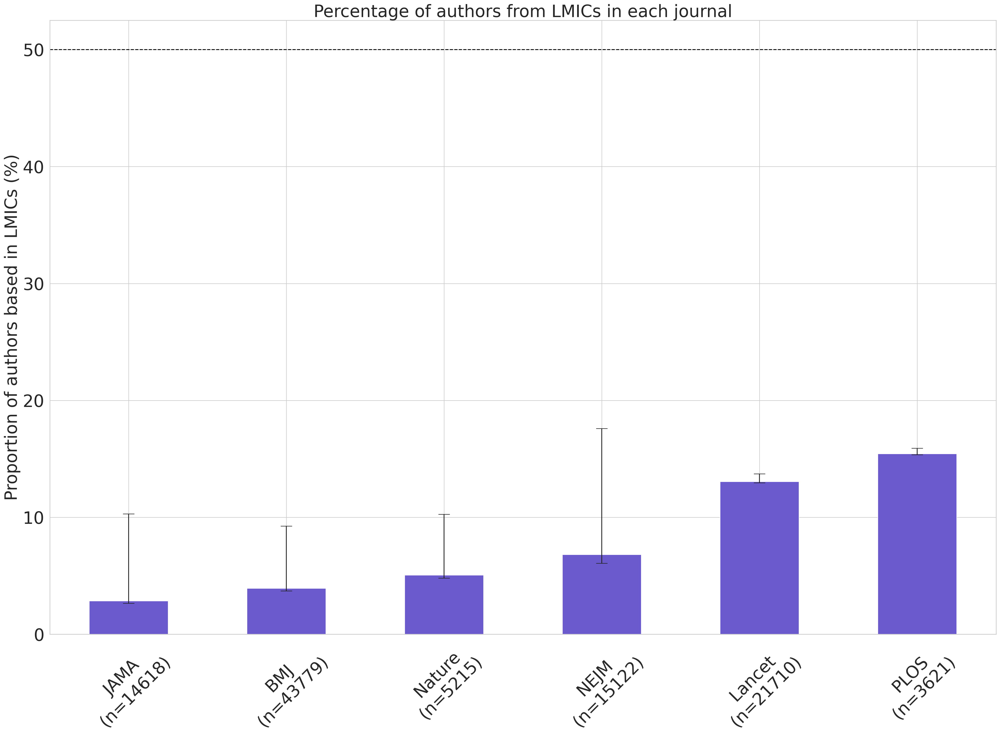

In [ ]:
fig=plt.figure(figsize=(30,20),dpi=200)
sns.set(font_scale=2)
sns.set_theme(style='whitegrid')

ax=lmic_per['pct_lmic_real'].plot(kind='bar',yerr=lmic_per[['lower','upper']].T.values,color='slateblue',ax=plt.gca(),rot=45,fontsize=30,capsize=10)
ax.axhline(y=50,linestyle='--',color='black')

ax.set_xticklabels(['JAMA\n(n=14618)','BMJ\n(n=43779)','Nature\n(n=5215)','NEJM\n(n=15122)','Lancet\n(n=21710)','PLOS\n(n=3621)'])

ax.set_xlabel('')
ax.set_ylabel('Proportion of authors based in LMICs (%)',fontsize=30)

plt.title('Percentage of authors from LMICs in each journal',fontsize=30)

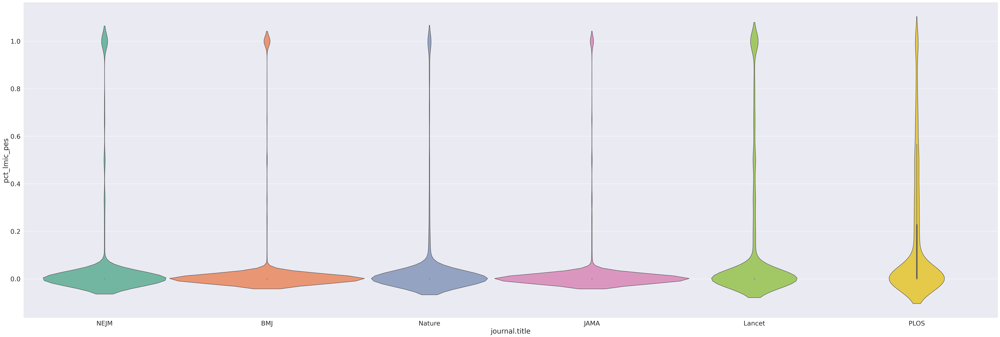

In [ ]:
fig=plt.figure(figsize=(60,20),dpi=200)
sns.set(font_scale=2)
ax=sns.violinplot(data=df1_final,x='journal.title',y='pct_lmic_pes',width=1.2,palette='Set2')

Text(0, 0.5, 'Proportion of authors affiliated in a LMIC')

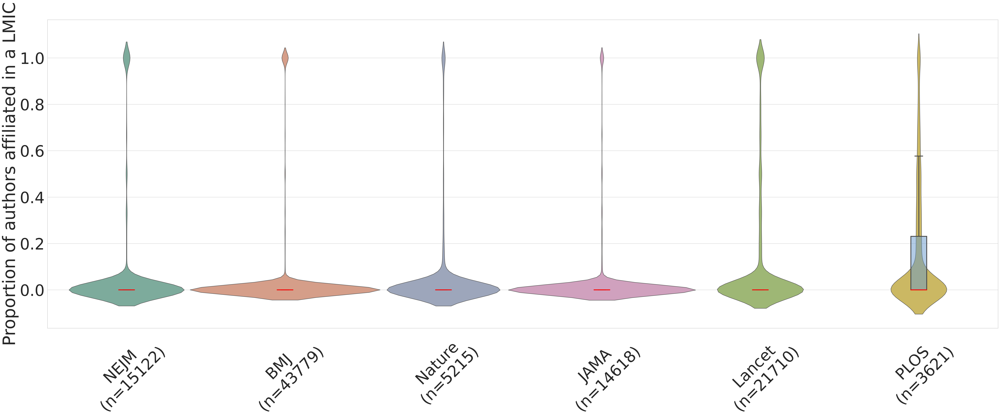

In [ ]:
fig=plt.figure(figsize=(60,20),dpi=200)


sns.set(font_scale=5,style='whitegrid')

ax=sns.violinplot(data=df1_final,x='journal.title',y='pct_lmic_real',width=1.2,palette='Set2',ax=plt.gca(),saturation=0.5,inner=None)

sns.boxplot(data=df1_final,x='journal.title',y='pct_lmic_real',width=0.1,ax=ax,
            boxprops={'zorder': 2,"facecolor": (.4, .6, .8, .5)},saturation=0.2,linewidth=3,
            medianprops={"color": "red"},showfliers=False)

ax.set_xlabel('')
ax.set_xticklabels(['NEJM\n(n=15122)','BMJ\n(n=43779)','Nature\n(n=5215)','JAMA\n(n=14618)','Lancet\n(n=21710)','PLOS\n(n=3621)'],rotation=45)

ax.set_ylabel('Proportion of authors affiliated in a LMIC',fontsize=60)

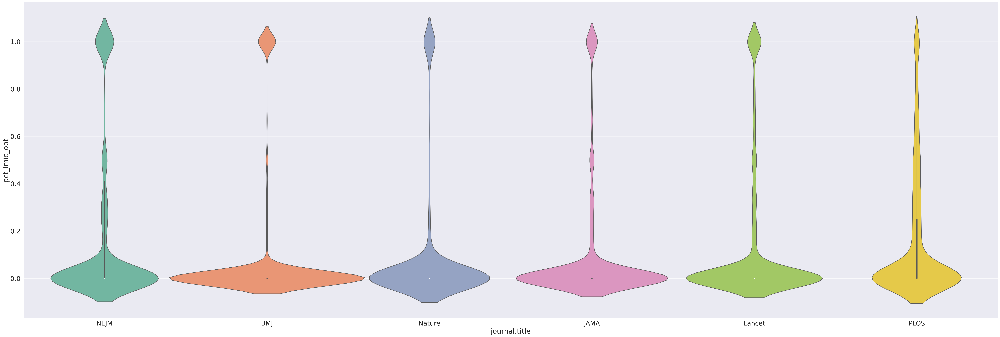

In [ ]:
fig=plt.figure(figsize=(60,20),dpi=200)
sns.set(font_scale=2)
sns.violinplot(data=df1_final,x='journal.title',y='pct_lmic_opt',width=1.2,palette='Set2')

#at least one author from LMIC by journal

In [ ]:
df1_final['journal.title'].value_counts()

BMJ       60447
Lancet    29432
JAMA      25375
NEJM      24200
Nature     6627
PLOS       3995
Name: journal.title, dtype: int64

In [ ]:
df1_final.loc[df1_final['at_least_one_lmic_pes']==1,'journal.title'].value_counts()

Lancet    4787
BMJ       2208
NEJM      1338
PLOS      1263
JAMA       719
Nature     608
Name: journal.title, dtype: int64

In [ ]:
df1_final['pct_lmic_pes'].isna().sum()

41440

In [ ]:
df1_final['at_least_one_lmic_pes'].isna().sum()

41440

In [ ]:
c_fl_1=pd.concat([df1_final.loc[(df1_final['pct_lmic_pes']>0),'journal.title'].value_counts().rename('c_pes'),
                df1_final.loc[(df1_final['pct_lmic_real']>0),'journal.title'].value_counts().rename('c_real'),
                df1_final.loc[(df1_final['pct_lmic_opt']>0) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_1

,c_pes,c_real,c_opt
Lancet,4787,4787,4989
BMJ,2208,2208,5309
NEJM,1338,1338,4269
PLOS,1263,1263,1292
JAMA,719,719,2791
Nature,608,608,934


In [ ]:
c_fl_1=c_fl_1.div(pd.concat([df1_final.loc[(df1_final['pct_lmic_pes'].notna()),'journal.title'].value_counts().rename('c_pes'),
                         df1_final.loc[(df1_final['pct_lmic_real'].notna()),'journal.title'].value_counts().rename('c_real'),
                         df1_final.loc[(df1_final['pct_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_1

,c_pes,c_real,c_opt
BMJ,0.048004,0.050435,0.115423
JAMA,0.047107,0.049186,0.182861
Lancet,0.219015,0.220497,0.228256
NEJM,0.081685,0.088480,0.260623
Nature,0.110445,0.116587,0.169664
PLOS,0.347455,0.348799,0.355433


In [ ]:
c_fl_1['lower']=c_fl_1['c_real']-c_fl_1['c_pes']
c_fl_1['upper']=c_fl_1['c_opt']-c_fl_1['c_real']

c_fl_1=c_fl_1.sort_values(by='c_real')*100
c_fl_1

,c_pes,c_real,c_opt,lower,upper
JAMA,4.710738,4.918594,18.286051,0.207855,13.367458
BMJ,4.800417,5.043514,11.542308,0.243097,6.498794
NEJM,8.168498,8.848036,26.062271,0.679538,17.214235
Nature,11.044505,11.658677,16.966394,0.614172,5.307717
Lancet,21.901450,22.049747,22.825639,0.148296,0.775893
PLOS,34.745530,34.879867,35.543329,0.134338,0.663461


In [ ]:
c_fl_1[['lower','upper']].T.values

array([[ 0.20785513,  0.24309659,  0.67953781,  0.6141719 ,  0.14829632,
         0.13433787],
       [13.36745772,  6.49879401, 17.21423509,  5.30771729,  0.77589272,
         0.66346131]])

Text(0.5, 1.0, 'At least one author from LMIC by journal')

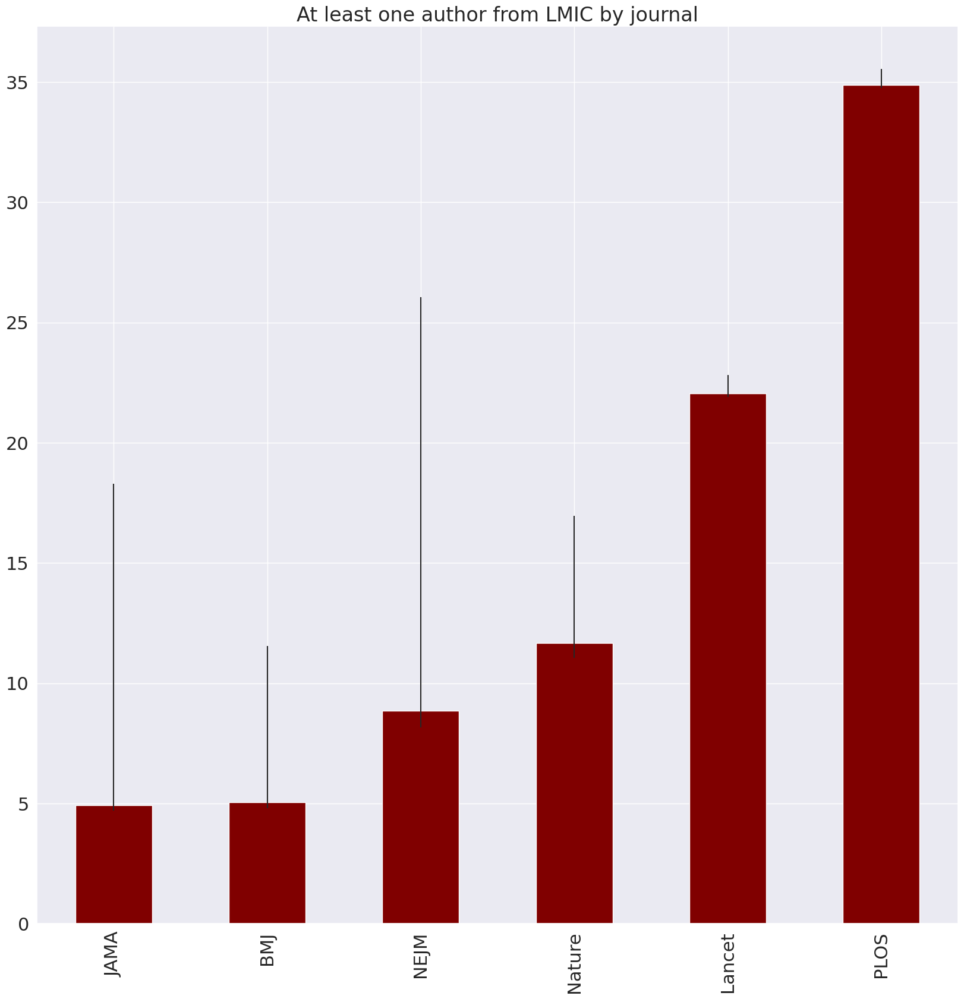

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl_1['c_real'].plot.bar(yerr=c_fl_1[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('At least one author from LMIC by journal')

1122 articles from nature medicine have missing values in pct_lmic_pes

it is why when we add at percentage of least one author articles and no authors from LMIC for nature medicine ,it doesn't become 100%

69+9=78 %

In [ ]:
df1_final.loc[(df1_final['pct_lmic_pes']!=0) & (df1_final['journal.title']=='Nature Medicine'),'pct_lmic_pes'].isna().sum()

0

In [ ]:
df1_final.loc[(df1_final['pct_lmic_pes']==0),'journal.title'].value_counts()

BMJ       43788
Lancet    17070
NEJM      15042
JAMA      14544
Nature     4897
PLOS       2372
Name: journal.title, dtype: int64

# first author from LMICs by journal

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>=2,:]

In [ ]:
c_fl_fir=pd.concat([df1_more2.loc[(df1_more2['first_lmic_pes']==1) ,'journal.title'].value_counts().rename('c_pes'),
           df1_more2.loc[(df1_more2['first_lmic_real']==1) ,'journal.title'].value_counts().rename('c_real'),
           df1_more2.loc[(df1_more2['first_lmic_opt']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_fir

,c_pes,c_real,c_opt
Lancet,2290,2290,2312
NEJM,900,900,2375
BMJ,677,677,894
PLOS,412,412,426
JAMA,342,342,790
Nature,188,188,200


In [ ]:
c_fl_fir=c_fl_fir.div(pd.concat([df1_more2.loc[(df1_more2['first_lmic_pes'].notna()) ,'journal.title'].value_counts().rename('c_pes'),
                         df1_more2.loc[(df1_more2['first_lmic_real'].notna()) ,'journal.title'].value_counts().rename('c_real'),
                         df1_more2.loc[(df1_more2['first_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_fir

,c_pes,c_real,c_opt
BMJ,0.050868,0.051711,0.067173
JAMA,0.030950,0.032258,0.071493
Lancet,0.131255,0.131420,0.132516
NEJM,0.069386,0.078288,0.183101
Nature,0.047475,0.047619,0.050505
PLOS,0.122183,0.122692,0.126335


In [ ]:
c_fl_fir['lower']=c_fl_fir['c_real']-c_fl_fir['c_pes']
c_fl_fir['upper']=c_fl_fir['c_opt']-c_fl_fir['c_real']
c_fl_fir=c_fl_fir.sort_values(by='c_real')*100
c_fl_fir

,c_pes,c_real,c_opt,lower,upper
JAMA,3.095023,3.225806,7.149321,0.130784,3.923515
Nature,4.747475,4.761905,5.050505,0.014430,0.288600
BMJ,5.086783,5.171097,6.717259,0.084313,1.546162
NEJM,6.938555,7.828810,18.310076,0.890255,10.481266
PLOS,12.218268,12.269208,12.633452,0.050940,0.364244
Lancet,13.125466,13.142037,13.251562,0.016572,0.109525


In [ ]:
c_fl_fir[['lower','upper']].T.values

array([[ 0.13078383,  0.01443001,  0.08431347,  0.89025478,  0.05093977,
         0.01657161],
       [ 3.92351482,  0.28860029,  1.54616214, 10.4812663 ,  0.3642441 ,
         0.10952457]])

In [ ]:
df1_more2.loc[(df1_more2['first_lmic_real'].notna()) ,'journal.title'].value_counts()

Lancet    17425
BMJ       13092
NEJM      11496
JAMA      10602
Nature     3948
PLOS       3358
Name: journal.title, dtype: int64

Text(0.5, 1.0, 'First author based in a LMICs by journal')

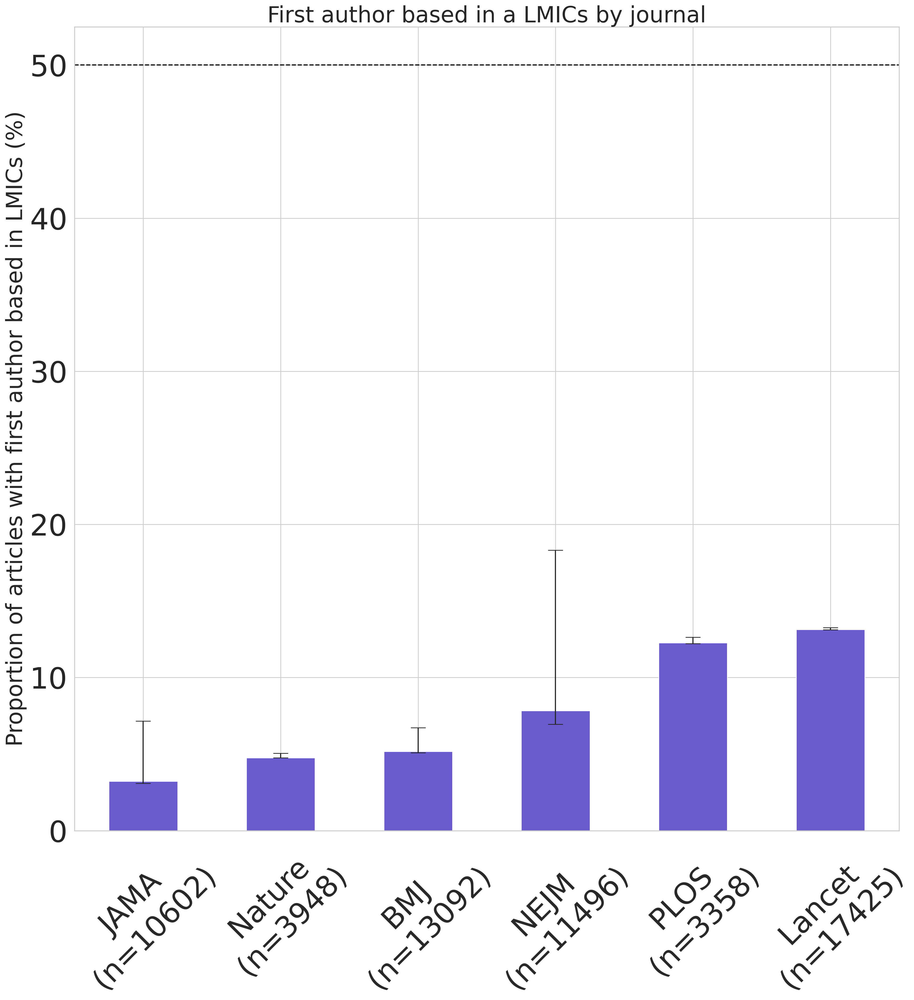

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=200)
sns.set(font_scale=2,style='whitegrid')
ax=c_fl_fir['c_real'].plot.bar(yerr=c_fl_fir[['lower','upper']].T.values,color='slateblue',ax=plt.gca(),rot=45,fontsize=40,capsize=10)

ax.axhline(y=50,linestyle='--',color='black')
ax.set_xticklabels( ['JAMA\n(n=10602)','Nature\n(n=3948)','BMJ\n(n=13092)','NEJM\n(n=11496)','PLOS\n(n=3358)','Lancet\n(n=17425)'])
ax.set_ylabel('Proportion of articles with first author based in LMICs (%)',fontsize=30)

plt.title('First author based in a LMICs by journal',fontsize=30)

#last author from lmic by journal

In [ ]:
df1_more2=df1_final.loc[df1_final['authors_count']>=2,:]

In [ ]:
c_fl_las=pd.concat([df1_more2.loc[(df1_more2['last_lmic_pes']==1) ,'journal.title'].value_counts().rename('c_pes'),
                df1_more2.loc[(df1_more2['last_lmic_real']==1) ,'journal.title'].value_counts().rename('c_real'),
                df1_more2.loc[(df1_more2['last_lmic_opt']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_las

,c_pes,c_real,c_opt
Lancet,2207,2207,2233
NEJM,853,853,2619
BMJ,603,603,1105
PLOS,388,388,404
JAMA,294,294,976
Nature,177,177,183


In [ ]:
c_fl_las=c_fl_las.div(pd.concat([df1_more2.loc[(df1_more2['last_lmic_pes'].notna()) ,'journal.title'].value_counts().rename('c_pes'),
                         df1_more2.loc[(df1_more2['last_lmic_real'].notna()) ,'journal.title'].value_counts().rename('c_real'),
                         df1_more2.loc[(df1_more2['last_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_las

,c_pes,c_real,c_opt
BMJ,0.045308,0.047084,0.083027
JAMA,0.026606,0.028356,0.088326
Lancet,0.126497,0.126686,0.127988
NEJM,0.065762,0.076127,0.201912
Nature,0.044697,0.044765,0.046212
PLOS,0.115065,0.115614,0.119810


In [ ]:
c_fl_las['lower']=c_fl_las['c_real']-c_fl_las['c_pes']
c_fl_las['upper']=c_fl_las['c_opt']-c_fl_las['c_real']
c_fl_las=c_fl_las.sort_values(by='c_real')*100
c_fl_las

,c_pes,c_real,c_opt,lower,upper
JAMA,2.660633,2.835648,8.832579,0.175015,5.996931
Nature,4.469697,4.476480,4.621212,0.006783,0.144733
BMJ,4.530769,4.708363,8.302652,0.177594,3.594290
NEJM,6.576208,7.612673,20.191196,1.036464,12.578523
PLOS,11.506524,11.561383,11.981020,0.054858,0.419638
Lancet,12.649739,12.668618,12.798762,0.018879,0.130144


In [ ]:
c_fl_las[['lower','upper']].T.values

array([[1.75014664e-01, 6.78254472e-03, 1.77593961e-01, 1.03646445e+00,
        5.48582804e-02, 1.88791240e-02],
       [5.99693104e+00, 1.44732607e-01, 3.59428973e+00, 1.25785228e+01,
        4.19637568e-01, 1.30143631e-01]])

In [ ]:
df1_more2.loc[(df1_more2['last_lmic_real'].notna()) ,'journal.title'].value_counts()

Lancet    17421
BMJ       12807
NEJM      11205
JAMA      10368
Nature     3954
PLOS       3356
Name: journal.title, dtype: int64

In [ ]:
df_n=pd.concat([c_fl_las['c_real'],df1_more2.loc[(df1_more2['last_lmic_real'].notna()) ,'journal.title'].value_counts()],axis=1)
df_n

,c_real,journal.title
JAMA,2.835648,10368
Nature,4.476480,3954
BMJ,4.708363,12807
NEJM,7.612673,11205
PLOS,11.561383,3356
Lancet,12.668618,17421


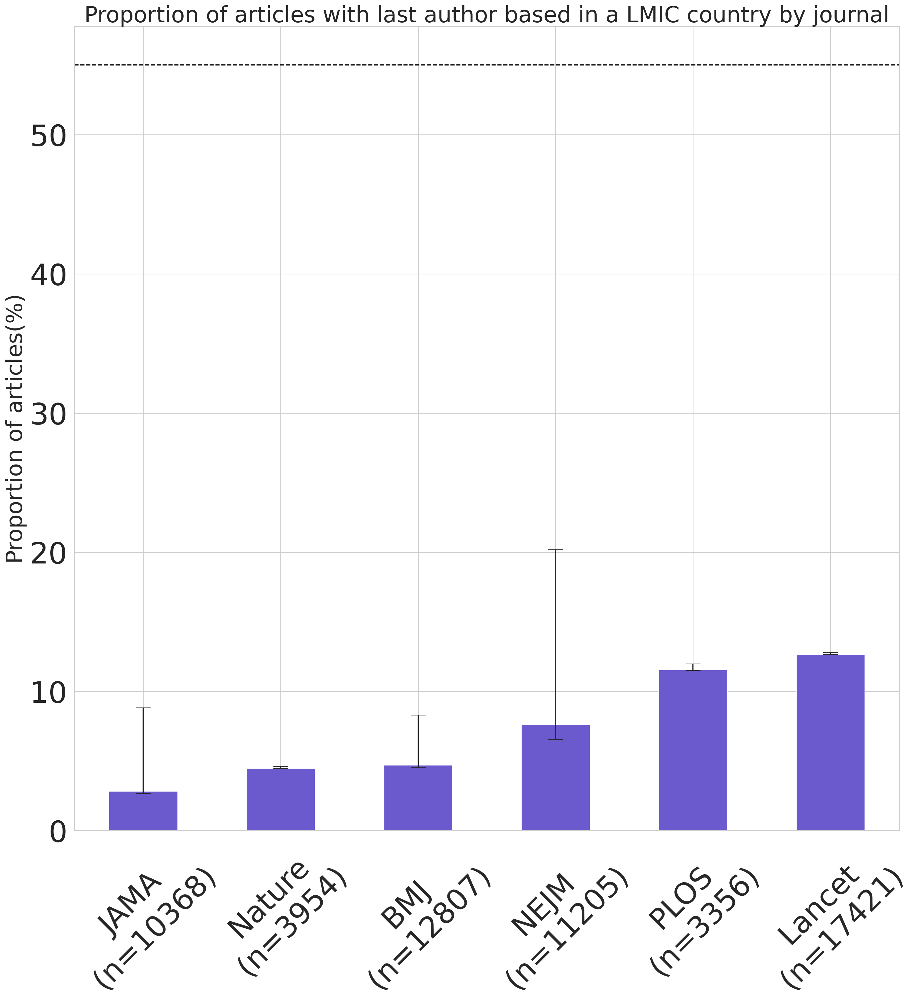

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=200)
sns.set(font_scale=2,style='whitegrid')
ax=c_fl_las['c_real'].plot.bar(yerr=c_fl_las[['lower','upper']].T.values,color='slateblue',ax=plt.gca(),fontsize=40,rot=45,capsize=10)
plt.title('Proportion of articles with last author based in a LMIC country by journal',fontsize=30)
ax.set_ylabel('Proportion of articles(%)',fontsize=30)
ax.axhline(y=55,linestyle='--',color='black')
ax.set_xticklabels([i+f"\n(n={df_n.loc[i,'journal.title']})" for i in df_n.index])
plt.show()

#Grouped barplot for comparison of first and last author

In [ ]:
c_fl_merge=pd.concat([c_fl_fir.rename(columns={'c_real':'First author affiliated in a LMIC'}),c_fl_las.rename(columns={'c_real':'Last author affiliated in a LMIC'})],axis=1)
c_fl_merge

,c_pes,First author affiliated in a LMIC,c_opt,lower,upper,c_pes,Last author affiliated in a LMIC,c_opt,lower,upper
JAMA,3.095023,3.225806,7.149321,0.130784,3.923515,2.660633,2.835648,8.832579,0.175015,5.996931
Nature,4.747475,4.761905,5.050505,0.014430,0.288600,4.469697,4.476480,4.621212,0.006783,0.144733
BMJ,5.086783,5.171097,6.717259,0.084313,1.546162,4.530769,4.708363,8.302652,0.177594,3.594290
NEJM,6.938555,7.828810,18.310076,0.890255,10.481266,6.576208,7.612673,20.191196,1.036464,12.578523
PLOS,12.218268,12.269208,12.633452,0.050940,0.364244,11.506524,11.561383,11.981020,0.054858,0.419638
Lancet,13.125466,13.142037,13.251562,0.016572,0.109525,12.649739,12.668618,12.798762,0.018879,0.130144


In [ ]:
c_fl_merge.iloc[:,[3,4,8,9]].values.T

array([[1.30783827e-01, 1.44300144e-02, 8.43134734e-02, 8.90254782e-01,
        5.09397717e-02, 1.65716066e-02],
       [3.92351482e+00, 2.88600289e-01, 1.54616214e+00, 1.04812663e+01,
        3.64244095e-01, 1.09524570e-01],
       [1.75014664e-01, 6.78254472e-03, 1.77593961e-01, 1.03646445e+00,
        5.48582804e-02, 1.88791240e-02],
       [5.99693104e+00, 1.44732607e-01, 3.59428973e+00, 1.25785228e+01,
        4.19637568e-01, 1.30143631e-01]])

In [ ]:
asy_err=np.array(np.split(c_fl_merge.iloc[:,[3,4,8,9]].values.T,2,axis=0))
asy_err

array([[[1.30783827e-01, 1.44300144e-02, 8.43134734e-02, 8.90254782e-01,
         5.09397717e-02, 1.65716066e-02],
        [3.92351482e+00, 2.88600289e-01, 1.54616214e+00, 1.04812663e+01,
         3.64244095e-01, 1.09524570e-01]],

       [[1.75014664e-01, 6.78254472e-03, 1.77593961e-01, 1.03646445e+00,
         5.48582804e-02, 1.88791240e-02],
        [5.99693104e+00, 1.44732607e-01, 3.59428973e+00, 1.25785228e+01,
         4.19637568e-01, 1.30143631e-01]]])

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
df1_more2.loc[(df1_more2['last_lmic_real'].notna()) ,'journal.title'].value_counts()

Lancet    17421
BMJ       12807
NEJM      11205
JAMA      10368
Nature     3954
PLOS       3356
Name: journal.title, dtype: int64

Text(0.5, 1.0, 'First/last author based in a LMICs by journal')

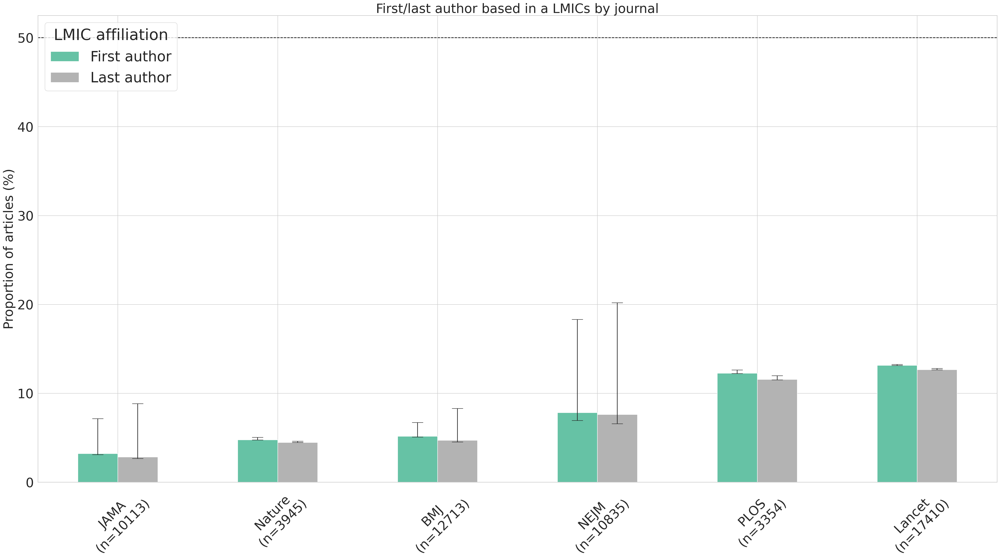

In [ ]:
fig=plt.figure(figsize=(40,20),dpi=200)
sns.set(font_scale=3,style='whitegrid')

ax=c_fl_merge[['First author affiliated in a LMIC','Last author affiliated in a LMIC']].plot.bar(yerr=asy_err,ax=plt.gca(),capsize=13,cmap='Set2',rot=45,fontsize=30)

ax.axhline(y=50,linestyle='--',color='black')

ax.legend(loc='upper left')
# title
new_title = 'LMIC affiliation'
ax.legend_.set_title(new_title)

new_labels = ['First author', 'Last author']

for t, l in zip(ax.legend_.texts, new_labels):
    t.set_text(l)


ax.set_xticklabels( ['JAMA\n(n=10113)','Nature\n(n=3945)','BMJ\n(n=12713)','NEJM\n(n=10835)','PLOS\n(n=3354)','Lancet\n(n=17410)'])
ax.set_ylabel('Proportion of articles (%)',fontsize=30)


plt.title('First/last author based in a LMICs by journal',fontsize=30)

#first and last author from LMICs by journal

In [ ]:
df1_final.loc[(df1_final['authors_count']>=2)&(df1_final['first_lmic_pes']==1) & (df1_final['last_lmic_pes']==1),'journal.title'].value_counts()

Lancet    1548
NEJM       728
BMJ        472
JAMA       243
PLOS       205
Nature     145
Name: journal.title, dtype: int64

Text(0.5, 1.0, 'Studies Distribution')

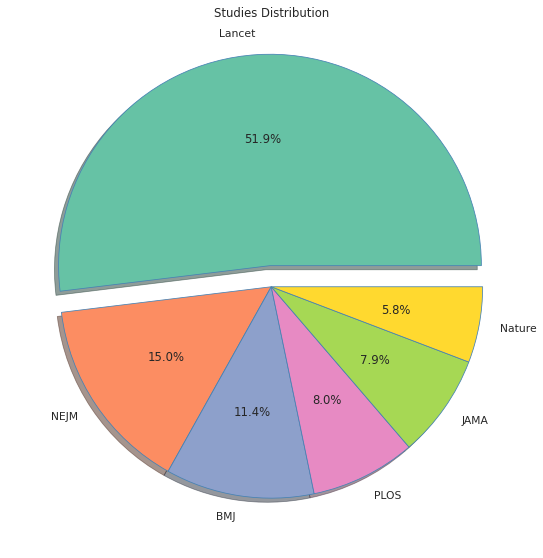

In [ ]:
sns.set(font_scale=1)
sns.set_theme(style='darkgrid',palette='Set2')

list_of_labels=df1_final.loc[(df1_final['authors_count']>2)&(df1_final['first_lmic_pes']==1) & (df1_final['last_lmic_pes']==1),'journal.title'].value_counts().index
count_array=df1_final.loc[(df1_final['authors_count']>2)&(df1_final['first_lmic_pes']==1) & (df1_final['last_lmic_pes']==1),'journal.title'].value_counts().tolist()

wedge_props = {"linewidth": 0.8, "edgecolor": "steelblue"}
text_props = {"weight": "bold"}

explode_par= len(list_of_labels)*[0]

explode_par[0]=0.1

fig=plt.figure(figsize=(10,10),dpi=70)


plt.pie(x=count_array,labels=list_of_labels,autopct='%1.1f%%' ,radius=1,
        wedgeprops=wedge_props,explode=explode_par,shadow=True)

plt.title('Studies Distribution') # if we don't standardize by number of articles in each journal

In [ ]:
df1_more2e=df1_final.loc[df1_final['authors_count']>=2,:]

In [ ]:
c_fl=pd.concat([df1_more2e.loc[(df1_more2e['first_lmic_pes']==1) & (df1_more2e['last_lmic_pes']==1),'journal.title'].value_counts().rename('c_pes'),
           df1_more2e.loc[(df1_more2e['first_lmic_real']==1) & (df1_more2e['last_lmic_real']==1),'journal.title'].value_counts().rename('c_real'),
           df1_more2e.loc[(df1_more2e['first_lmic_opt']==1) & (df1_more2e['last_lmic_opt']==1),'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
Lancet,1548,1548,1562
NEJM,728,728,1886
BMJ,472,472,616
JAMA,243,243,455
PLOS,205,205,217
Nature,145,145,148


In [ ]:
c_fl=c_fl.div(pd.concat([df1_more2e.loc[(df1_more2e['first_lmic_pes'].notna()) & (df1_more2e['last_lmic_pes'].notna()),'journal.title'].value_counts().rename('c_pes'),
                         df1_more2e.loc[(df1_more2e['first_lmic_real'].notna()) & (df1_more2e['last_lmic_real'].notna()),'journal.title'].value_counts().rename('c_real'),
                         df1_more2e.loc[(df1_more2e['first_lmic_opt'].notna()) & (df1_more2e['last_lmic_opt'].notna()),'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.035465,0.037127,0.046284
JAMA,0.021991,0.024028,0.041176
Lancet,0.088726,0.088914,0.089528
NEJM,0.056125,0.067190,0.145401
Nature,0.036616,0.036755,0.037374
PLOS,0.060795,0.061121,0.064353


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_pes']
c_fl['upper']=c_fl['c_opt']-c_fl['c_real']
c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
JAMA,2.199095,2.402848,4.117647,0.203753,1.714799
Nature,3.661616,3.675539,3.737374,0.013922,0.061835
BMJ,3.546472,3.712735,4.628447,0.166263,0.915712
PLOS,6.079478,6.112105,6.435350,0.032627,0.323245
NEJM,5.612520,6.718966,14.540128,1.106446,7.821162
Lancet,8.872586,8.891442,8.952829,0.018856,0.061387


In [ ]:
c_fl[['lower','upper']].T.values

array([[0.2037528 , 0.01392249, 0.16626268, 0.03262689, 1.10644608,
        0.01885616],
       [1.71479924, 0.06183508, 0.91571192, 0.32324499, 7.82116166,
        0.06138687]])

In [ ]:
df1_more2e.loc[(df1_more2e['first_lmic_real'].notna()) & (df1_more2e['last_lmic_real'].notna()),'journal.title'].value_counts()

Lancet    17410
BMJ       12713
NEJM      10835
JAMA      10113
Nature     3945
PLOS       3354
Name: journal.title, dtype: int64

Text(0.5, 1.0, 'first and last lmic by journal')

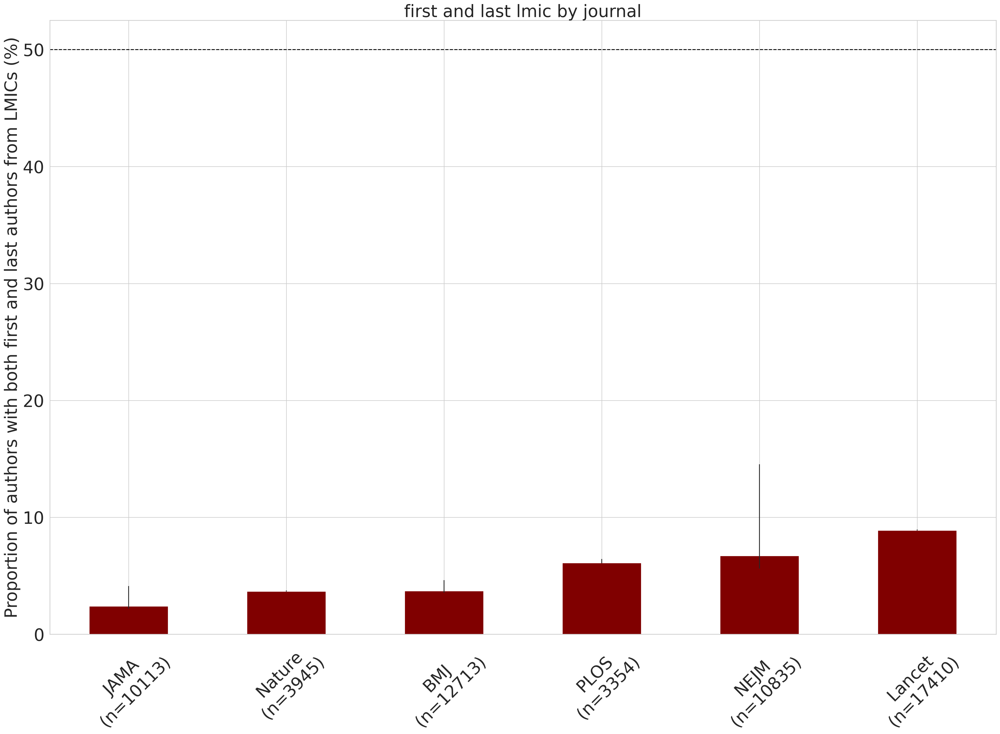

In [ ]:
fig=plt.figure(figsize=(30,20),dpi=200)
sns.set(font_scale=2)

sns.set_theme(style='whitegrid')

ax=c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='maroon',ax=plt.gca(),rot=45,fontsize=30)

ax.axhline(y=50,linestyle='--',color='black')
ax.set_xticklabels(['JAMA\n(n=10113)','Nature\n(n=3945)','BMJ\n(n=12713)','PLOS\n(n=3354)','NEJM\n(n=10835)','Lancet\n(n=17410)'])

ax.set_ylabel('Proportion of authors with both first and last authors from LMICs (%)',fontsize=30)

plt.title('first and last lmic by journal',fontsize=30)   # it is now standadized based on number of articles

#stacked barplot for first and last author

In [ ]:
df1_more2e=df1_final.loc[df1_final['authors_count']>=2,:]

In [ ]:
merge_col=pd.concat([df1_more2e.loc[(df1_more2e['first_lmic_real']==1) & (df1_more2e['last_lmic_real']==1),'journal.title'].value_counts().rename('First and last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_real']==1) & (df1_more2e['last_lmic_real']==0),'journal.title'].value_counts().rename('Only first author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_real']==0) & (df1_more2e['last_lmic_real']==1),'journal.title'].value_counts().rename('Only last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_real']==0) & (df1_more2e['last_lmic_real']==0),'journal.title'].value_counts().rename('First and last author affiliated in a HIC')],axis=1)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
Lancet,1548,740,658,14464
NEJM,728,130,114,9863
BMJ,472,189,126,11926
JAMA,243,84,47,9739
PLOS,205,207,183,2759
Nature,145,43,32,3725


In [ ]:
merge_col=merge_col.div(df1_more2e.loc[(df1_more2e['first_lmic_real'].notna()) & (df1_more2e['last_lmic_real'].notna()),'journal.title'].value_counts(),axis=0)*100
merge_col.sort_values(by='Only last author affiliated in a LMIC',inplace=True)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
JAMA,2.402848,0.830614,0.464748,96.301790
Nature,3.675539,1.089987,0.811153,94.423321
BMJ,3.712735,1.486667,0.991111,93.809486
NEJM,6.718966,1.199815,1.052146,91.029072
Lancet,8.891442,4.250431,3.779437,83.078690
PLOS,6.112105,6.171735,5.456172,82.259988


In [ ]:
df1_more2e.loc[(df1_more2e['first_lmic_real'].notna()) & (df1_more2e['last_lmic_real'].notna()) ,'journal.title'].value_counts()

Lancet    17410
BMJ       12713
NEJM      10835
JAMA      10113
Nature     3945
PLOS       3354
Name: journal.title, dtype: int64

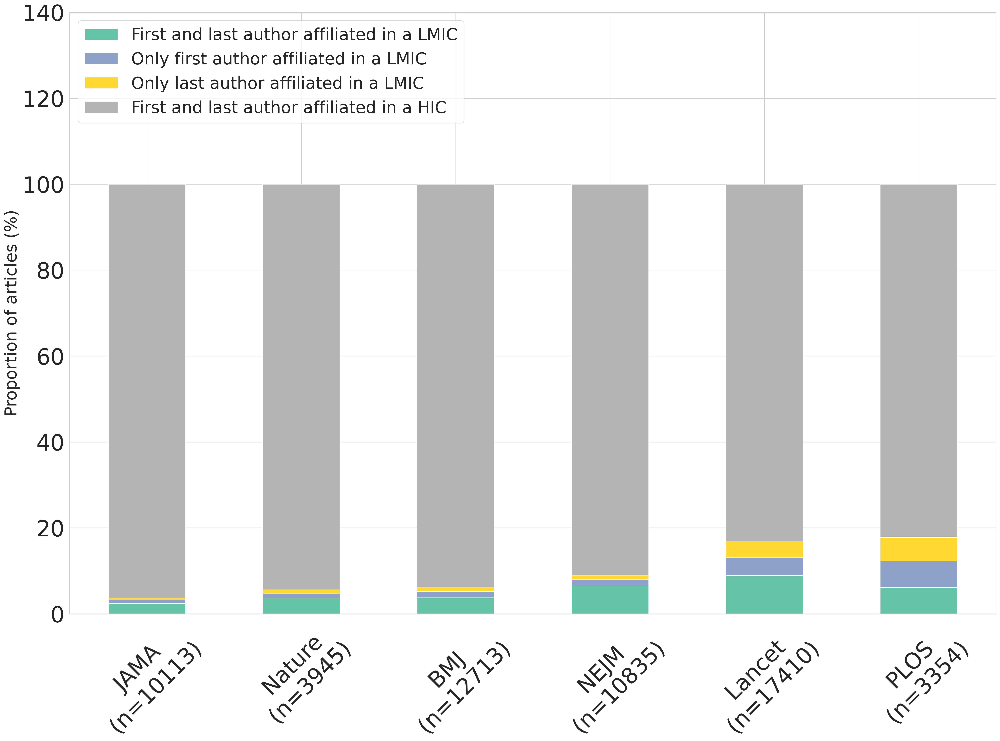

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
sns.set_theme(style='whitegrid')
ax=merge_col.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['JAMA\n(n=10113)','Nature\n(n=3945)','BMJ\n(n=12713)','NEJM\n(n=10835)','Lancet\n(n=17410)','PLOS\n(n=3354)'])
ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
#plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)



In [ ]:
merge_col=pd.concat([df1_more2e.loc[(df1_more2e['first_lmic_pes']==1) & (df1_more2e['last_lmic_pes']==1),'journal.title'].value_counts().rename('First and last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_pes']==1) & (df1_more2e['last_lmic_pes']==0),'journal.title'].value_counts().rename('Only first author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_pes']==0) & (df1_more2e['last_lmic_pes']==1),'journal.title'].value_counts().rename('Only last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_pes']==0) & (df1_more2e['last_lmic_pes']==0),'journal.title'].value_counts().rename('First and last author affiliated in a HIC')],axis=1)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
Lancet,1548,742,659,14498
NEJM,728,172,125,11946
BMJ,472,205,131,12501
JAMA,243,99,51,10657
PLOS,205,207,183,2777
Nature,145,43,32,3740


In [ ]:
merge_col=merge_col.div(df1_more2e.loc[(df1_more2e['first_lmic_pes'].notna()) & (df1_more2e['last_lmic_pes'].notna()),'journal.title'].value_counts(),axis=0)*100
merge_col.sort_values(by='First and last author affiliated in a LMIC',inplace=True)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
JAMA,2.199095,0.895928,0.461538,96.443439
BMJ,3.546472,1.540311,0.984296,93.928920
Nature,3.661616,1.085859,0.808081,94.444444
NEJM,5.612520,1.326035,0.963688,92.097757
PLOS,6.079478,6.138790,5.427046,82.354686
Lancet,8.872586,4.252880,3.777154,83.097381


In [ ]:
df1_more2e.loc[(df1_more2e['first_lmic_pes'].notna()) & (df1_more2e['last_lmic_pes'].notna()) ,'journal.title'].value_counts()

Lancet    17447
BMJ       13309
NEJM      12971
JAMA      11050
Nature     3960
PLOS       3372
Name: journal.title, dtype: int64

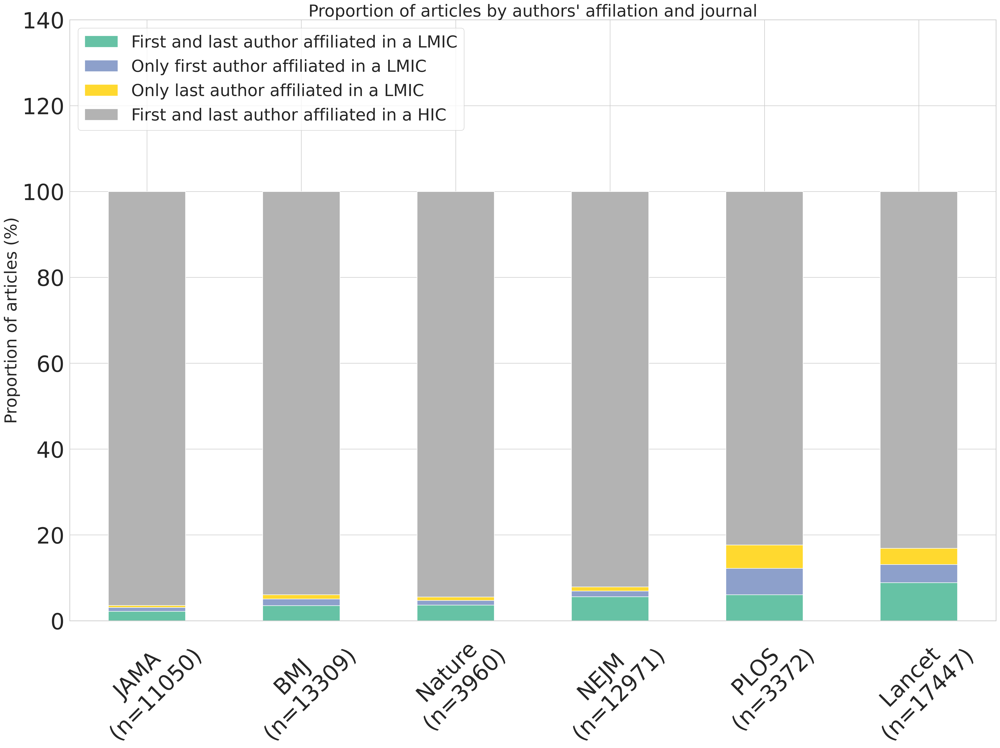

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
sns.set_theme(style='whitegrid')
ax=merge_col.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['JAMA\n(n=11050)','BMJ\n(n=13309)','Nature\n(n=3960)','NEJM\n(n=12971)','PLOS\n(n=3372)','Lancet\n(n=17447)'])
ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)



In [ ]:
merge_col=pd.concat([df1_more2e.loc[(df1_more2e['first_lmic_opt']==1) & (df1_more2e['last_lmic_opt']==1),'journal.title'].value_counts().rename('First and last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_opt']==1) & (df1_more2e['last_lmic_opt']==0),'journal.title'].value_counts().rename('Only first author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_opt']==0) & (df1_more2e['last_lmic_opt']==1),'journal.title'].value_counts().rename('Only last author affiliated in a LMIC'),
                     df1_more2e.loc[(df1_more2e['first_lmic_opt']==0) & (df1_more2e['last_lmic_opt']==0),'journal.title'].value_counts().rename('First and last author affiliated in a HIC')],axis=1)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
NEJM,1886,489,733,9863
Lancet,1562,750,671,14464
BMJ,616,278,489,11926
JAMA,455,335,521,9739
PLOS,217,209,187,2759
Nature,148,52,35,3725


In [ ]:
merge_col=merge_col.div(df1_more2e.loc[(df1_more2e['first_lmic_opt'].notna()) & (df1_more2e['last_lmic_opt'].notna()),'journal.title'].value_counts(),axis=0)*100
merge_col.sort_values(by='First and last author affiliated in a LMIC',inplace=True)
merge_col

,First and last author affiliated in a LMIC,Only first author affiliated in a LMIC,Only last author affiliated in a LMIC,First and last author affiliated in a HIC
Nature,3.737374,1.313131,0.883838,94.065657
JAMA,4.117647,3.031674,4.714932,88.135747
BMJ,4.628447,2.088812,3.674205,89.608536
PLOS,6.435350,6.198102,5.545670,81.820878
Lancet,8.952829,4.298733,3.845933,82.902505
NEJM,14.540128,3.769948,5.651068,76.038856


In [ ]:
df1_more2e.loc[(df1_more2e['first_lmic_opt'].notna()) & (df1_more2e['last_lmic_opt'].notna()) ,'journal.title'].value_counts()

Lancet    17447
BMJ       13309
NEJM      12971
JAMA      11050
Nature     3960
PLOS       3372
Name: journal.title, dtype: int64

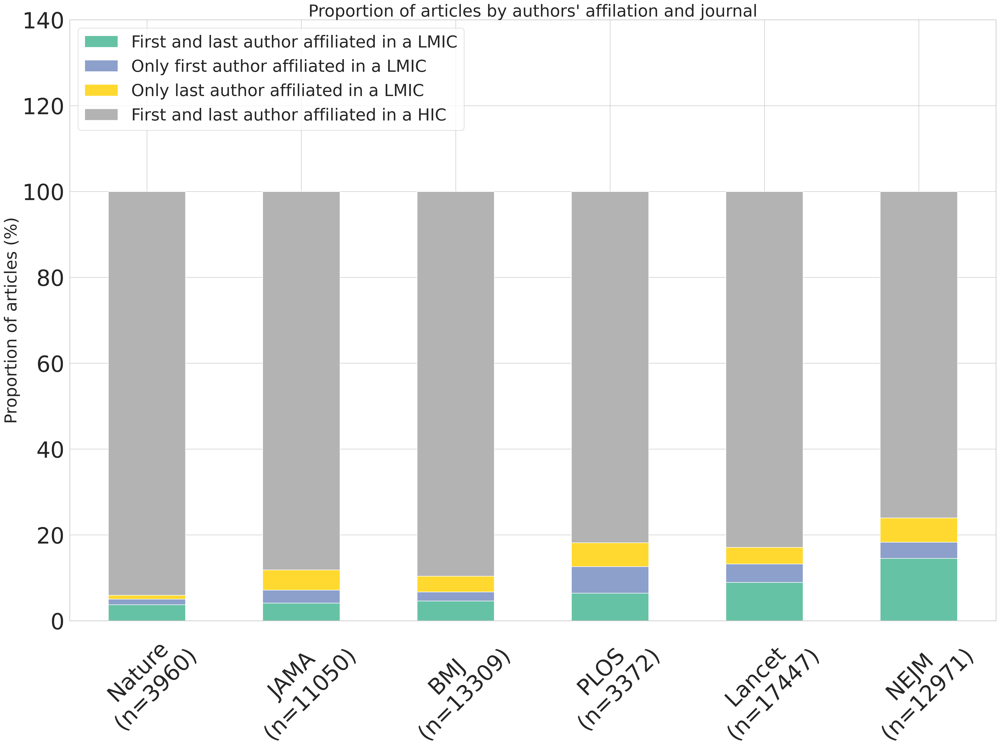

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
sns.set_theme(style='whitegrid')
ax=merge_col.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['Nature\n(n=3960)','JAMA\n(n=11050)','BMJ\n(n=13309)','PLOS\n(n=3372)','Lancet\n(n=17447)','NEJM\n(n=12971)'])
ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)



#first author female by journal

In [ ]:
c_fl=pd.concat([df1_more2.loc[(df1_more2['female_first_pessimistic']==1) ,'journal.title'].value_counts().rename('c_pes'),
           df1_more2.loc[(df1_more2['female_first_real']==1) ,'journal.title'].value_counts().rename('c_real'),
           df1_more2.loc[(df1_more2['female_first_optimistic']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
BMJ,5217,5217,6318
Lancet,5202,5202,6879
JAMA,4165,4165,5146
NEJM,4126,4126,5505
PLOS,1389,1389,1743
Nature,1330,1330,1733


In [ ]:
c_fl=c_fl.div(pd.concat([df1_more2.loc[(df1_more2['female_first_pessimistic'].notna()) ,'journal.title'].value_counts().rename('c_pes'),
                         df1_more2.loc[(df1_more2['female_first_real'].notna()) ,'journal.title'].value_counts().rename('c_real'),
                         df1_more2.loc[(df1_more2['female_first_optimistic'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.332251,0.357304,0.402369
JAMA,0.315196,0.340472,0.389435
Lancet,0.292691,0.323186,0.387048
NEJM,0.229669,0.248764,0.306429
Nature,0.322816,0.357815,0.420631
PLOS,0.391819,0.435287,0.491678


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_pes']
c_fl['upper']=c_fl['c_opt']-c_fl['c_real']
c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
NEJM,22.966880,24.876402,30.642917,1.909522,5.766515
Lancet,29.269116,32.318588,38.704777,3.049472,6.386188
JAMA,31.519600,34.047249,38.943545,2.527649,4.896295
BMJ,33.225067,35.730429,40.236912,2.505363,4.506483
Nature,32.281553,35.781544,42.063107,3.499991,6.281563
PLOS,39.181946,43.528674,49.167842,4.346728,5.639168


In [ ]:
c_fl[['lower','upper']].T.values

array([[1.90952174, 3.04947239, 2.52764882, 2.50536255, 3.49999086,
        4.34672799],
       [5.766515  , 6.38618844, 4.89629548, 4.50648307, 6.28156254,
        5.63916763]])

Text(0.5, 1.0, 'first female by journal')

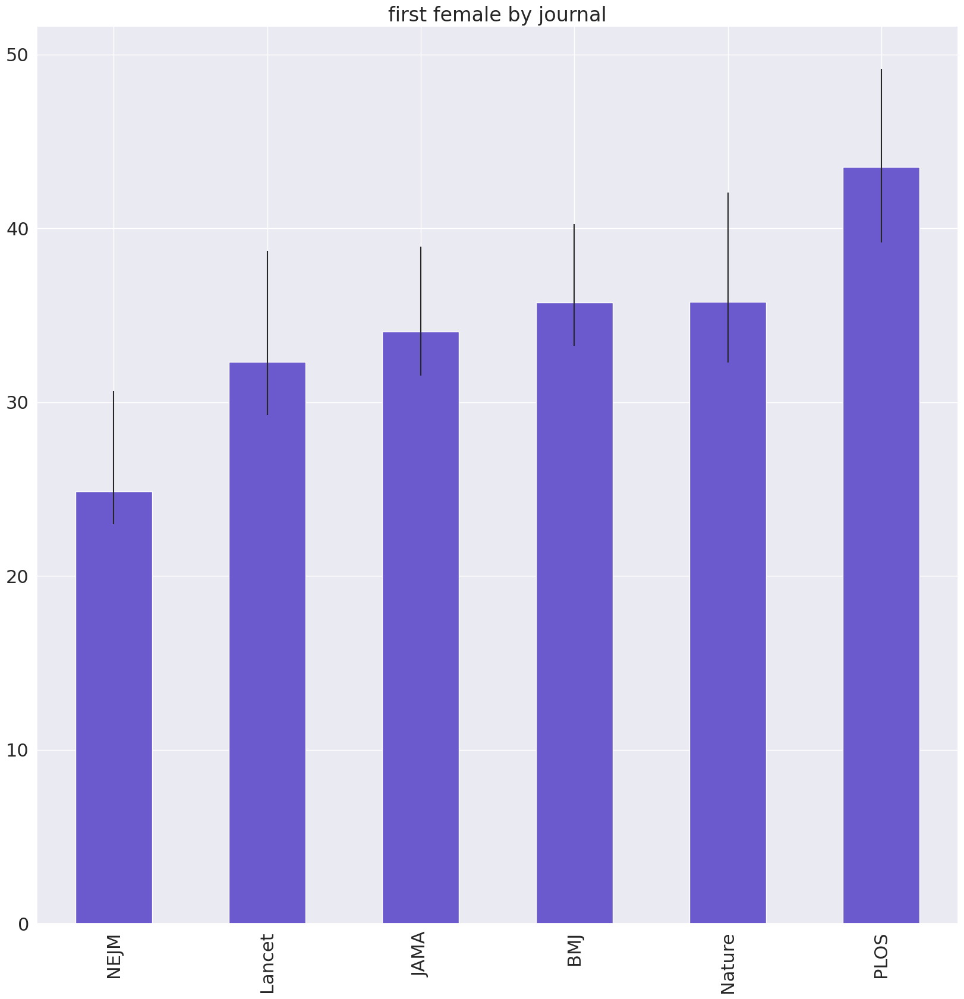

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='slateblue',ax=plt.gca())
plt.title('first female by journal')

#Last author female by journal

In [ ]:
c_fl=pd.concat([df1_more2.loc[(df1_more2['female_last_pessimistic']==1) ,'journal.title'].value_counts().rename('c_pes'),
           df1_more2.loc[(df1_more2['female_last_real']==1) ,'journal.title'].value_counts().rename('c_real'),
           df1_more2.loc[(df1_more2['female_last_optimistic']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
BMJ,4423,4423,5359
Lancet,4056,4056,6632
NEJM,3688,3688,4946
JAMA,3105,3105,4231
PLOS,977,977,1239
Nature,807,807,1135


In [ ]:
c_fl=c_fl.div(pd.concat([df1_more2.loc[(df1_more2['female_last_pessimistic'].notna()) ,'journal.title'].value_counts().rename('c_pes'),
                         df1_more2.loc[(df1_more2['female_last_real'].notna()) ,'journal.title'].value_counts().rename('c_real'),
                         df1_more2.loc[(df1_more2['female_last_optimistic'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.281684,0.299539,0.341294
JAMA,0.234978,0.256866,0.320191
Lancet,0.228211,0.266895,0.373150
NEJM,0.205288,0.220746,0.275313
Nature,0.195874,0.212816,0.275485
PLOS,0.275599,0.297594,0.349506


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_pes']
c_fl['upper']=c_fl['c_opt']-c_fl['c_real']
c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
Nature,19.587379,21.281646,27.548544,1.694267,6.266898
NEJM,20.528806,22.074580,27.531311,1.545774,5.456731
JAMA,23.497805,25.686631,32.019071,2.188826,6.332439
Lancet,22.821133,26.689478,37.315028,3.868345,10.625550
PLOS,27.559944,29.759366,34.950635,2.199423,5.191268
BMJ,28.168386,29.953948,34.129410,1.785562,4.175462


In [ ]:
c_fl[['lower','upper']].T.values

array([[ 1.69426693,  1.54577351,  2.18882601,  3.86834501,  2.19942285,
         1.78556207],
       [ 6.26689812,  5.45673136,  6.33243931, 10.62555023,  5.19126826,
         4.17546201]])

Text(0.5, 1.0, 'first and last female by journal')

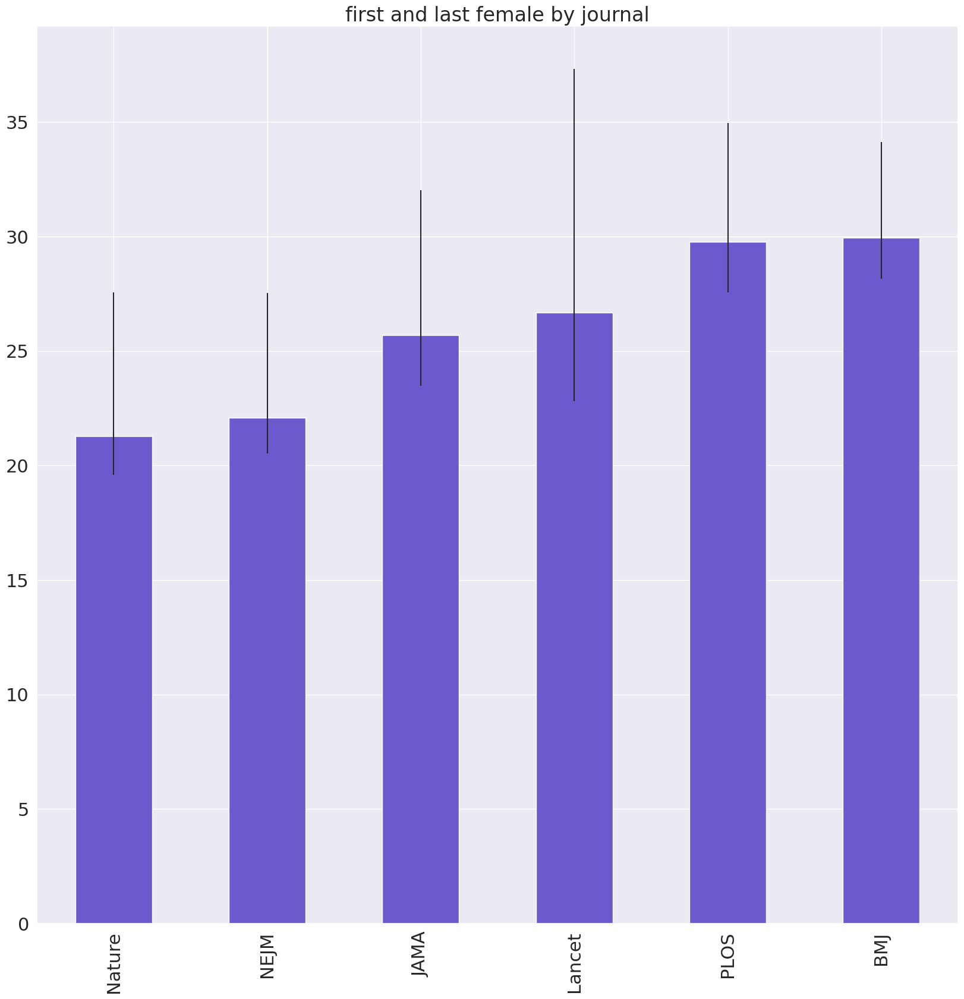

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='slateblue',ax=plt.gca())
plt.title('first and last female by journal')

#first and last author female by journal 

In [ ]:
df1_more2e=df1_final.loc[df1_final['authors_count']>=2,:]

In [ ]:
c_fl=pd.concat([df1_more2.loc[(df1_more2['female_first_pessimistic']==1) & (df1_more2['female_last_pessimistic']==1),'journal.title'].value_counts().rename('c_pes'),
           df1_more2.loc[(df1_more2['female_first_real']==1) & (df1_more2['female_last_real']==1),'journal.title'].value_counts().rename('c_real'),
           df1_more2.loc[(df1_more2['female_first_optimistic']==1) & (df1_more2['female_last_optimistic']==1),'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
BMJ,1792,1792,2504
Lancet,1561,1561,2938
JAMA,1209,1209,1853
NEJM,1074,1074,1803
PLOS,472,472,682
Nature,320,320,532


In [ ]:
c_fl=c_fl.div(pd.concat([df1_more2.loc[(df1_more2['female_first_pessimistic'].notna()) & (df1_more2['female_last_pessimistic'].notna()),'journal.title'].value_counts().rename('c_pes'),
                         df1_more2.loc[(df1_more2['female_first_real'].notna()) & (df1_more2['female_last_real'].notna()),'journal.title'].value_counts().rename('c_real'),
                         df1_more2.loc[(df1_more2['female_first_optimistic'].notna()) & (df1_more2['female_last_optimistic'].notna()),'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.114126,0.129714,0.159470
JAMA,0.091494,0.107514,0.140230
Lancet,0.087830,0.112432,0.165307
NEJM,0.059783,0.068957,0.100362
Nature,0.077670,0.092700,0.129126
PLOS,0.133145,0.159030,0.192384


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_pes']
c_fl['upper']=c_fl['c_opt']-c_fl['c_real']
c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
NEJM,5.978291,6.895666,10.036181,0.917375,3.140515
Nature,7.766990,9.269988,12.912621,1.502998,3.642633
JAMA,9.149387,10.751445,14.023006,1.602058,3.271561
Lancet,8.782985,11.243158,16.530693,2.460172,5.287535
BMJ,11.412559,12.971408,15.947013,1.558849,2.975605
PLOS,13.314528,15.902965,19.238364,2.588437,3.335399


In [ ]:
c_fl[['lower','upper']].T.values

array([[0.91737501, 1.50299812, 1.60205807, 2.46017216, 1.55884898,
        2.58843746],
       [3.14051533, 3.64263295, 3.27156082, 5.28753503, 2.97560523,
        3.33539893]])

Text(0.5, 1.0, 'first and last female by journal')

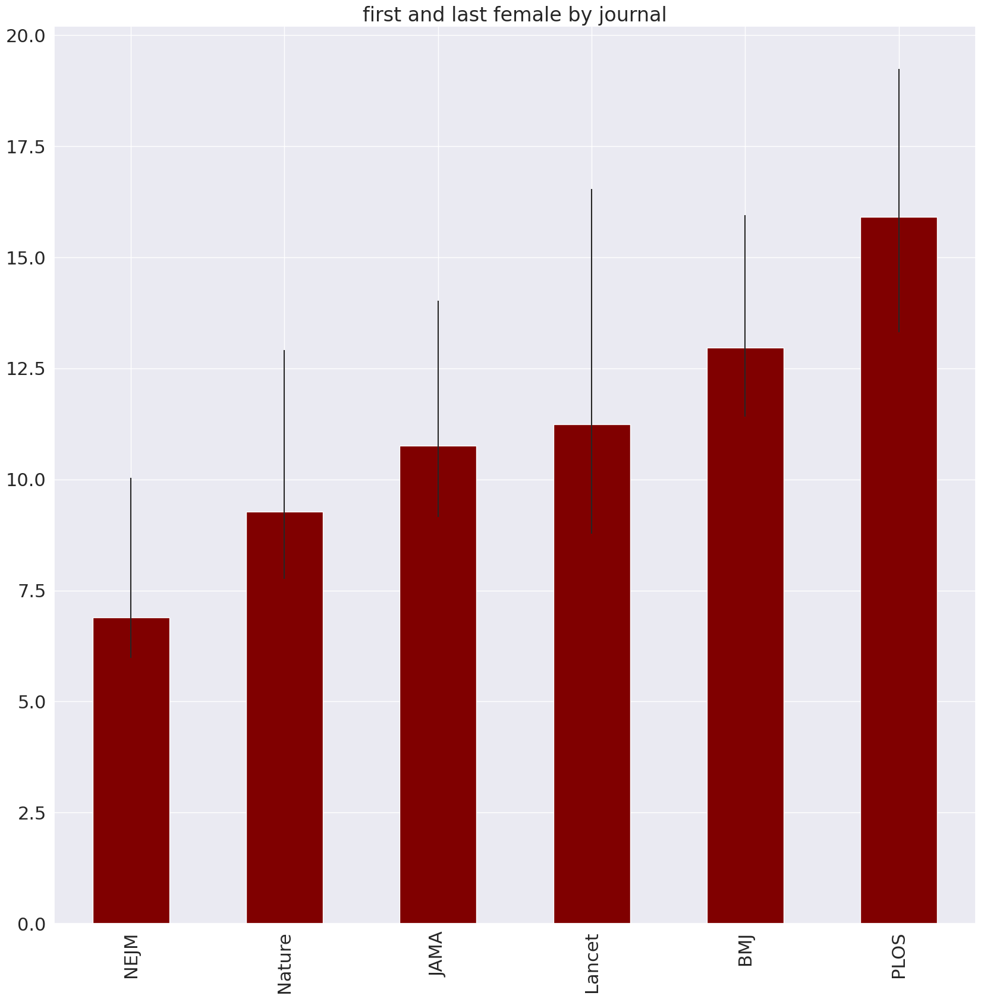

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('first and last female by journal')

#One author LMICs vs more than one author LMICs

In [ ]:
df1_final['author_count12']=df1_final['authors_count'].copy()

df1_final.loc[df1_final['authors_count']==1,'author_count12']=False
df1_final.loc[df1_final['authors_count']>=2,'author_count12']=True

In [ ]:
one_t=df1_final.replace({True:'more than one',False:'one'}).groupby(['author_count12','journal.title'])[['pct_lmic_pes','pct_lmic_real','pct_lmic_opt']].mean()
one_t=one_t.loc[[('one','JAMA'),('one','Nature'),
                 ('one','NEJM'),
                 ('one','BMJ'),('one','Lancet'),
                 ('one','PLOS'),
                 ('more than one','JAMA'),('more than one','Nature'),
                 ('more than one','NEJM'),
                 ('more than one','BMJ'),('more than one','Lancet'),
                 ('more than one','PLOS')],:]*100
one_t

pct_lmic_pes  pct_lmic_real  pct_lmic_opt
author_count12 journal.title                                           
one            JAMA               1.388559       1.587948     14.877364
               Nature             3.689320       4.534606     22.513484
               NEJM               2.643004       2.833021      8.920505
               BMJ                3.109799       3.329189      9.667707
               Lancet             8.225624       8.497306     11.475813
               PLOS              10.517473      10.646259     11.928763
more than one  JAMA               3.119226       3.285786      8.539881
               Nature             5.226865       5.232753      5.472103
               NEJM               6.978359       7.893596     19.884826
               BMJ                5.191148       5.324282      8.249261
               Lancet            14.149191      14.173489     14.300045
               PLOS              15.788744      15.836552     16.135131

In [ ]:
one_t['lower']=one_t['pct_lmic_real']-one_t['pct_lmic_pes']
one_t['upper']=one_t['pct_lmic_opt']-one_t['pct_lmic_pes']
one_t

pct_lmic_pes  pct_lmic_real  pct_lmic_opt  \
author_count12 journal.title                                              
one            JAMA               1.388559       1.587948     14.877364   
               Nature             3.689320       4.534606     22.513484   
               NEJM               2.643004       2.833021      8.920505   
               BMJ                3.109799       3.329189      9.667707   
               Lancet             8.225624       8.497306     11.475813   
               PLOS              10.517473      10.646259     11.928763   
more than one  JAMA               3.119226       3.285786      8.539881   
               Nature             5.226865       5.232753      5.472103   
               NEJM               6.978359       7.893596     19.884826   
               BMJ                5.191148       5.324282      8.249261   
               Lancet            14.149191      14.173489     14.300045   
               PLOS              15.788744      15.836552     16.135131   

                                 lower      upper  
author_count12 journal.title                       
one            JAMA           0.199389  13.488804  
               Nature         0.845286  18.824164  
               NEJM           0.190017   6.277501  
               BMJ            0.219390   6.557908  
               Lancet         0.271683   3.250189  
               PLOS           0.128785   1.411290  
more than one  JAMA           0.166560   5.420655  
               Nature         0.005888   0.245238  
               NEJM           0.915237  12.906466  
               BMJ            0.133134   3.058113  
               Lancet         0.024298   0.150854  
               PLOS           0.047809   0.346387

In [ ]:
s10=one_t.pivot_table(index='author_count12',columns='journal.title',values='pct_lmic_real')
s10=s10.loc[['one','more than one'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
author_count12,,,,,,
one,3.329189,1.587948,8.497306,2.833021,4.534606,10.646259
more than one,5.324282,3.285786,14.173489,7.893596,5.232753,15.836552


In [ ]:
asy_err=np.split(one_t[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[ 0.19938866, 13.48880449],
       [ 0.84528582, 18.82416397],
       [ 0.19001682,  6.27750073],
       [ 0.21938989,  6.55790783],
       [ 0.27168258,  3.25018896],
       [ 0.12878539,  1.41129032]]), array([[1.66559981e-01, 5.42065522e+00],
       [5.88780948e-03, 2.45237889e-01],
       [9.15237022e-01, 1.29064665e+01],
       [1.33134126e-01, 3.05811279e+00],
       [2.42982668e-02, 1.50854141e-01],
       [4.78085607e-02, 3.46386983e-01]])]


In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[1.99388661e-01, 1.66559981e-01],
        [1.34888045e+01, 5.42065522e+00]],

       [[8.45285817e-01, 5.88780948e-03],
        [1.88241640e+01, 2.45237889e-01]],

       [[1.90016824e-01, 9.15237022e-01],
        [6.27750073e+00, 1.29064665e+01]],

       [[2.19389886e-01, 1.33134126e-01],
        [6.55790783e+00, 3.05811279e+00]],

       [[2.71682578e-01, 2.42982668e-02],
        [3.25018896e+00, 1.50854141e-01]],

       [[1.28785385e-01, 4.78085607e-02],
        [1.41129032e+00, 3.46386983e-01]]])

Text(0.5, 1.0, 'one vs two')

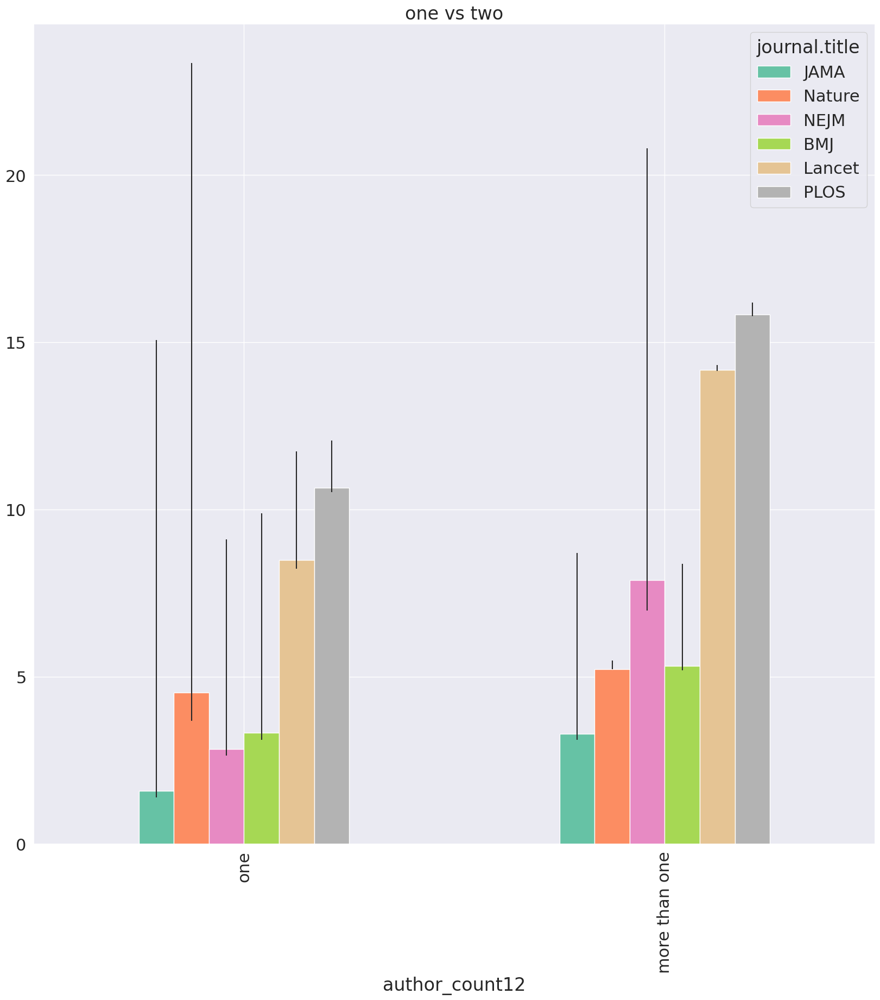

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
s10.loc[:,['JAMA','Nature','NEJM','BMJ','Lancet','PLOS']].plot.bar(yerr=asy_err,cmap='Set2',ax=plt.gca())
plt.title('one vs two')

#one author articles vs more than one articles by journal mapped based on at least one author from LMIC 

In [ ]:
one_t=df1_final.replace({True:'more than one',False:'one'}).groupby(['author_count12','journal.title'])[['at_least_one_lmic_pes','at_least_one_lmic_real','at_least_one_lmic_opt']].mean()
one_t=one_t.loc[[('one','JAMA'),('one','NEJM'),
                 ('one','BMJ'),
                 ('one','Nature'),
                 ('one','Lancet'),
                 ('one','PLOS'),
                 ('more than one','JAMA'),('more than one','NEJM'),
                 ('more than one','BMJ'),
                 ('more than one','Nature'),
                 ('more than one','Lancet'),
                 ('more than one','PLOS')],:]*100
one_t

at_least_one_lmic_pes  at_least_one_lmic_real  \
author_count12 journal.title                                                  
one            JAMA                        1.447899                1.655809   
               NEJM                        2.845409                3.033146   
               BMJ                         3.120507                3.337369   
               Nature                      3.754045                4.614161   
               Lancet                      8.775510                9.065355   
               PLOS                       13.709677               13.877551   
more than one  JAMA                        5.954751                6.017926   
               NEJM                        9.567497               10.407581   
               BMJ                         8.926290                8.989104   
               Nature                     13.888889               13.895907   
               Lancet                     25.219235               25.227911   
               PLOS                       36.447212               36.512181   

                              at_least_one_lmic_opt  
author_count12 journal.title                         
one            JAMA                       15.974365  
               NEJM                        9.181578  
               BMJ                         9.737816  
               Nature                     22.783172  
               Lancet                     12.086168  
               PLOS                       15.322581  
more than one  JAMA                       19.167421  
               NEJM                       30.498805  
               BMJ                        15.974153  
               Nature                     14.696970  
               Lancet                     25.540207  
               PLOS                       37.040332

In [ ]:
one_t['lower']=one_t['at_least_one_lmic_real']-one_t['at_least_one_lmic_pes']
one_t['upper']=one_t['at_least_one_lmic_opt']-one_t['at_least_one_lmic_pes']
one_t

at_least_one_lmic_pes  at_least_one_lmic_real  \
author_count12 journal.title                                                  
one            JAMA                        1.447899                1.655809   
               NEJM                        2.845409                3.033146   
               BMJ                         3.120507                3.337369   
               Nature                      3.754045                4.614161   
               Lancet                      8.775510                9.065355   
               PLOS                       13.709677               13.877551   
more than one  JAMA                        5.954751                6.017926   
               NEJM                        9.567497               10.407581   
               BMJ                         8.926290                8.989104   
               Nature                     13.888889               13.895907   
               Lancet                     25.219235               25.227911   
               PLOS                       36.447212               36.512181   

                              at_least_one_lmic_opt     lower      upper  
author_count12 journal.title                                              
one            JAMA                       15.974365  0.207910  14.526466  
               NEJM                        9.181578  0.187737   6.336169  
               BMJ                         9.737816  0.216862   6.617310  
               Nature                     22.783172  0.860115  19.029126  
               Lancet                     12.086168  0.289845   3.310658  
               PLOS                       15.322581  0.167874   1.612903  
more than one  JAMA                       19.167421  0.063175  13.212670  
               NEJM                       30.498805  0.840085  20.931308  
               BMJ                        15.974153  0.062814   7.047862  
               Nature                     14.696970  0.007018   0.808081  
               Lancet                     25.540207  0.008676   0.320972  
               PLOS                       37.040332  0.064968   0.593120

In [ ]:
s10=one_t.pivot_table(index='author_count12',columns='journal.title',values='at_least_one_lmic_real')
s10=s10.loc[['one','more than one'],:]
s10

journal.title,BMJ,JAMA,Lancet,NEJM,Nature,PLOS
author_count12,,,,,,
one,3.337369,1.655809,9.065355,3.033146,4.614161,13.877551
more than one,8.989104,6.017926,25.227911,10.407581,13.895907,36.512181


In [ ]:
asy_err=np.split(one_t[['lower','upper']].values,2,axis=0)
print(asy_err)

[array([[ 0.20790954, 14.5264657 ],
       [ 0.18773651,  6.33616896],
       [ 0.21686209,  6.61730963],
       [ 0.86011539, 19.02912621],
       [ 0.28984468,  3.3106576 ],
       [ 0.1678736 ,  1.61290323]]), array([[6.31746050e-02, 1.32126697e+01],
       [8.40084625e-01, 2.09313083e+01],
       [6.28136361e-02, 7.04786235e+00],
       [7.01813486e-03, 8.08080808e-01],
       [8.67584499e-03, 3.20972087e-01],
       [6.49682929e-02, 5.93119810e-01]])]


In [ ]:
asy_err=list(map(lambda x:x.T , asy_err))

In [ ]:
asy_err=np.array(asy_err)

In [ ]:
asy_err.shape

(2, 2, 6)

In [ ]:
asy_err=np.array(list(map(lambda x : x.reshape((2,2)).T,np.split(asy_err,6,axis=2))))

In [ ]:
asy_err

array([[[2.07909544e-01, 6.31746050e-02],
        [1.45264657e+01, 1.32126697e+01]],

       [[1.87736505e-01, 8.40084625e-01],
        [6.33616896e+00, 2.09313083e+01]],

       [[2.16862090e-01, 6.28136361e-02],
        [6.61730963e+00, 7.04786235e+00]],

       [[8.60115393e-01, 7.01813486e-03],
        [1.90291262e+01, 8.08080808e-01]],

       [[2.89844680e-01, 8.67584499e-03],
        [3.31065760e+00, 3.20972087e-01]],

       [[1.67873601e-01, 6.49682929e-02],
        [1.61290323e+00, 5.93119810e-01]]])

Text(0.5, 1.0, 'one vs two authors or more')

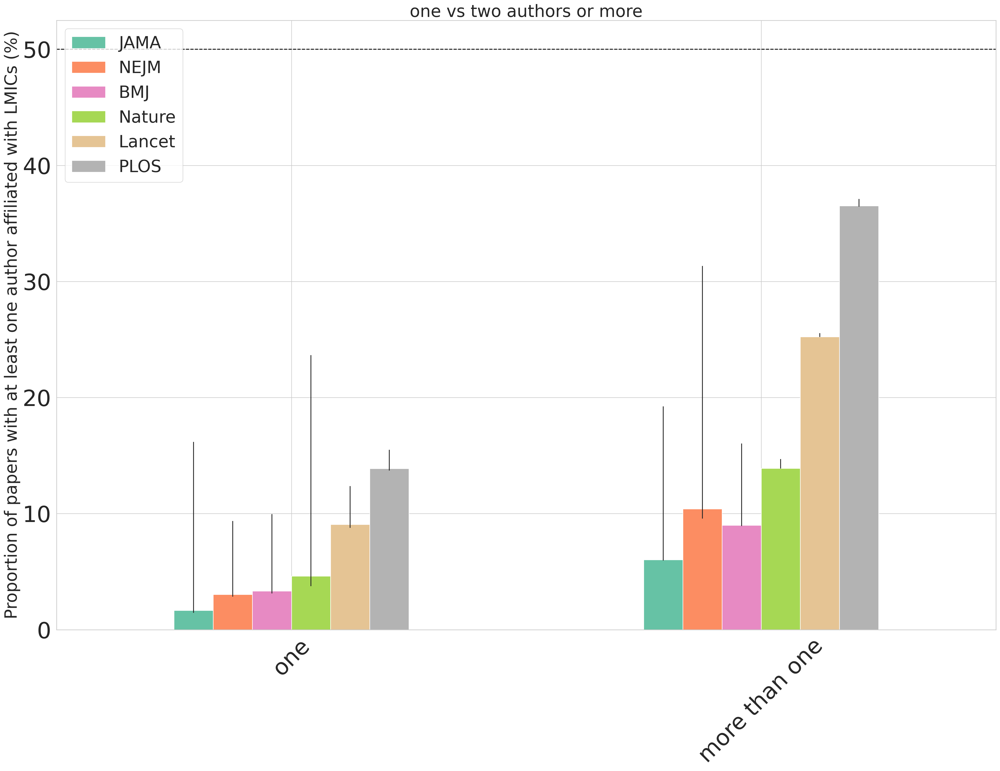

In [ ]:
fig=plt.figure(figsize=(30,20),dpi=200)
sns.set(font_scale=2)

sns.set_theme(style='whitegrid')

ax=s10.loc[:,['JAMA','NEJM','BMJ','Nature','Lancet','PLOS']].plot.bar(yerr=asy_err,cmap='Set2',ax=plt.gca(),rot=45,fontsize=40)
ax.axhline(y=50,linestyle='--',color='black')

ax.set_ylabel('Proportion of papers with at least one author affiliated with LMICs (%)',fontsize=30)
ax.set_xlabel('')
plt.legend(loc='upper left',fontsize=30)

plt.title('one vs two authors or more',fontsize=30)

#All authors from LMICS by journal

In [ ]:
c_fl_all=pd.concat([df1_final.loc[(df1_final['pct_lmic_pes']==1),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_lmic_real']==1),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_lmic_opt']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_all

,c_pes,c_real,c_opt
Lancet,1528,1531,1678
BMJ,1387,1409,3626
NEJM,748,814,2072
JAMA,253,259,904
Nature,131,131,421
PLOS,115,116,130


In [ ]:
c_fl_all=c_fl_all.div(pd.concat([df1_final.loc[(df1_final['pct_lmic_pes'].notna()),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_lmic_real'].notna()),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_all

,c_pes,c_real,c_opt
BMJ,0.030155,0.032184,0.078833
JAMA,0.016576,0.017718,0.059228
Lancet,0.069909,0.070520,0.076772
NEJM,0.045665,0.053829,0.126496
Nature,0.023797,0.025120,0.076476
PLOS,0.031637,0.032035,0.035763


In [ ]:
c_fl_all['lower']=c_fl_all['c_real']-c_fl_all['c_pes']
c_fl_all['upper']=c_fl_all['c_opt']-c_fl_all['c_real']
c_fl_all=c_fl_all.sort_values(by='c_real')*100
c_fl_all

,c_pes,c_real,c_opt,lower,upper
JAMA,1.657603,1.771788,5.922820,0.114185,4.151032
Nature,2.379655,2.511985,7.647593,0.132330,5.135608
PLOS,3.163686,3.203535,3.576341,0.039849,0.372806
BMJ,3.015480,3.218438,7.883294,0.202958,4.664856
NEJM,4.566545,5.382886,12.649573,0.816341,7.266687
Lancet,6.990895,7.052050,7.677174,0.061154,0.625125


In [ ]:
c_fl_all[['lower','upper']].T.values

array([[0.11418485, 0.1323298 , 0.03984855, 0.20295846, 0.8163413 ,
        0.06115438],
       [4.15103168, 5.13560844, 0.37280619, 4.66485614, 7.26668679,
        0.62512461]])

Text(0.5, 1.0, 'All authors from LMIC by journal')

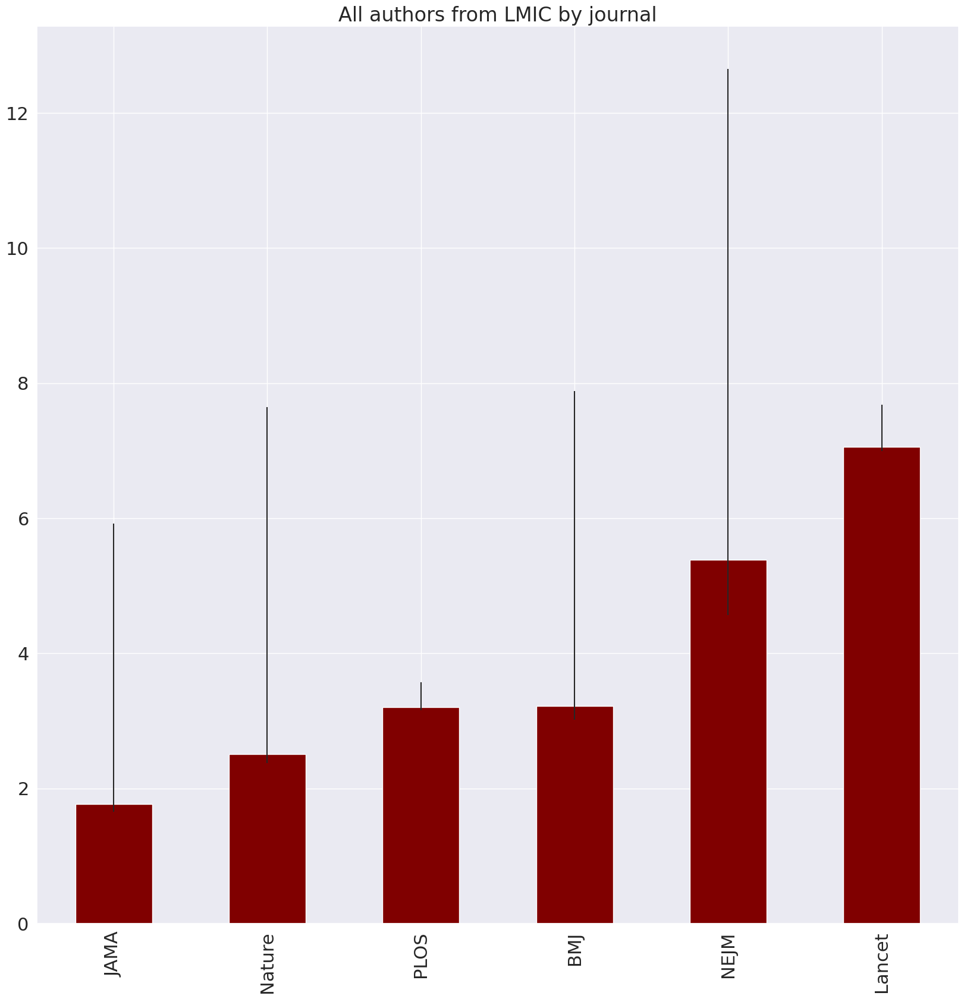

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl_all['c_real'].plot.bar(yerr=c_fl_all[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('All authors from LMIC by journal')

#No authors from LMICs by journal

In [ ]:
c_fl_no=pd.concat([df1_final.loc[(df1_final['pct_lmic_pes']==0),'journal.title'].value_counts().rename('c_pes'),
                df1_final.loc[(df1_final['pct_lmic_real']==0),'journal.title'].value_counts().rename('c_real'),
                df1_final.loc[(df1_final['pct_lmic_opt']==0) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_no

,c_pes,c_real,c_opt
BMJ,43788,41571,40687
Lancet,17070,16923,16868
NEJM,15042,13784,12111
JAMA,14544,13899,12472
Nature,4897,4607,4571
PLOS,2372,2358,2343


In [ ]:
c_fl_no=c_fl_no.div(pd.concat([df1_final.loc[(df1_final['pct_lmic_pes'].notna()),'journal.title'].value_counts().rename('c_pes'),
                df1_final.loc[(df1_final['pct_lmic_real'].notna()),'journal.title'].value_counts().rename('c_real'),
                df1_final.loc[(df1_final['pct_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_no

,c_pes,c_real,c_opt
BMJ,0.951996,0.949565,0.884577
Lancet,0.780985,0.779503,0.771744
NEJM,0.918315,0.911520,0.739377
JAMA,0.952893,0.950814,0.817139
Nature,0.889555,0.883413,0.830336
PLOS,0.652545,0.651201,0.644567


In [ ]:
c_fl_no['lower']=c_fl_no['c_real']-c_fl_no['c_opt']
c_fl_no['upper']=c_fl_no['c_pes']-c_fl_no['c_real']

c_fl_no=c_fl_no.sort_values(by='c_real')*100
c_fl_no

,c_pes,c_real,c_opt,lower,upper
PLOS,65.254470,65.120133,64.456671,0.663461,0.134338
Lancet,78.098550,77.950253,77.174361,0.775893,0.148296
Nature,88.955495,88.341323,83.033606,5.307717,0.614172
NEJM,91.831502,91.151964,73.937729,17.214235,0.679538
BMJ,95.199583,94.956486,88.457692,6.498794,0.243097
JAMA,95.289262,95.081406,81.713949,13.367458,0.207855


In [ ]:
c_fl_no[['lower','upper']].T.values

array([[ 0.66346131,  0.77589272,  5.30771729, 17.21423509,  6.49879401,
        13.36745772],
       [ 0.13433787,  0.14829632,  0.6141719 ,  0.67953781,  0.24309659,
         0.20785513]])

Text(0.5, 1.0, 'All authors from LMIC by journal')

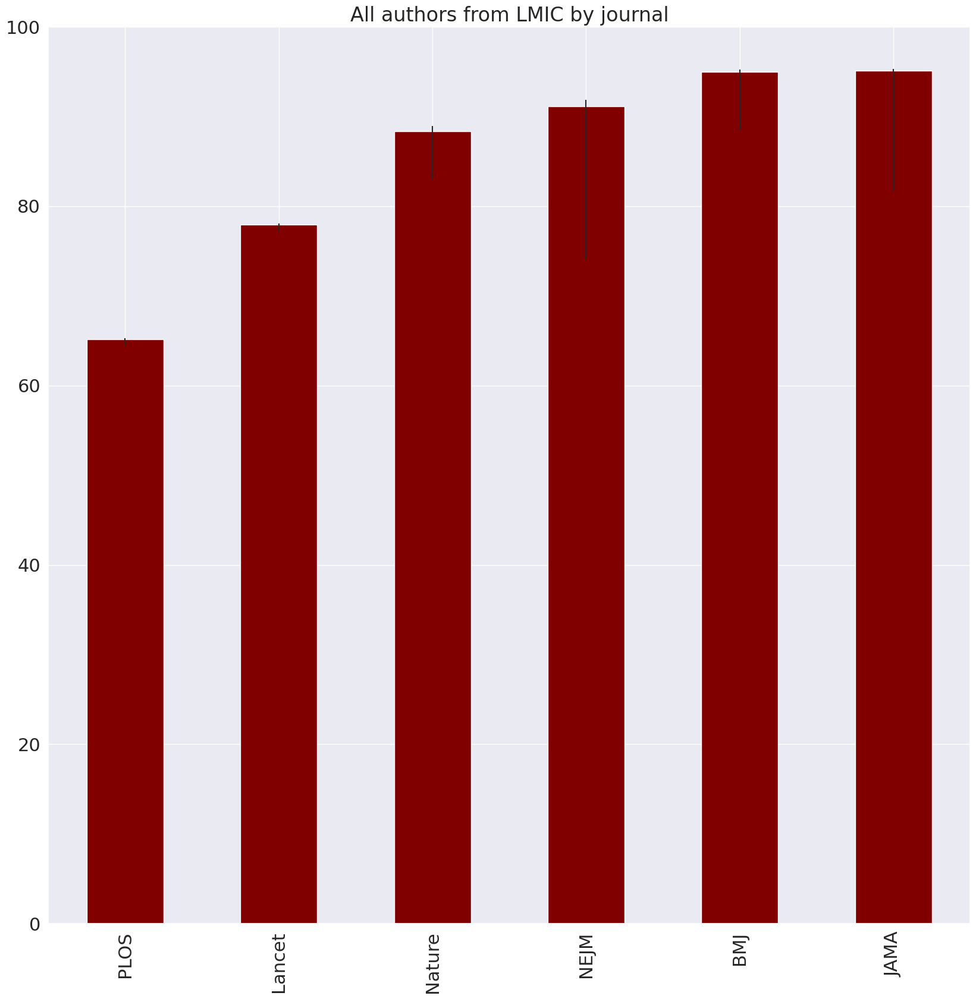

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl_no['c_real'].plot.bar(yerr=c_fl_no[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('All authors from LMIC by journal')

#stacked bar plots (mix+all HICs+all LMICs)

In [ ]:
c_fl_m=pd.concat([df1_final.loc[(df1_final['pct_lmic_pes']>0) & (df1_final['pct_lmic_pes']<1),'journal.title'].value_counts().rename('c_pes'),
                df1_final.loc[(df1_final['pct_lmic_real']>0) & (df1_final['pct_lmic_real']<1),'journal.title'].value_counts().rename('c_real'),
                df1_final.loc[(df1_final['pct_lmic_opt']>0) & (df1_final['pct_lmic_opt']<1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl_m

,c_pes,c_real,c_opt
Lancet,3259,3256,3311
PLOS,1148,1147,1162
BMJ,821,799,1683
NEJM,590,524,2197
Nature,477,477,513
JAMA,466,460,1887


In [ ]:
c_fl_m=c_fl_m.div(pd.concat([df1_final.loc[(df1_final['pct_lmic_pes'].notna()),'journal.title'].value_counts().rename('c_pes'),
                         df1_final.loc[(df1_final['pct_lmic_real'].notna()),'journal.title'].value_counts().rename('c_real'),
                         df1_final.loc[(df1_final['pct_lmic_opt'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl_m

,c_pes,c_real,c_opt
BMJ,0.017849,0.018251,0.036590
JAMA,0.030531,0.031468,0.123632
Lancet,0.149106,0.149977,0.151485
NEJM,0.036020,0.034652,0.134127
Nature,0.086649,0.091467,0.093188
PLOS,0.315818,0.316763,0.319670


In [ ]:
c_fl_m['lower']=c_fl_m['c_real']-c_fl_m['c_pes']
c_fl_m['upper']=c_fl_m['c_opt']-c_fl_m['c_real']

c_fl_m=c_fl_m*100
c_fl_m

,c_pes,c_real,c_opt,lower,upper
BMJ,1.784938,1.825076,3.659014,0.040138,1.833938
JAMA,3.053135,3.146805,12.363231,0.093670,9.216426
Lancet,14.910555,14.997697,15.148465,0.087142,0.150768
NEJM,3.601954,3.465150,13.412698,-0.136803,9.947548
Nature,8.664850,9.146692,9.318801,0.481842,0.172109
PLOS,31.581843,31.676333,31.966988,0.094489,0.290655


In [ ]:
df_stacked_pre=pd.concat([c_fl_m,c_fl_no,c_fl_all],axis=1)
df_stack=df_stacked_pre.drop(columns=['lower','upper','c_pes','c_opt'])
df_stack.columns=['Mix','All authors affiliated with HICs','All authors affiliated with LMICs']
df_stack=df_stack.loc[:,['All authors affiliated with HICs','Mix','All authors affiliated with LMICs']].sort_values(by='All authors affiliated with HICs')
df_stack

,All authors affiliated with HICs,Mix,All authors affiliated with LMICs
PLOS,65.120133,31.676333,3.203535
Lancet,77.950253,14.997697,7.052050
Nature,88.341323,9.146692,2.511985
NEJM,91.151964,3.465150,5.382886
BMJ,94.956486,1.825076,3.218438
JAMA,95.081406,3.146805,1.771788


In [ ]:
df1_final.loc[(df1_final['pct_lmic_real'].notna()) ,'journal.title'].value_counts()

BMJ       43779
Lancet    21710
NEJM      15122
JAMA      14618
Nature     5215
PLOS       3621
Name: journal.title, dtype: int64

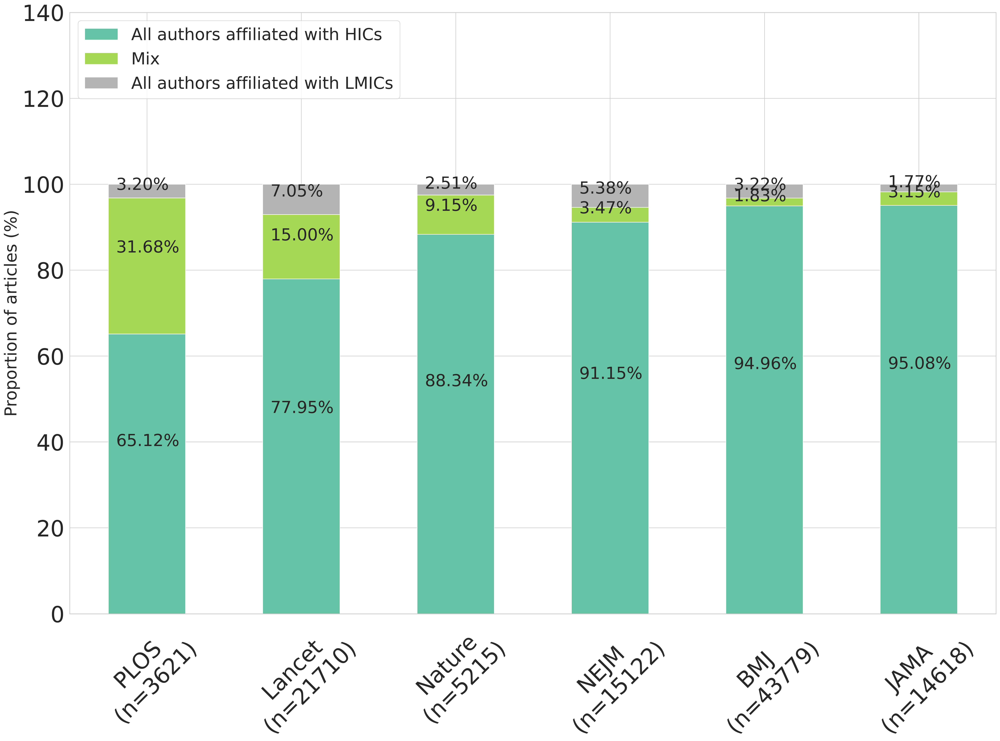

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
sns.set_theme(style='whitegrid')
ax=df_stack.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['PLOS\n(n=3621)','Lancet\n(n=21710)','Nature\n(n=5215)','NEJM\n(n=15122)','BMJ\n(n=43779)','JAMA\n(n=14618)'])
ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
#plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)

for p in ax.patches:
  width=p.get_width()
  height=p.get_height()
  x,y=p.get_xy()
  plt.text(x+0.1*width , y+0.6*height,f'{height:.2f}%',fontsize=30)

In [ ]:
df_stacked_pre=pd.concat([c_fl_m,c_fl_no,c_fl_all],axis=1)
df_stack=df_stacked_pre.drop(columns=['lower','upper','c_real','c_opt'])
df_stack.columns=['Mix','All authors affiliated with HICs','All authors affiliated with LMICs']
df_stack=df_stack.loc[:,['All authors affiliated with HICs','Mix','All authors affiliated with LMICs']].sort_values(by='All authors affiliated with HICs')
df_stack

,All authors affiliated with HICs,Mix,All authors affiliated with LMICs
PLOS,65.254470,31.581843,3.163686
Lancet,78.098550,14.910555,6.990895
Nature,88.955495,8.664850,2.379655
NEJM,91.831502,3.601954,4.566545
BMJ,95.199583,1.784938,3.015480
JAMA,95.289262,3.053135,1.657603


In [ ]:
df1_final.loc[(df1_final['pct_lmic_pes'].notna()) ,'journal.title'].value_counts()

BMJ       45996
Lancet    21857
NEJM      16380
JAMA      15263
Nature     5505
PLOS       3635
Name: journal.title, dtype: int64

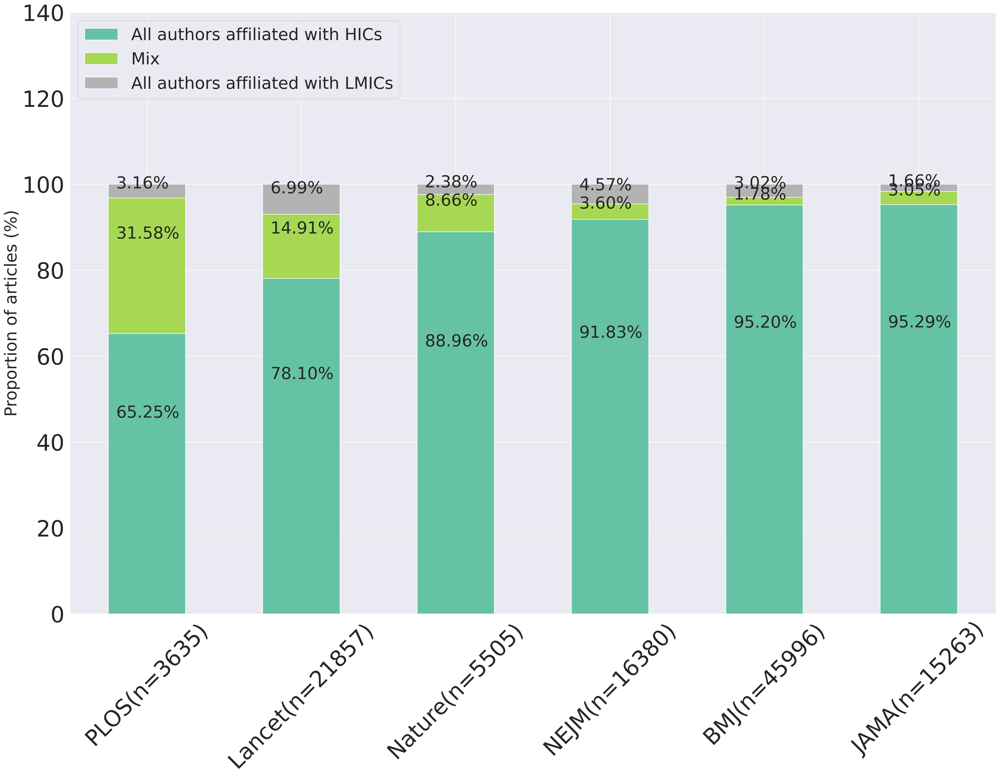

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
ax=df_stack.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['PLOS(n=3635)','Lancet(n=21857)','Nature(n=5505)','NEJM(n=16380)','BMJ(n=45996)','JAMA(n=15263)'])

ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
#plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)

for p in ax.patches:
  width=p.get_width()
  height=p.get_height()
  x,y=p.get_xy()
  plt.text(x+0.1*width , y+0.7*height,f'{height:.2f}%',fontsize=30)

In [ ]:
df_stacked_pre=pd.concat([c_fl_m,c_fl_no,c_fl_all],axis=1)
df_stack=df_stacked_pre.drop(columns=['lower','upper','c_pes','c_real'])
df_stack.columns=['Mix','All authors affiliated with HICs','All authors affiliated with LMICs']
df_stack=df_stack.loc[:,['All authors affiliated with HICs','Mix','All authors affiliated with LMICs']].sort_values(by='All authors affiliated with HICs')
df_stack

,All authors affiliated with HICs,Mix,All authors affiliated with LMICs
PLOS,64.456671,31.966988,3.576341
NEJM,73.937729,13.412698,12.649573
Lancet,77.174361,15.148465,7.677174
JAMA,81.713949,12.363231,5.922820
Nature,83.033606,9.318801,7.647593
BMJ,88.457692,3.659014,7.883294


In [ ]:
df1_final.loc[(df1_final['pct_lmic_opt'].notna()) ,'journal.title'].value_counts()

BMJ       45996
Lancet    21857
NEJM      16380
JAMA      15263
Nature     5505
PLOS       3635
Name: journal.title, dtype: int64

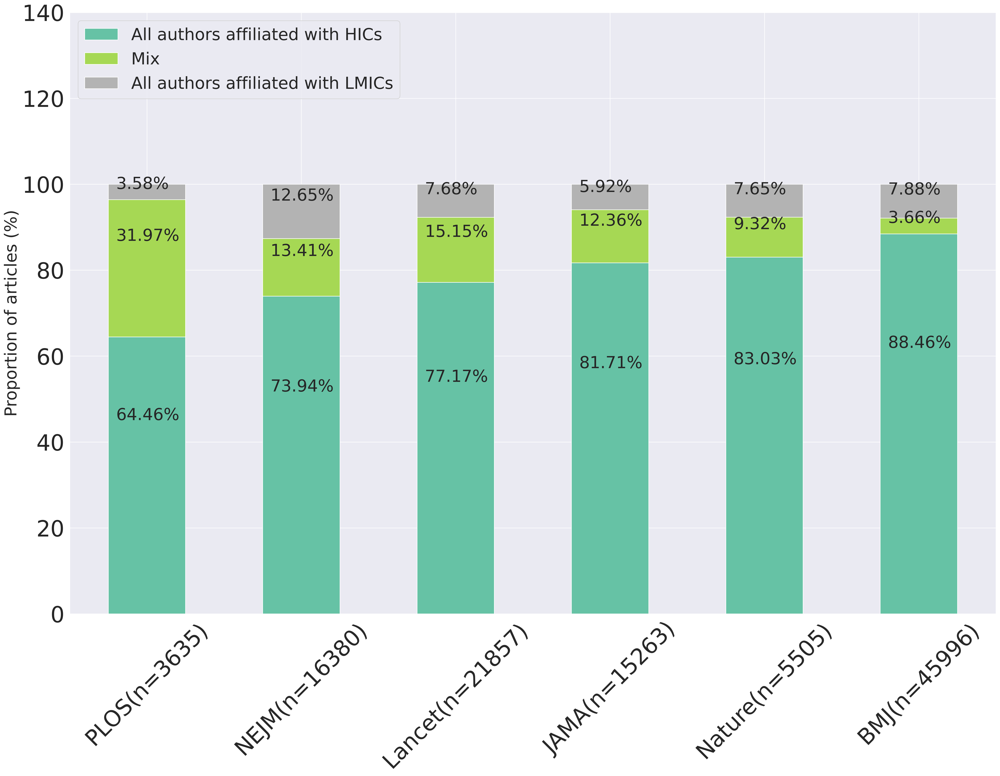

In [ ]:
plt.figure(figsize=(30,20),dpi=300)
sns.set(font_scale=2)
ax=df_stack.plot.bar(stacked=True,ax=plt.gca(),rot=45,cmap='Set2',fontsize=40)

ax.set_xticklabels( ['PLOS(n=3635)','NEJM(n=16380)','Lancet(n=21857)','JAMA(n=15263)','Nature(n=5505)','BMJ(n=45996)'])

ax.set_ylim(0,140)
ax.set_ylabel('Proportion of articles (%)',fontsize=30)
#plt.title("Proportion of articles by authors' affilation and journal",fontsize=30)
plt.legend(loc='upper left',fontsize=30)

for p in ax.patches:
  width=p.get_width()
  height=p.get_height()
  x,y=p.get_xy()
  plt.text(x+0.1*width , y+0.7*height,f'{height:.2f}%',fontsize=30)

#all men by journal

In [ ]:
c_fl=pd.concat([df1_final.loc[(df1_final['pct_female_pessimistic']==0),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_female_real']==0),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_female_optimistic']==0) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
BMJ,30055,28405,27381
Lancet,14729,13976,12293
NEJM,12316,11827,10346
JAMA,10840,10013,9005
Nature,1797,1663,1496
PLOS,883,834,647


In [ ]:
c_fl=c_fl.div(pd.concat([df1_final.loc[(df1_final['pct_female_pessimistic'].notna()),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_female_real'].notna()),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_female_optimistic'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.497212,0.483103,0.452975
JAMA,0.427192,0.407895,0.354877
Lancet,0.500442,0.487325,0.417675
NEJM,0.508926,0.498798,0.427521
Nature,0.271163,0.256122,0.225743
PLOS,0.221915,0.212214,0.162604


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_opt']
c_fl['upper']=c_fl['c_pes']-c_fl['c_real']

c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
PLOS,22.191505,21.221374,16.260367,4.961007,0.970131
Nature,27.116342,25.612198,22.574317,3.037881,1.504144
JAMA,42.719212,40.789474,35.487685,5.301789,1.929738
BMJ,49.721243,48.310288,45.297533,3.012755,1.410955
Lancet,50.044170,48.732522,41.767464,6.965058,1.311648
NEJM,50.892562,49.879803,42.752066,7.127737,1.012759


In [ ]:
c_fl[['lower','upper']].T.values

array([[4.96100712, 3.03788056, 5.30178896, 3.01275456, 6.96505807,
        7.12773651],
       [0.97013136, 1.50414448, 1.92973814, 1.41095546, 1.31164756,
        1.01275936]])

Text(0.5, 1.0, 'All authors from LMIC by journal')

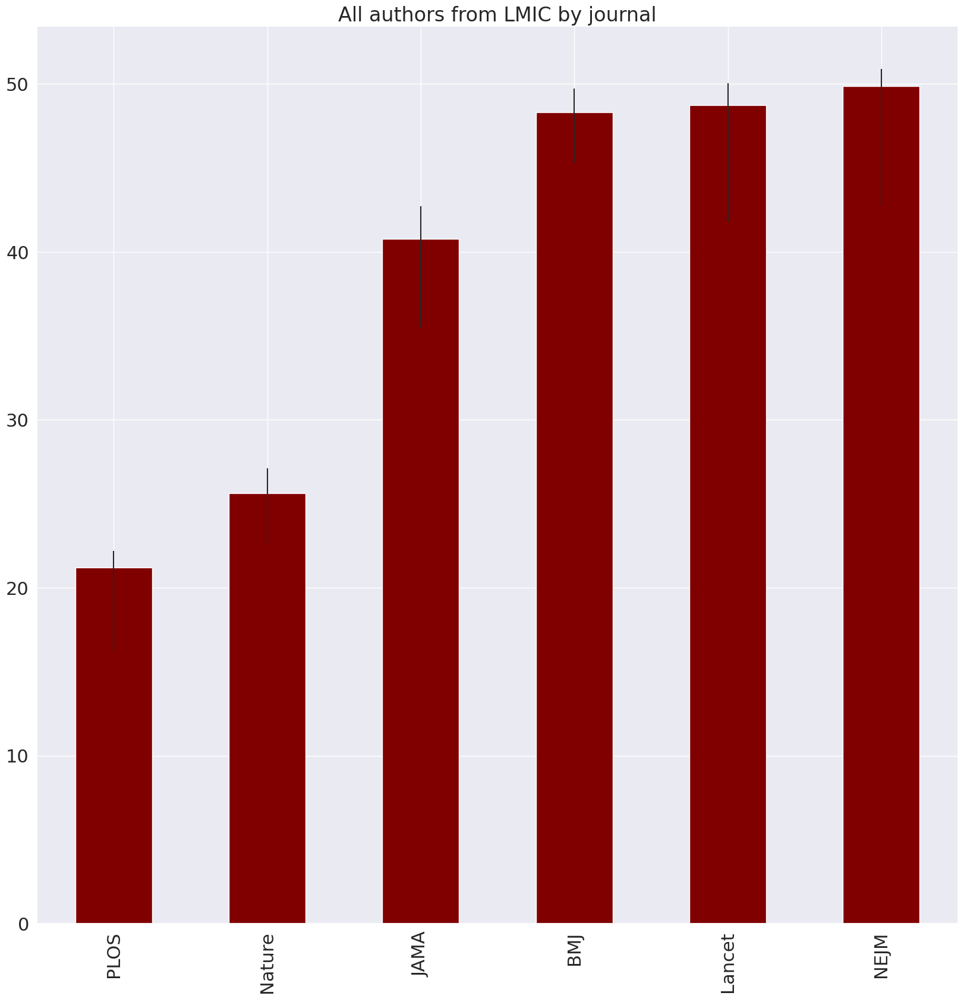

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('All authors from LMIC by journal')

#All women by Journal

In [ ]:
c_fl=pd.concat([df1_final.loc[(df1_final['pct_female_pessimistic']==1),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_female_real']==1),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_female_optimistic']==1) ,'journal.title'].value_counts().rename('c_opt')],axis=1)

c_fl

,c_pes,c_real,c_opt
BMJ,21002,21368,23018
JAMA,6679,6961,7788
Lancet,3194,3641,4394
NEJM,1702,2037,2526
Nature,1426,1463,1597
PLOS,132,180,229


In [ ]:
c_fl=c_fl.div(pd.concat([df1_final.loc[(df1_final['pct_female_pessimistic'].notna()),'journal.title'].value_counts().rename('c_pes'),
           df1_final.loc[(df1_final['pct_female_real'].notna()),'journal.title'].value_counts().rename('c_real'),
           df1_final.loc[(df1_final['pct_female_optimistic'].notna()) ,'journal.title'].value_counts().rename('c_opt')],axis=1),axis=0)
c_fl

,c_pes,c_real,c_opt
BMJ,0.347445,0.363420,0.380796
JAMA,0.263212,0.283567,0.306916
Lancet,0.108521,0.126957,0.149293
NEJM,0.070331,0.085909,0.104380
Nature,0.215180,0.225320,0.240984
PLOS,0.033174,0.045802,0.057552


In [ ]:
c_fl['lower']=c_fl['c_real']-c_fl['c_pes']
c_fl['upper']=c_fl['c_opt']-c_fl['c_real']

c_fl=c_fl.sort_values(by='c_real')*100
c_fl

,c_pes,c_real,c_opt,lower,upper
PLOS,3.317416,4.580153,5.755215,1.262736,1.175062
NEJM,7.033058,8.590949,10.438017,1.557891,1.847067
Lancet,10.852134,12.695701,14.929329,1.843567,2.233628
Nature,21.518032,22.531957,24.098385,1.013925,1.566428
JAMA,26.321182,28.356689,30.691626,2.035507,2.334937
BMJ,34.744487,36.341990,38.079640,1.597503,1.737650


In [ ]:
c_fl[['lower','upper']].T.values

array([[1.26273624, 1.5578915 , 1.84356695, 1.0139252 , 2.03550667,
        1.59750333],
       [1.17506221, 1.84706718, 2.23362793, 1.5664279 , 2.33493668,
        1.73764978]])

Text(0.5, 1.0, 'All authors from LMIC by journal')

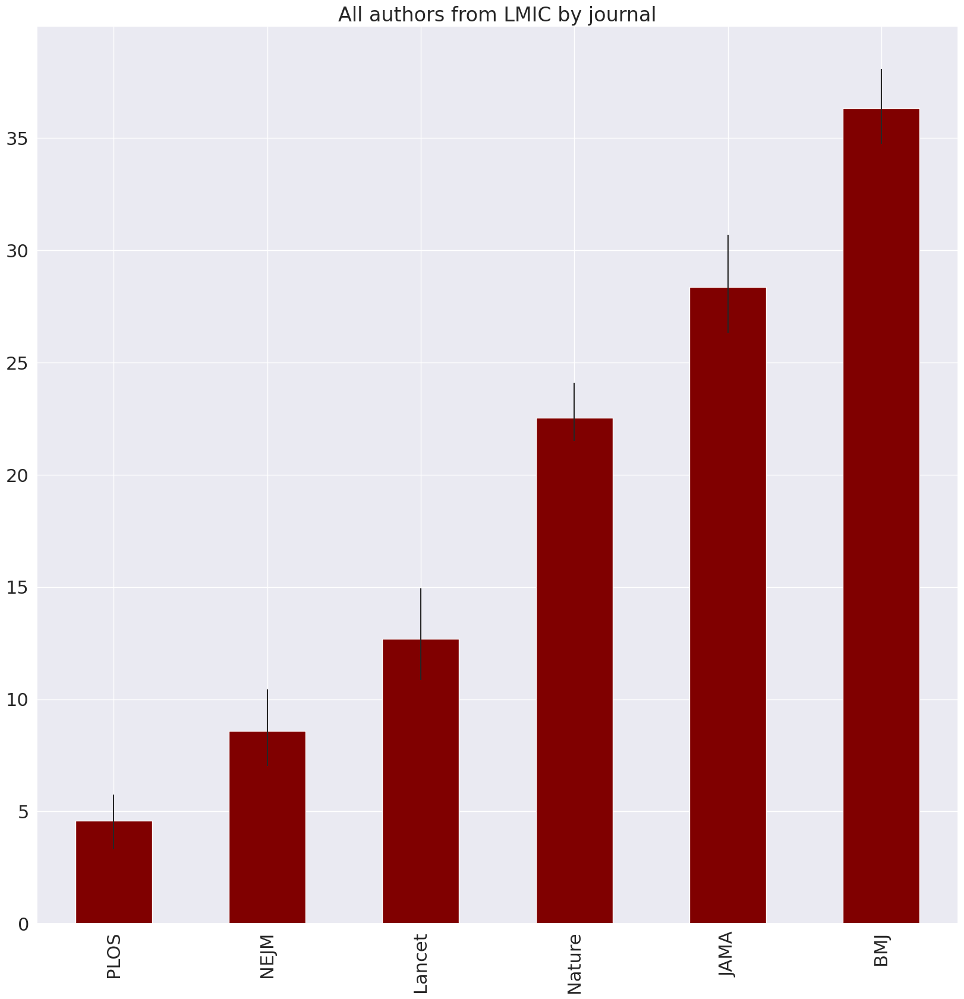

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=100)
sns.set(font_scale=2)
c_fl['c_real'].plot.bar(yerr=c_fl[['lower','upper']].T.values,color='maroon',ax=plt.gca())
plt.title('All authors from LMIC by journal')

# pct_female is significantly different based on first or last author gender
same for pct_lmic

Overall % of female authors as the y-axis

Legends:
First author's gender
Male
Female

Last author's gender
Male
Female

In [ ]:
df1_more5=df1_final.loc[df1_final['authors_count']>=3,:]

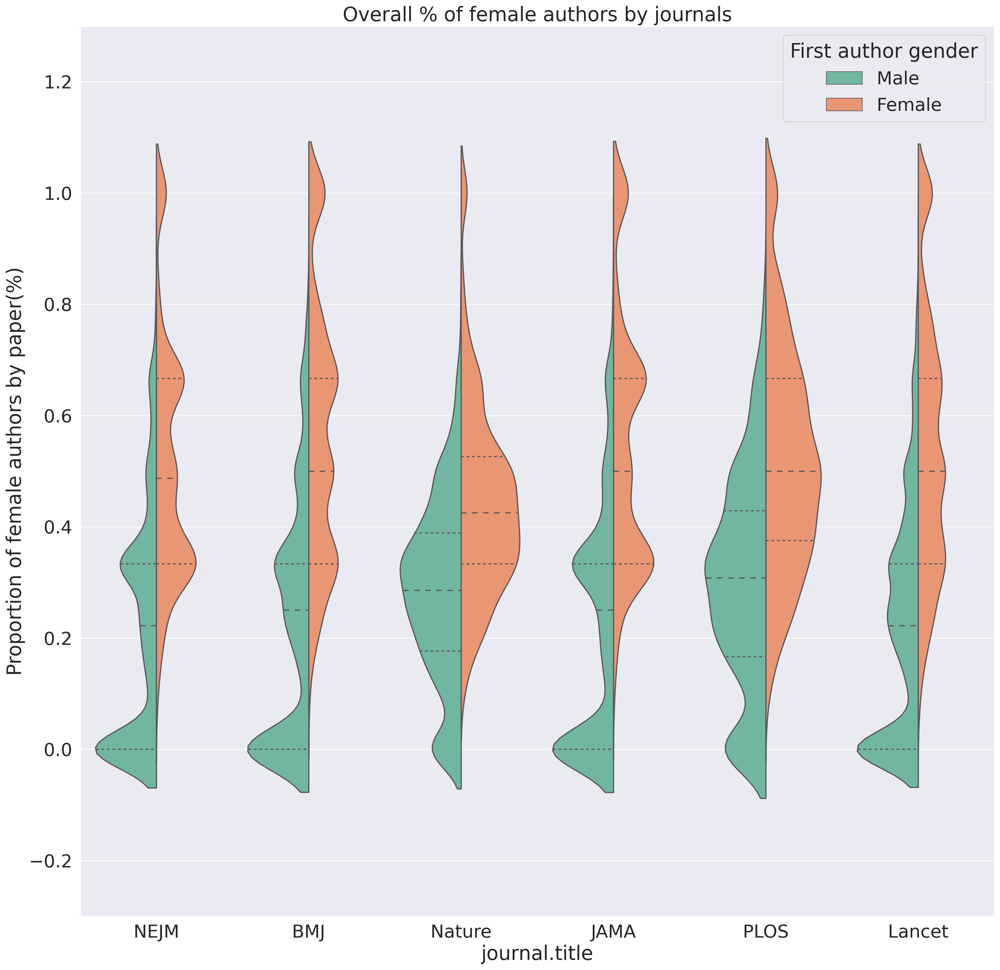

In [ ]:
fig=plt.figure(figsize=(20,20),dpi=200)
sns.set(font_scale=2)

ax=sns.violinplot(data=df1_more5,x='journal.title',y='pct_female_real',hue='female_first_real',split=True,palette='Set2', facet_kws={'legend_out': True},inner='quartile')
ax.set_ylabel('Proportion of female authors by paper(%)')
ax.set_ylim(-0.3,1.3)

plt.title('Overall % of female authors by journals')

# title
new_title = 'First author gender'
ax.legend_.set_title(new_title)

new_labels = ['Male', 'Female']

for t, l in zip(ax.legend_.texts, new_labels):
    t.set_text(l)

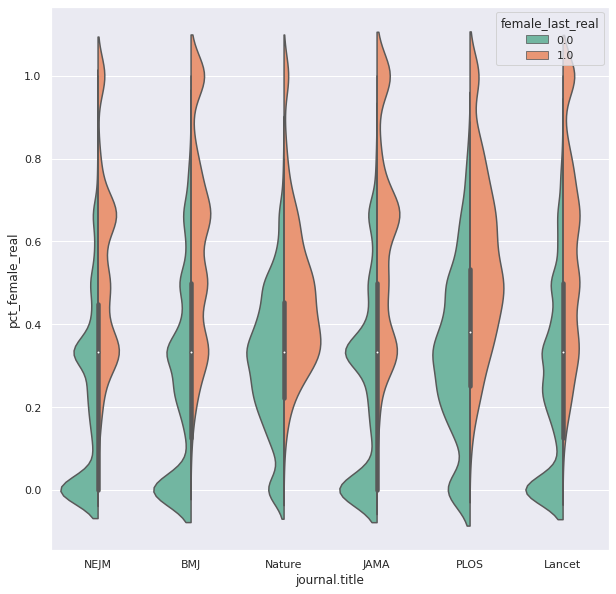

In [ ]:
fig=plt.figure(figsize=(10,10))
sns.set(font_scale=1)
sns.violinplot(data=df1_more5,x='journal.title',y='pct_female_real',hue='female_last_real',split=True,palette='Set2')

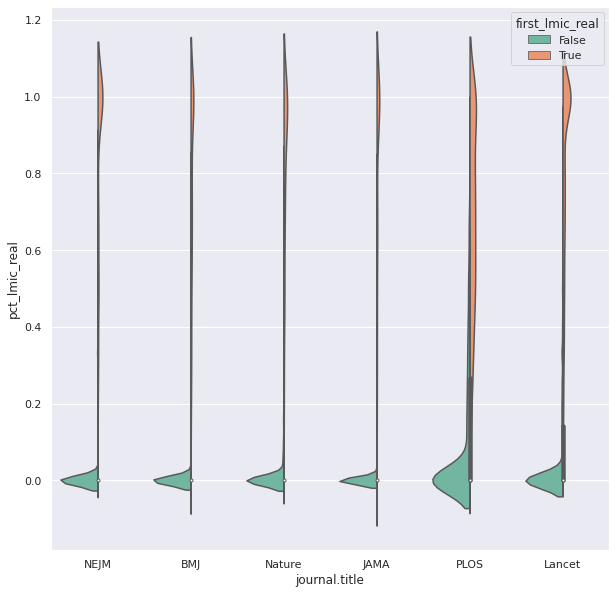

In [ ]:
fig=plt.figure(figsize=(10,10))
sns.set(font_scale=1)
sns.violinplot(data=df1_more5,x='journal.title',y='pct_lmic_real',hue='first_lmic_real',split=True,palette='Set2')

Try with >=5 as well, just to show that the bimodal distribution finding is robust to the minimum number of authors on the paper

Overall % of LMIC authors based in LMICs

First author's affiliated country
LMIC
Not LMIC

Last author's affiliated country
LMIC
Not LMIC

Add pie charts aggregated across all journals

1. Pie chart with the following categories
first author from LMIC and all other authors from LMIC --> cat 1
first author from not LMIC and all other authors not from LMIC --> cat 2
first author from LMIC and at least one other author not from LMIC --> cat 3
first author not from LMIC and at least one other author from not LMIC --> cat 4

2. Last author --> same principle

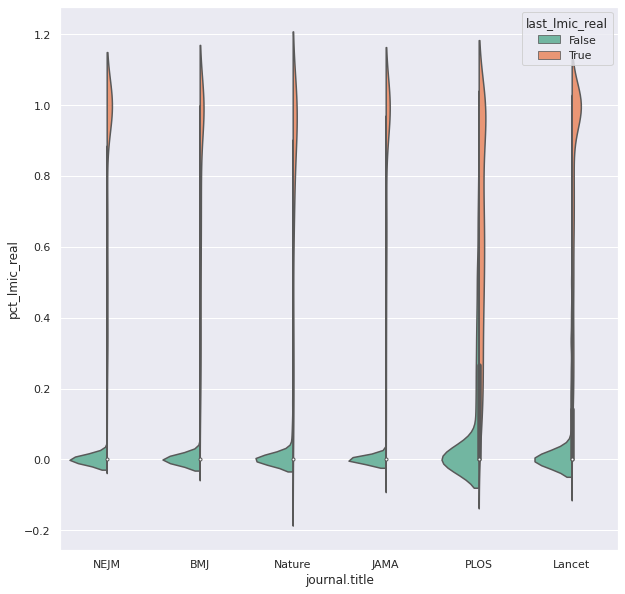

In [ ]:
fig=plt.figure(figsize=(10,10))
sns.set(font_scale=1)
sns.violinplot(data=df1_more5,x='journal.title',y='pct_lmic_real',hue='last_lmic_real',split=True,palette='Set2')

In [ ]:
df1_more2['open_access']=df1_more2['open_access'].apply(lambda x : ast.literal_eval(x)[0])

<ipython-input-342-b0ae98897d13>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1_more2['open_access']=df1_more2['open_access'].apply(lambda x : ast.literal_eval(x)[0])


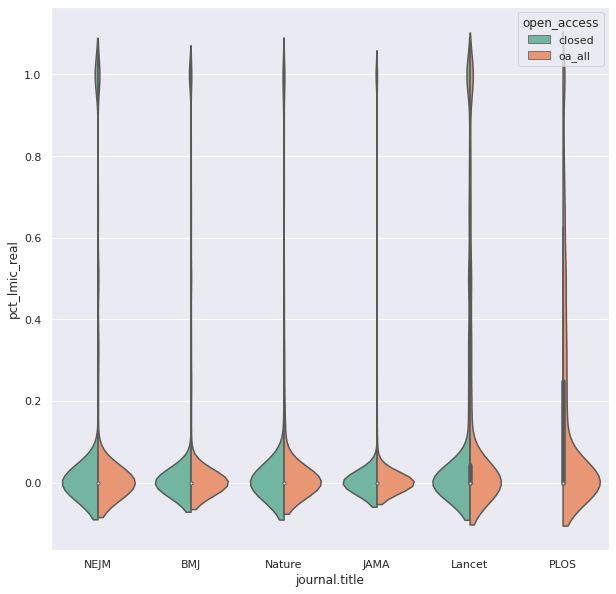

In [ ]:
fig=plt.figure(figsize=(10,10))
sns.set(font_scale=1)
sns.violinplot(data=df1_more2,x='journal.title',y='pct_lmic_real',hue='open_access',split=True,palette='Set2')

#authors count boxplot

In [ ]:
df1_final.loc[df1_final['authors_count'].notna(),'journal.title'].value_counts()

BMJ       60447
Lancet    29432
JAMA      25375
NEJM      24200
Nature     6627
PLOS       3979
Name: journal.title, dtype: int64

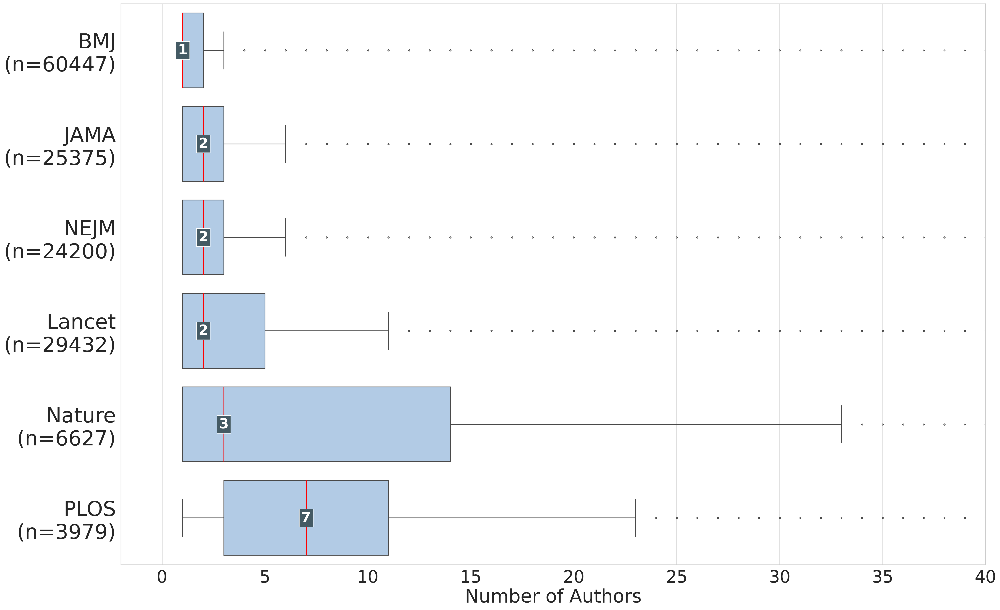

In [ ]:
fig=plt.figure(figsize=(30,20),dpi=200)



sns.set(font_scale=3)



flierprops = dict(markerfacecolor='0.75', markersize=5,
              marker='.')
sns.set_style('whitegrid')

ax=sns.boxplot(
    data=df1_final, x="authors_count", y="journal.title",order=['BMJ','JAMA','NEJM','Lancet','Nature','PLOS'],
   showcaps=True,showfliers=True,
   flierprops=flierprops,
    boxprops={"facecolor": (.4, .6, .8, .5)},
    medianprops={"color": "red"},ax=plt.gca()
)

ax.set_yticklabels(['BMJ\n(n=60447)','JAMA\n(n=25375)','NEJM\n(n=24200)','Lancet\n(n=29432)','Nature\n(n=6627)','PLOS\n(n=3979)'],fontsize=40)

ax.set_ylabel('')
ax.set_xlabel('Number of Authors')
ax.set_xlim(-2,40)

lines=ax.get_lines()

categ=ax.get_yticks()

for cat in categ:
  x=lines[4+cat*6].get_xdata()[0]
  ax.text(x,cat,f'{int(x)}',ha='center',va='center',fontweight='bold', size=27,color='#ffffff',bbox=dict(facecolor='#445A64'))

